Example notebook training a flow on samples from a known distribution, then using MCMC to generate new samples

In [1]:
import os
import sys
import argparse
import logging
import torch
from torch.distributions import MultivariateNormal, Uniform, TransformedDistribution, SigmoidTransform
from getdist import plots, MCSamples
import getdist
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import collections as mc
from scipy.stats import multivariate_normal

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [3]:
path = os.path.realpath(os.path.join(os.getcwd(), '../..'))
sys.path.insert(0, path)

In [4]:
from nnest import NestedSampler, MCMCSampler
from nnest.trainer import Trainer
from nnest.likelihoods import *
from nnest.priors import *
from nnest.distributions import GeneralisedNormal

In [5]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [6]:
def plot_flow(samples, model):
    x_synth = model.netG.sample(samples.size).detach().cpu().numpy()
    z = model.get_latent_samples(samples)
    grid = []
    for x in np.linspace(np.min(samples[:, 0]) - 1, np.max(samples[:, 0]) + 1, 10):
        for y in np.linspace(np.min(samples[:, 1]) - 1, np.max(samples[:, 1]) + 1, 5000):
            grid.append([x, y])
    for y in np.linspace(np.min(samples[:, 1]) - 1, np.max(samples[:, 1]) + 1, 10):
        for x in np.linspace(np.min(samples[:, 0]) - 1, np.max(samples[:, 0]) + 1, 5000):
            grid.append([x, y])
    grid = np.array(grid)
    z_grid = model.get_latent_samples(grid)
    fig, ax = plt.subplots(1, 3, figsize=(12, 5))
    ax[0].scatter(grid[:, 0], grid[:, 1], c=grid[:, 0], marker='.', s=1, linewidths=0)
    ax[0].scatter(samples[:, 0], samples[:, 1], s=4)
    ax[0].set_title('Real data')
    ax[1].scatter(z_grid[:, 0], z_grid[:, 1], c=grid[:, 0], marker='.', s=1, linewidths=0)
    ax[1].scatter(z[:, 0], z[:, 1], s=4)
    ax[1].set_title('Latent data')
    ax[2].scatter(x_synth[:, 0], x_synth[:, 1], s=2)
    ax[2].set_title('Synthetic data')
    plt.tight_layout()
    plt.show()
    # Plot grid warp
    plt.figure(figsize=(6,6))
    ng = 30
    xx, yy = np.linspace(-4,4, ng), np.linspace(-4,4, ng)
    xv, yv = np.meshgrid(xx, yy)
    xy = np.stack([xv, yv], axis=-1)
    in_circle = np.sqrt((xy**2).sum(axis=2)) <= 3
    xy = xy.reshape((ng*ng, 2))
    xy = torch.from_numpy(xy.astype(np.float32))
    xs = model.get_samples(xy)
    xs = xs.reshape((ng, ng, 2))
    p1 = np.reshape(xs[1:,:,:], (ng**2-ng,2))
    p2 = np.reshape(xs[:-1,:,:], (ng**2-ng,2))
    inc = np.reshape(in_circle[1:,:] | in_circle[:-1,:], (ng**2-ng,))
    p1, p2 = p1[inc], p2[inc]
    lcy = mc.LineCollection(zip(p1, p2), linewidths=1, alpha=0.5, color='k')
    p1 = np.reshape(xs[:,1:,:], (ng**2-ng,2))
    p2 = np.reshape(xs[:,:-1,:], (ng**2-ng,2))
    inc = np.reshape(in_circle[:,1:] | in_circle[:,:-1], (ng**2-ng,))
    p1, p2 = p1[inc], p2[inc]
    lcx = mc.LineCollection(zip(p1, p2), linewidths=1, alpha=0.5, color='k')
    plt.gca().add_collection(lcy)
    plt.gca().add_collection(lcx)
    plt.xlim([np.min(samples[:,0])-0.05,np.max(samples[:,0])+0.05])
    plt.ylim([np.min(samples[:,1])-0.05,np.max(samples[:,1])+0.05])
    plt.scatter(samples[:,0], samples[:,1], c='r', s=5, alpha=0.5)
    plt.show()

In [7]:
def test_mcmc(like, prior, model, num_chains=1, init_chain=True, nested_samples=True, mcmc_steps=1000, nested_fraction=0.01):
    np.random.seed(0)
    if nested_samples:
        init_samples, loglstar = like.uniform_sample(prior, 1000, nested_fraction)
    else:
        init_samples = like.sample(prior, 1000)
        loglstar = None
    model.train(init_samples, jitter=0.001, max_iters=2000)
    plot_flow(init_samples, model)
    sampler = MCMCSampler(like.x_dim, like, prior=prior, trainer=model, log_level=logging.INFO)
    if init_chain:
        results = sampler._mcmc_sample(mcmc_steps, init_samples=init_samples[0:num_chains, :], 
                                       loglstar=loglstar, num_chains=num_chains)
    else:
        results = sampler._mcmc_sample(mcmc_steps, loglstar=loglstar, num_chains=num_chains)
    samples, latent_samples, derived_samples, loglikes, scale, ncall = results
    fig, ax = plt.subplots(1, 2, figsize=(12,6))
    flat_samples = samples.reshape((-1, like.x_dim))
    flat_latent_samples = latent_samples.reshape((-1, like.x_dim))
    ax[0].scatter(flat_samples[:,0], flat_samples[:,1], c='r', s=5, alpha=0.5)
    ax[1].scatter(flat_latent_samples[:,0], flat_latent_samples[:,1], c='r', s=5, alpha=0.5)
    plt.show()
    fig, ax = plt.subplots(like.x_dim, 2, figsize=(10, like.x_dim))
    for i in range(like.x_dim):
        ax[i, 0].plot(samples[0,0:1000,i])
        ax[i, 1].plot(latent_samples[0,0:1000,i])
    plt.show()
    mc = MCSamples(samples=[samples[i, :, :].squeeze() for i in range(samples.shape[0])], 
                   loglikes=[-loglikes[i, :].squeeze() for i in range(loglikes.shape[0])])
    try:
        print(mc.getEffectiveSamples())
    except:
        pass
    try:
        print(mc.getConvergeTests())
    except: 
        pass
    print(ncall, scale)

In [8]:
num_chains = 5

In [9]:
like = Gaussian(2, 0.9)
prior = UniformPrior(2, -5, 5)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0286] validation loss [0.0270]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0233] validation loss [0.0222]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0211] validation loss [0.0202]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0203] validation loss [0.0195]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [596] ran out of patience
[nnest.trainer] [INFO] Best epoch [546] validation loss [0.0193]


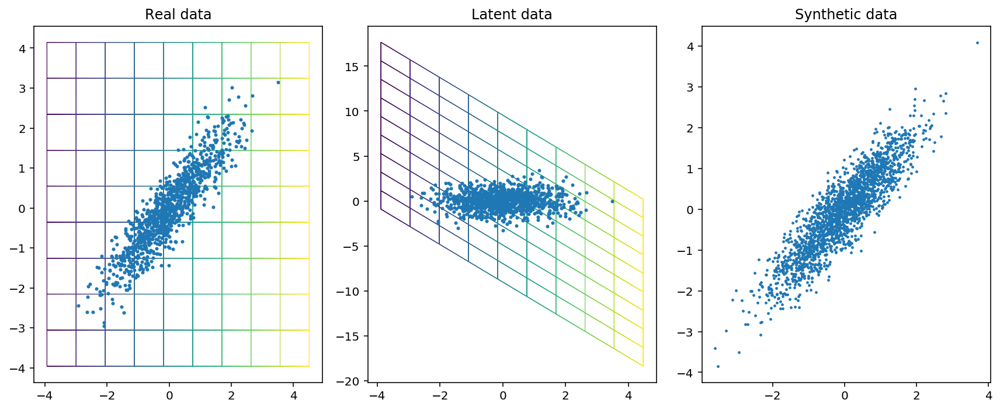

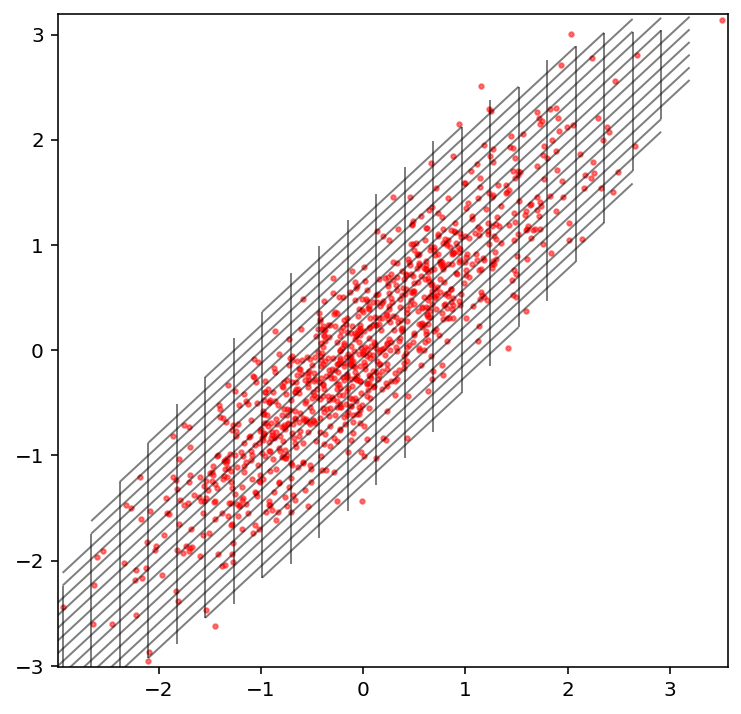

Creating directory for new run logs/test/run348
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


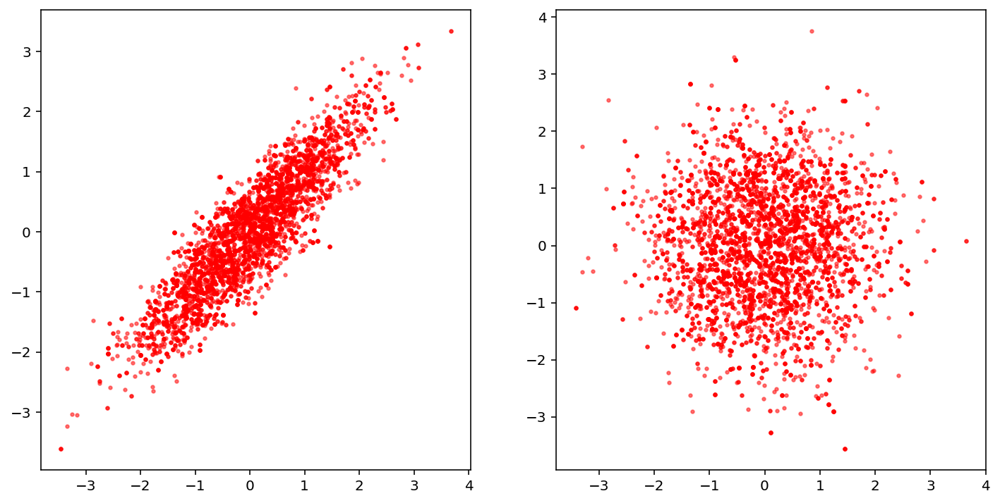

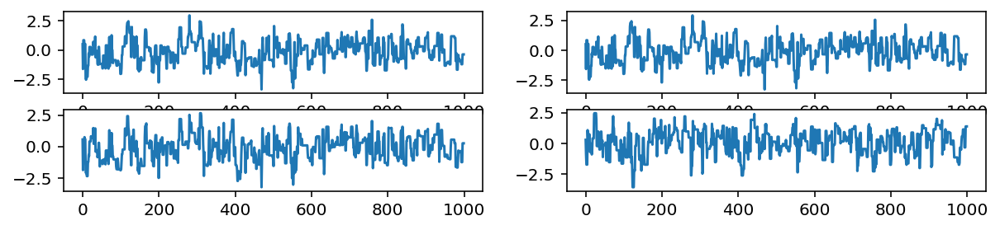

Removed no burn in
728.2697759917825
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.74E+00            6.74             742
param2           6.72E+00            6.72             744


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0947  p_{1}
param2        0.0872  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00400
  2      0.00902

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1693   0.1043   0.1847 upper
param1       0.0159   0.1043   0.0883 lower
param2       0.1447   0.0920   0.2010 upper
param2       0.0407   0.0317   0.0999 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

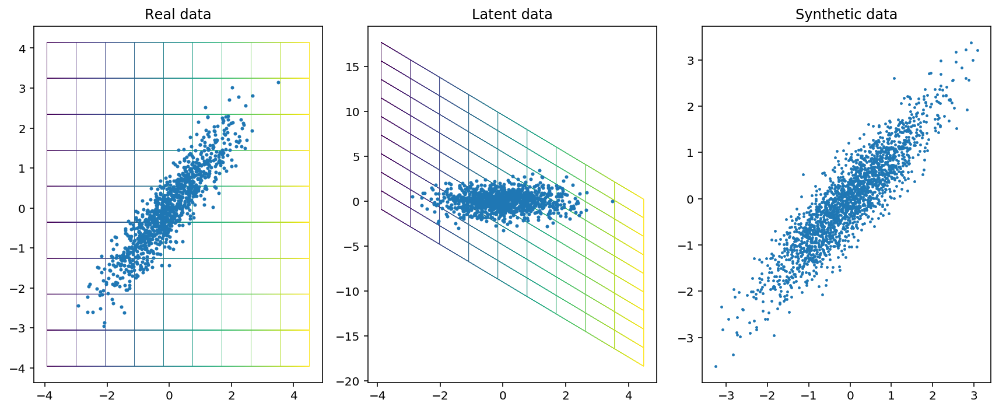

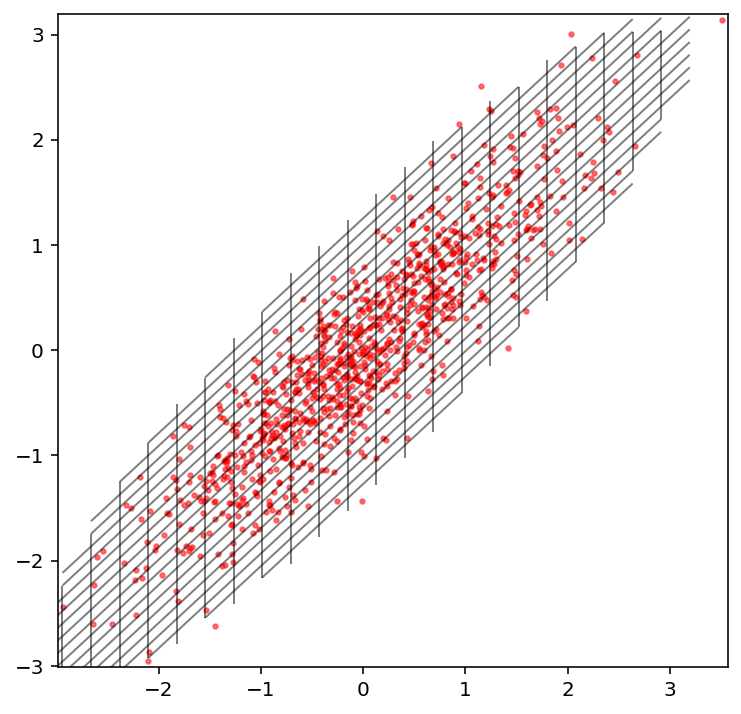

Creating directory for new run logs/test/run349
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


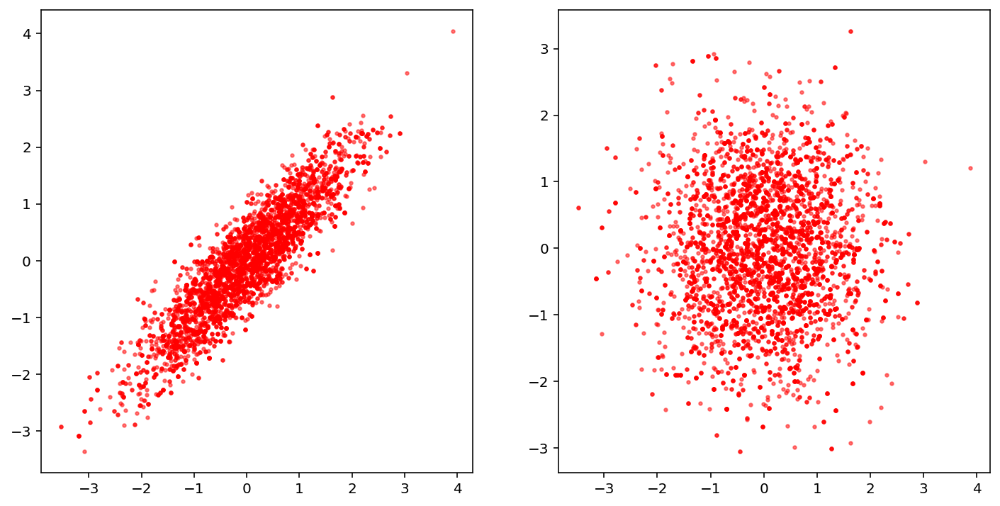

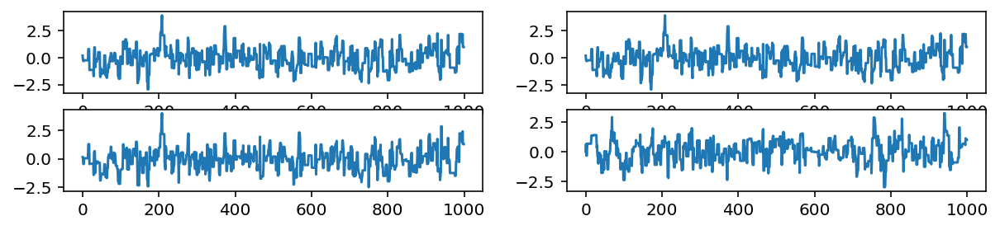

Removed no burn in
710.8025220483976
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.87E+00            6.87             728
param2           6.75E+00            6.75             741


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0835  p_{1}
param2        0.0854  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00433
  2      0.00732

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0598   0.1319   0.1722 upper
param1       0.0315   0.0904   0.2444 lower
param2       0.0350   0.2199   0.1568 upper
param2       0.0489   0.0232   0.0789 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

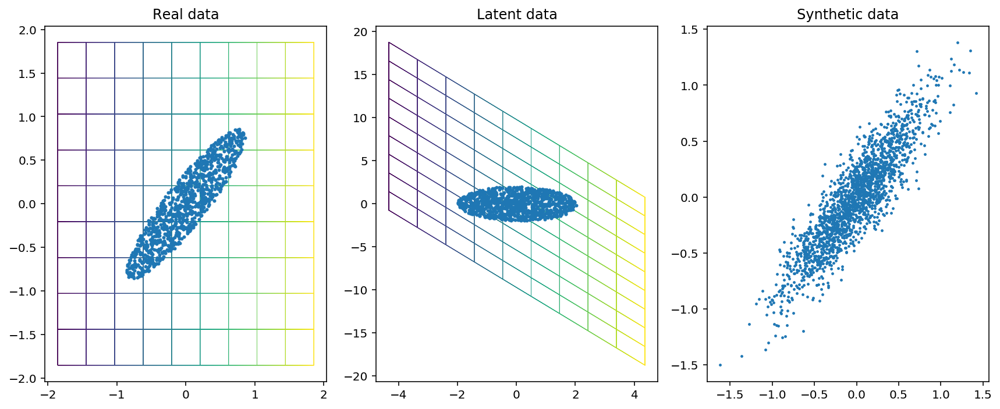

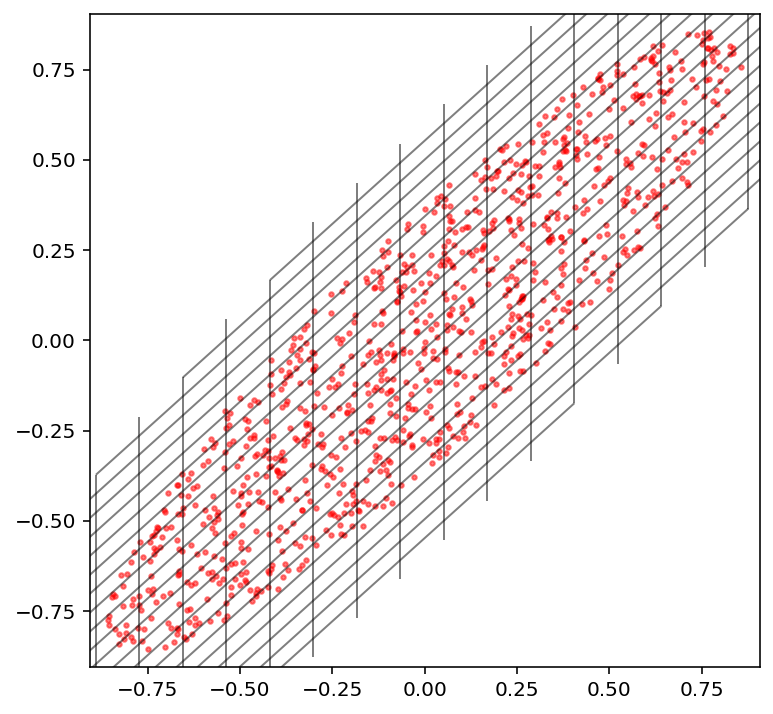

Creating directory for new run logs/test/run351
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


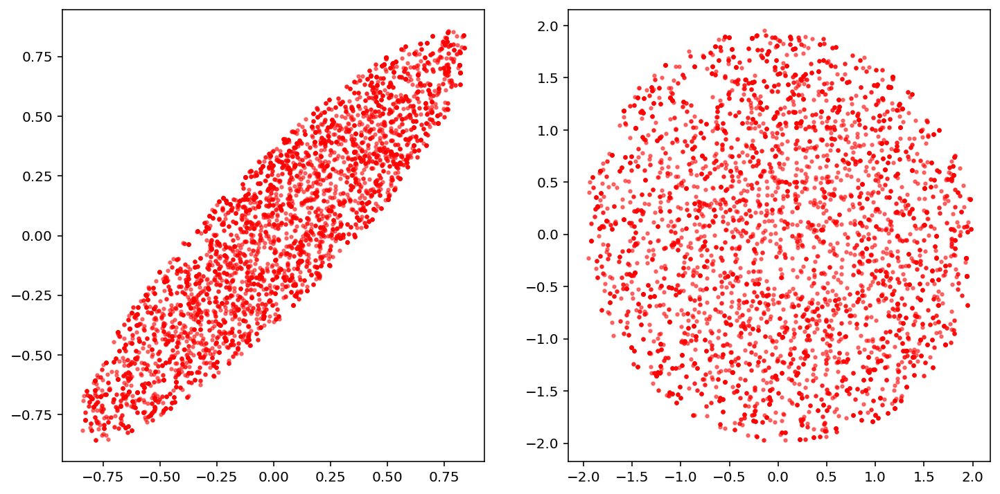

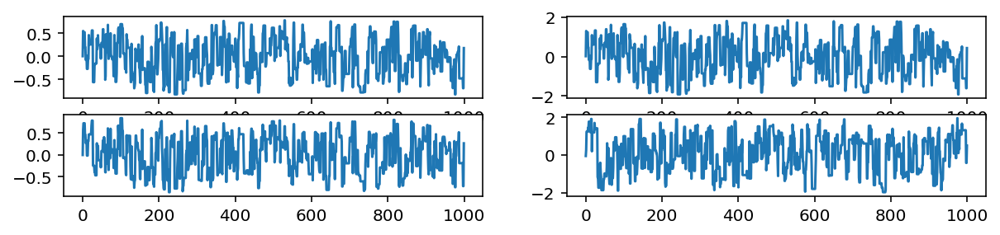

Removed no burn in
767.3243889359437
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.50E+00            6.50             770
param2           5.97E+00            5.97             838


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0491  p_{1}
param2        0.0417  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00168
  2      0.00720

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0476   0.0565   0.0805 upper
param1       0.0795   0.0647   0.0814 lower
param2       0.0293   0.0625   0.0714 upper
param2       0.0004   0.0087   0.0445 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

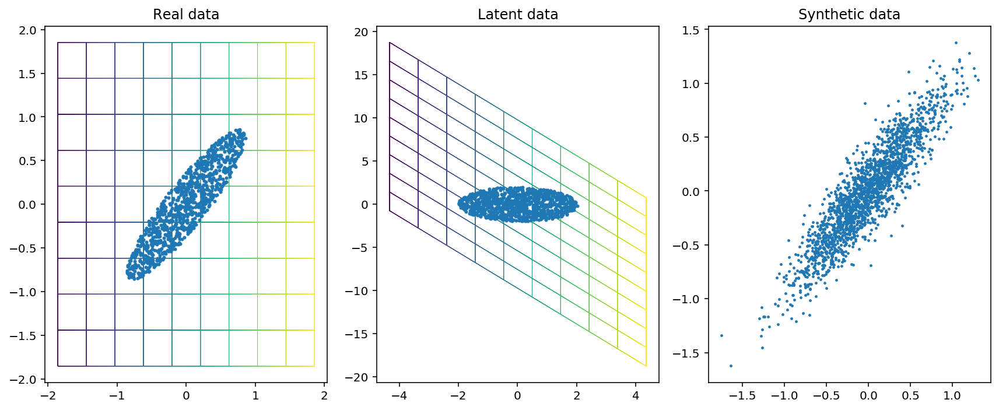

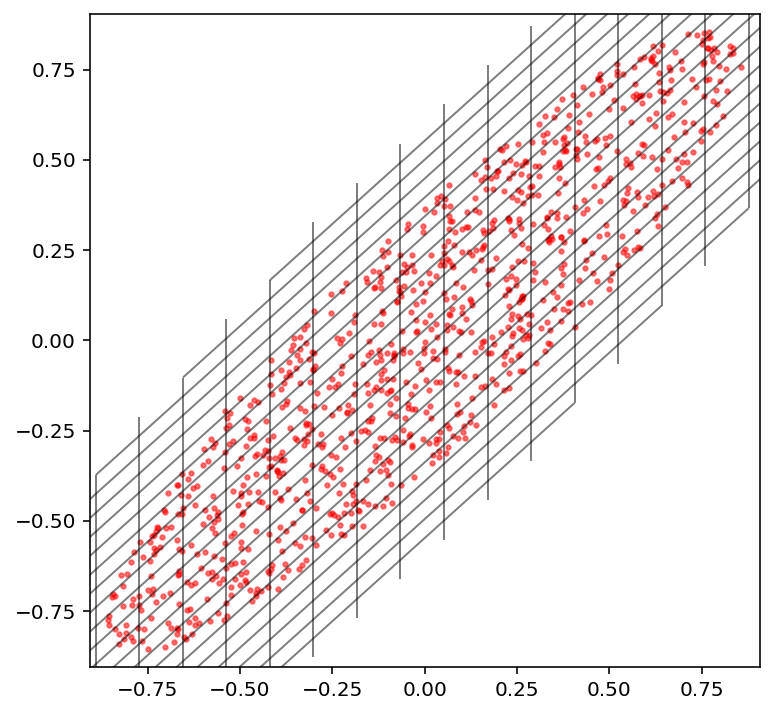

Creating directory for new run logs/test/run352
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


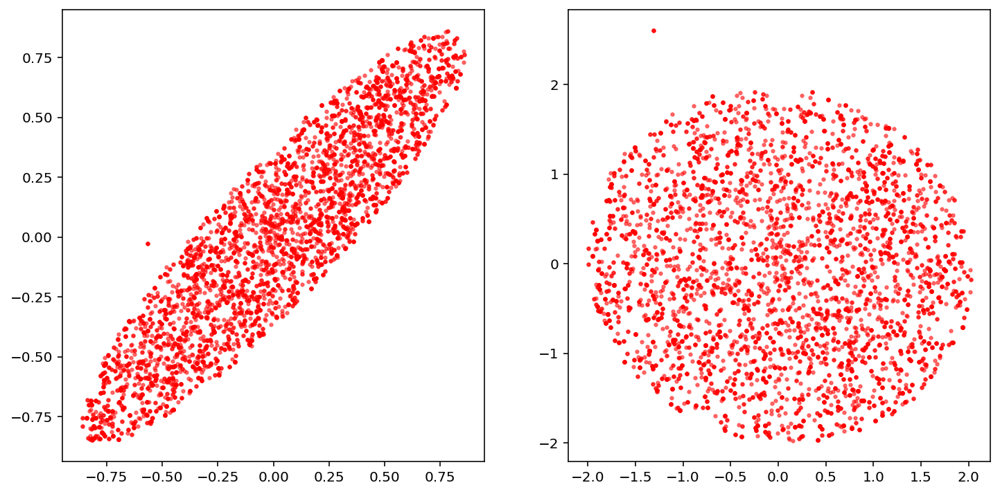

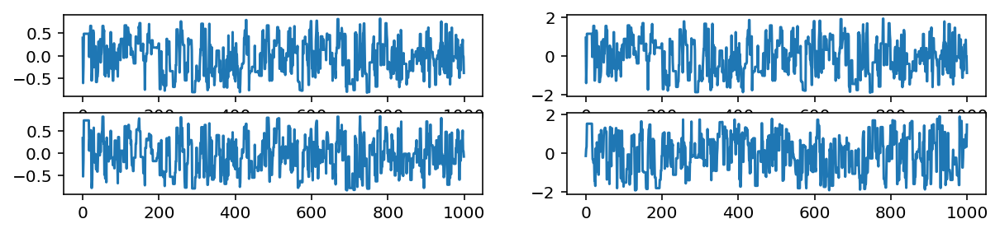

Removed no burn in
853.5473694645185
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.82E+00            5.82             859
param2           5.44E+00            5.44             919


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0635  p_{1}
param2        0.0783  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00374
  2      0.01031

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0098   0.0259   0.0570 upper
param1       0.0102   0.0817   0.0441 lower
param2       0.0267   0.0442   0.0200 upper
param2       0.0212   0.0674   0.0506 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [10]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

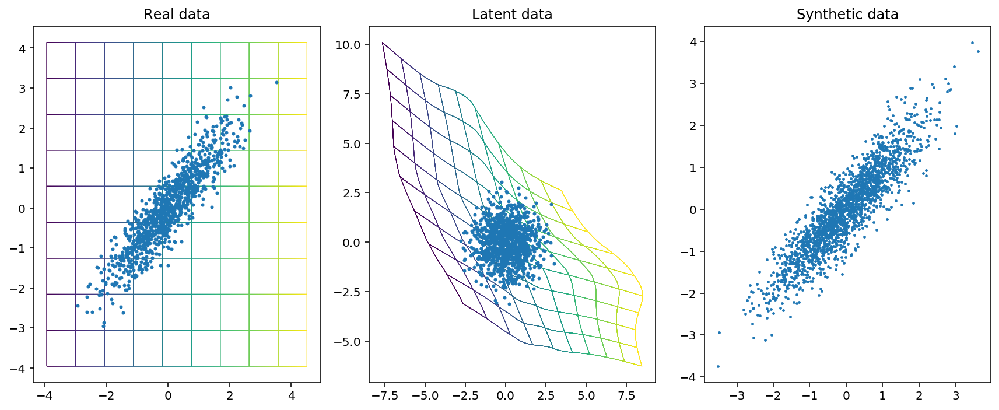

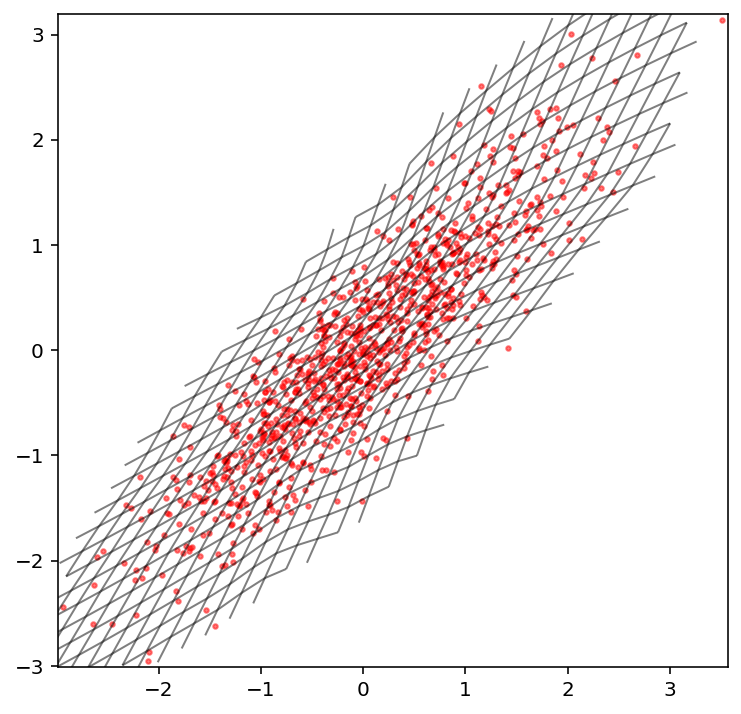

Creating directory for new run logs/test/run354
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


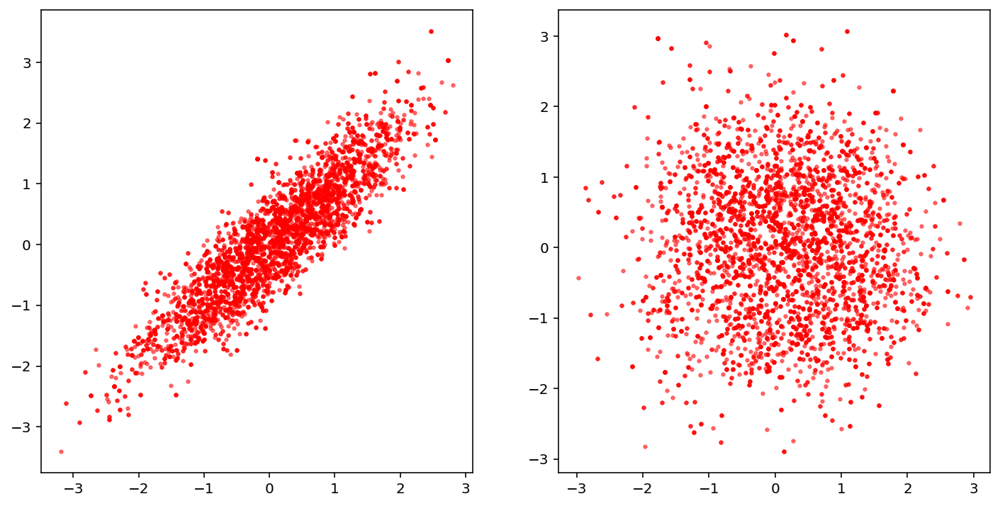

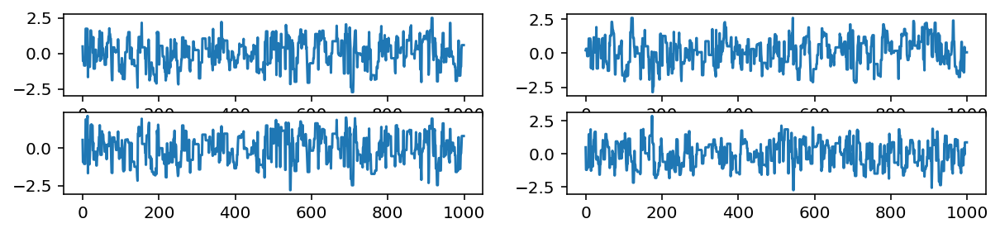

Removed no burn in
749.0936102885973
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.44E+00            6.44             777
param2           6.38E+00            6.38             783


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0989  p_{1}
param2        0.1030  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00977
  2      0.01355

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1487   0.1107   0.1615 upper
param1       0.0067   0.1277   0.1861 lower
param2       0.1564   0.1242   0.1978 upper
param2       0.0551   0.0453   0.1298 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

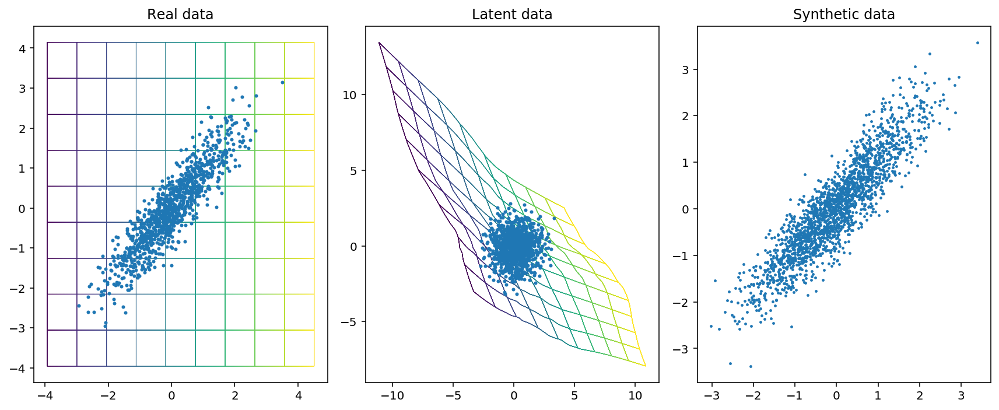

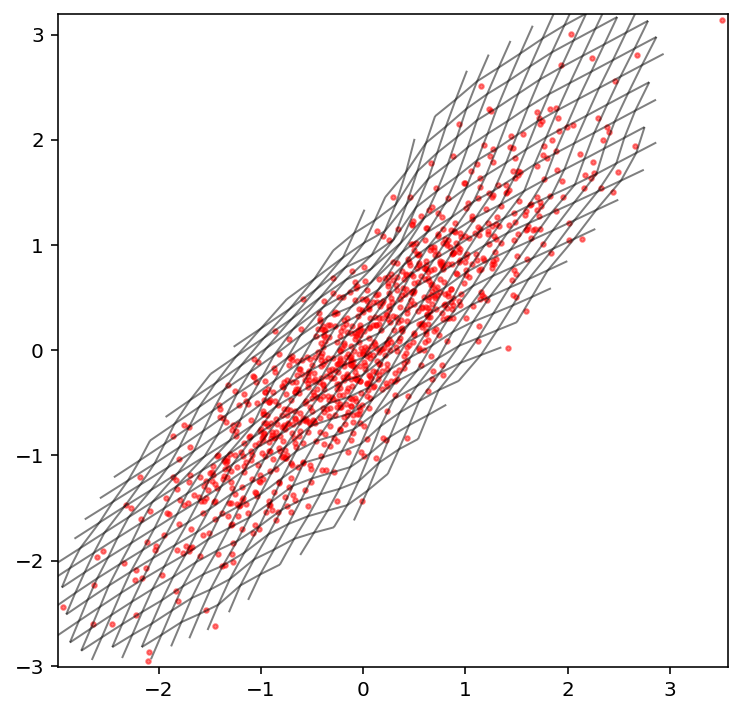

Creating directory for new run logs/test/run355
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


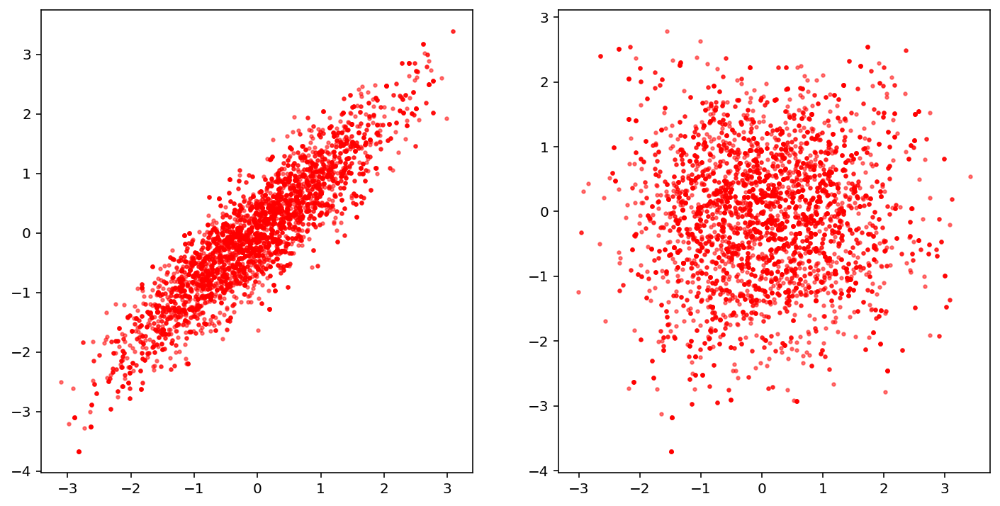

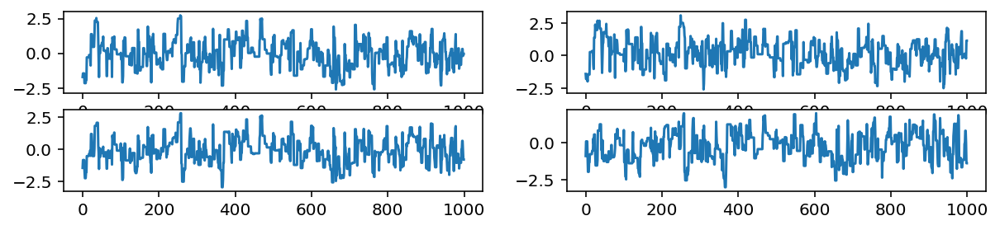

Removed no burn in
464.8979347065896
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.01E+01           10.13             494
param2           9.95E+00            9.95             502


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1191  p_{1}
param2        0.1229  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01417
  2      0.01815

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.2945   0.2049   0.2883 upper
param1       0.1377   0.0976   0.1752 lower
param2       0.2327   0.1474   0.2665 upper
param2       0.1617   0.0748   0.1842 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

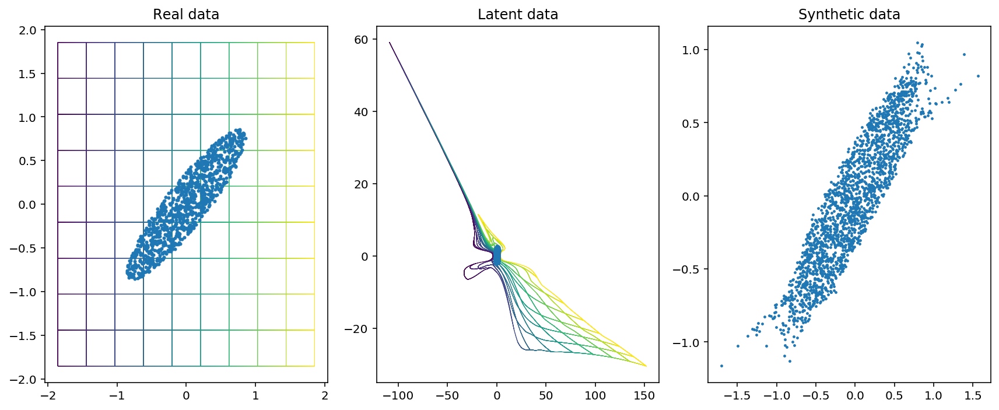

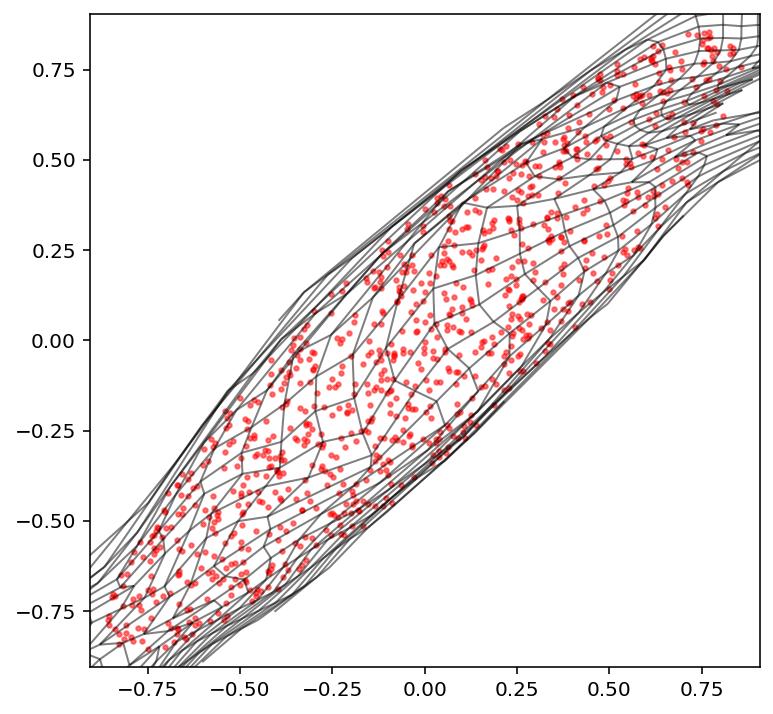

Creating directory for new run logs/test/run356
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


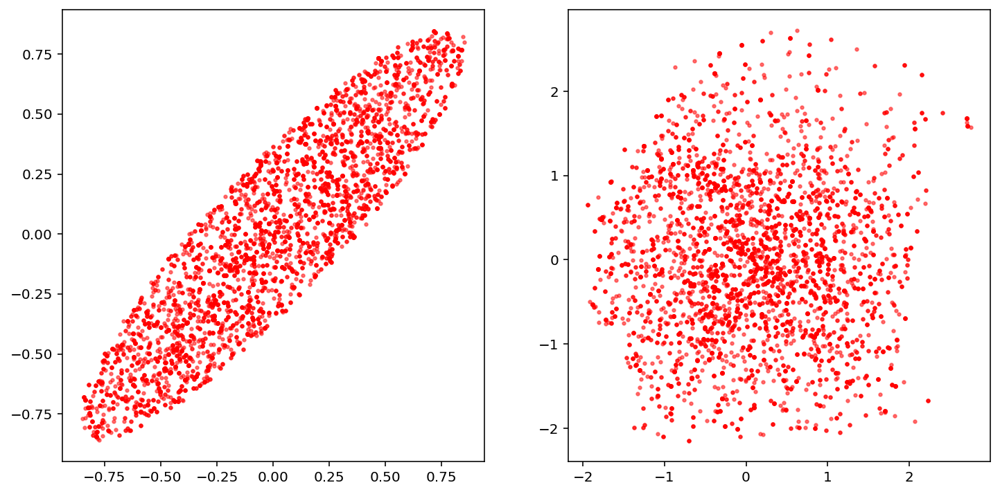

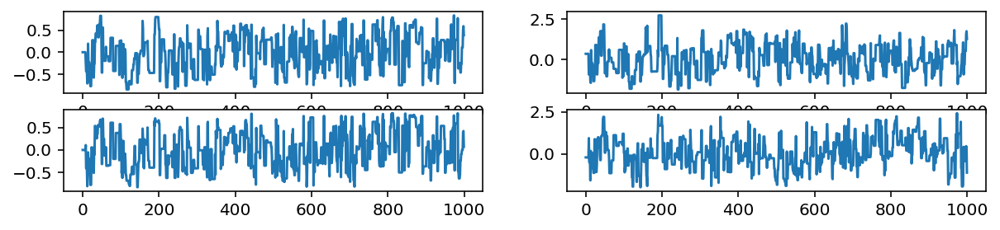

Removed no burn in
672.1707795811346
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.38E+00            7.38             677
param2           7.53E+00            7.53             664


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0610  p_{1}
param2        0.0813  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00125
  2      0.00785

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0661   0.0589   0.0770 upper
param1       0.0151   0.0801   0.0406 lower
param2       0.0031   0.0353   0.0337 upper
param2       0.0403   0.0440   0.0703 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

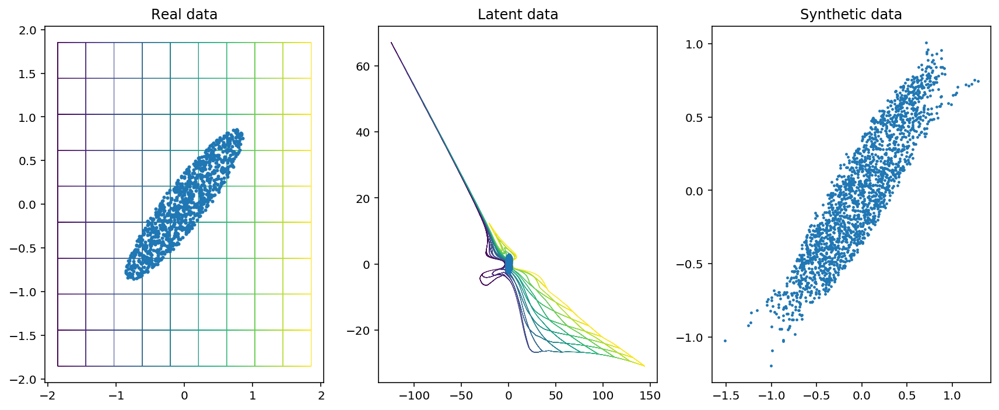

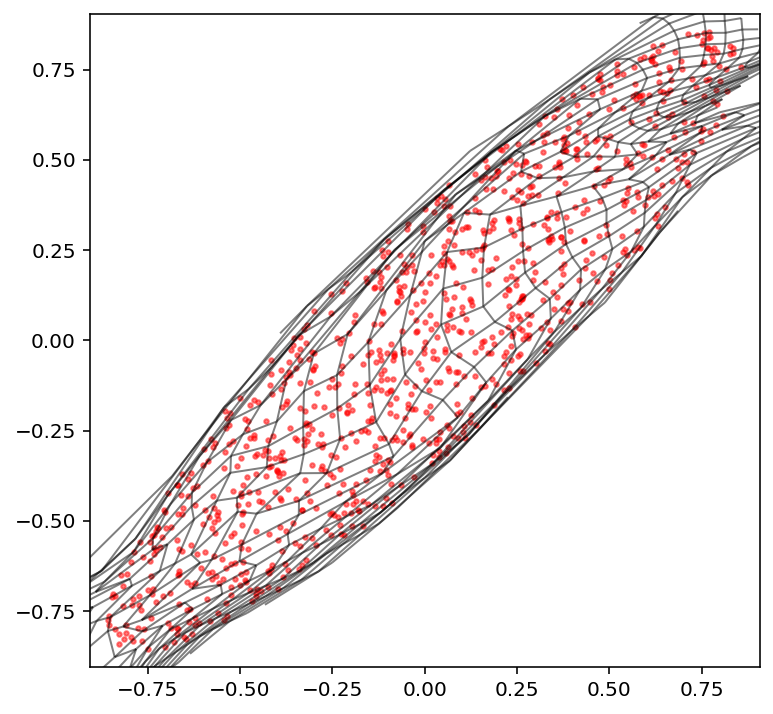

Creating directory for new run logs/test/run357
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


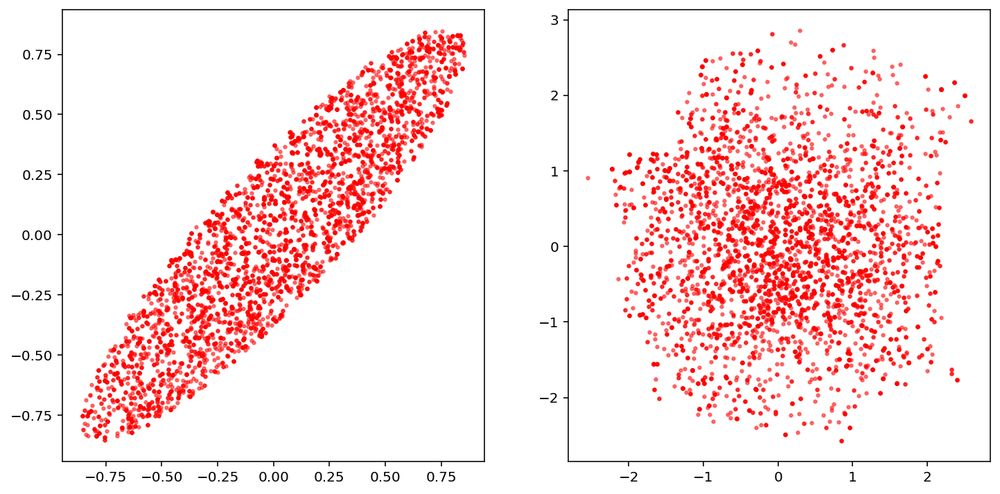

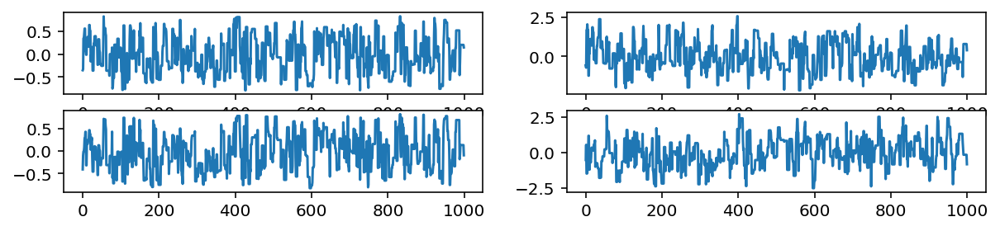

Removed no burn in
771.4496618001228
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.34E+00            6.34             789
param2           6.75E+00            6.75             740


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0936  p_{1}
param2        0.0657  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00323
  2      0.01434

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0094   0.0217   0.0631 upper
param1       0.0383   0.0579   0.1029 lower
param2       0.0234   0.0501   0.0371 upper
param2       0.0293   0.0541   0.0566 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [11]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

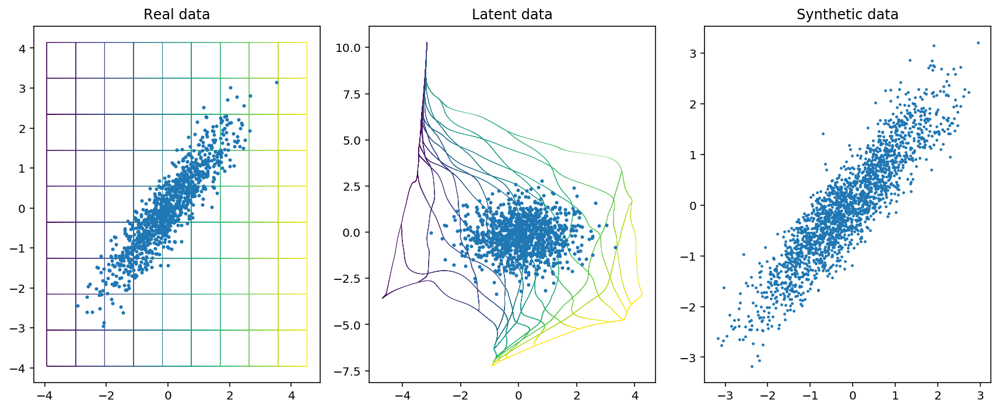

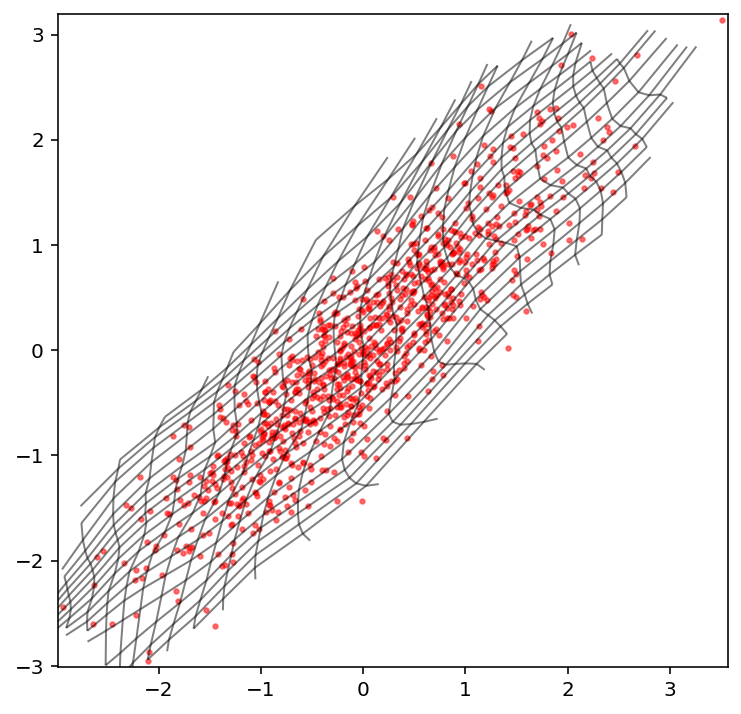

Creating directory for new run logs/test/run359
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


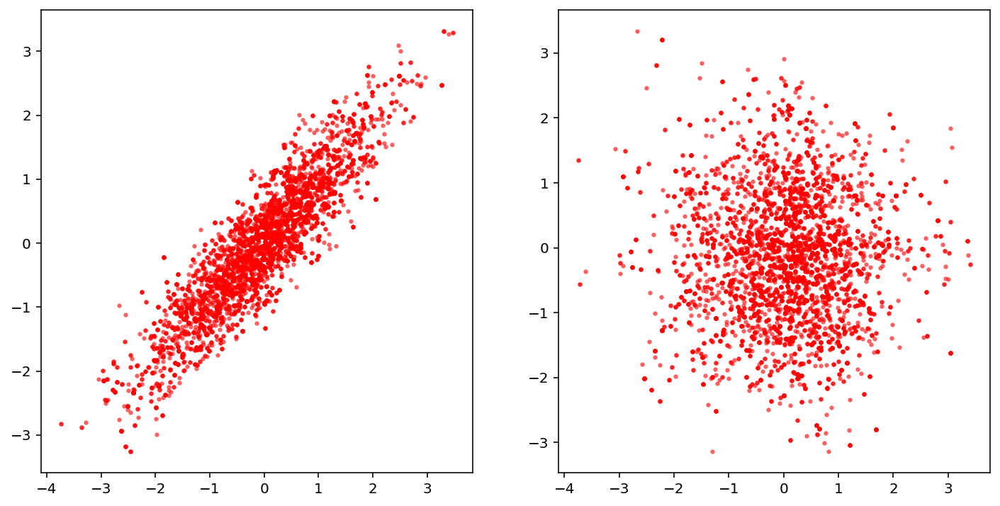

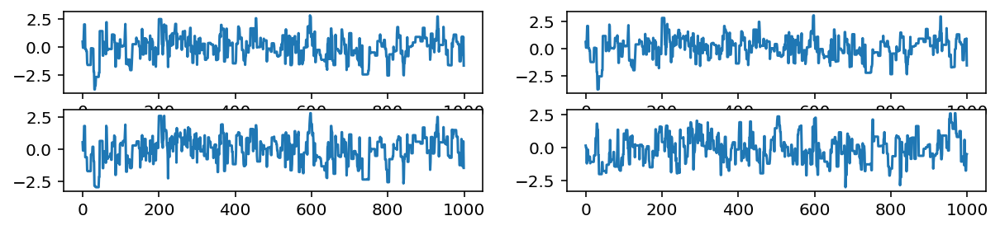

Removed no burn in
594.4944541047357
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.33E+00            8.33             600
param2           8.37E+00            8.37             597


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0634  p_{1}
param2        0.0456  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00170
  2      0.00714

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0306   0.0326   0.0910 upper
param1       0.1509   0.3021   0.3469 lower
param2       0.1164   0.1502   0.1496 upper
param2       0.0118   0.1440   0.1845 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

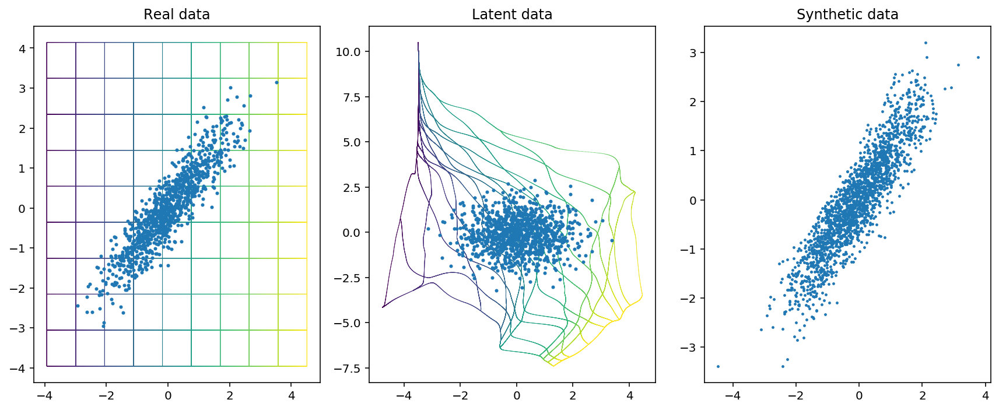

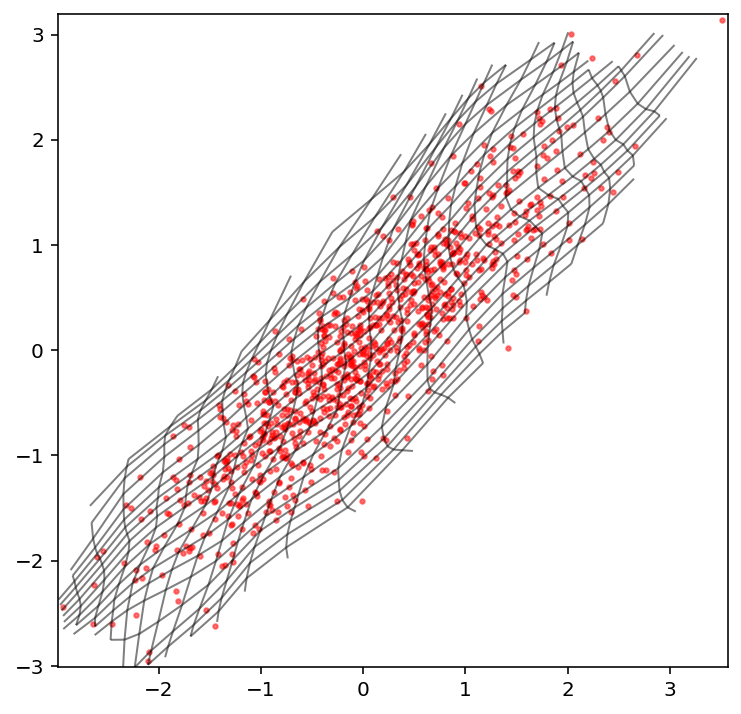

Creating directory for new run logs/test/run360
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


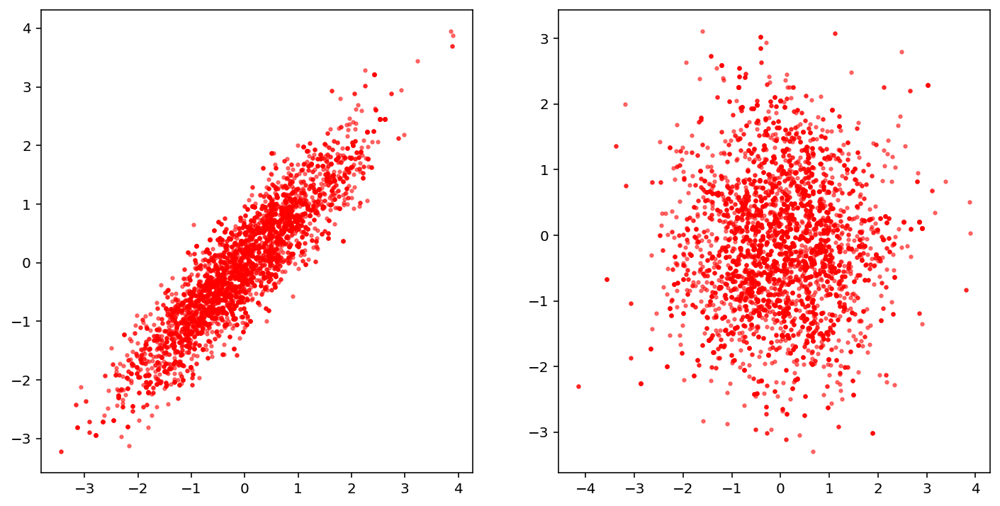

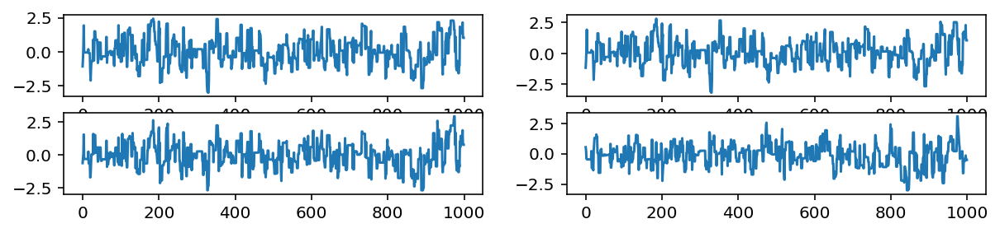

Removed no burn in
726.0498057025794
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.64E+00            6.64             753
param2           6.70E+00            6.70             746


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1004  p_{1}
param2        0.1265  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00649
  2      0.02042

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0442   0.1441   0.1802 upper
param1       0.0611   0.0675   0.0962 lower
param2       0.0549   0.1403   0.1659 upper
param2       0.0527   0.0253   0.1431 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

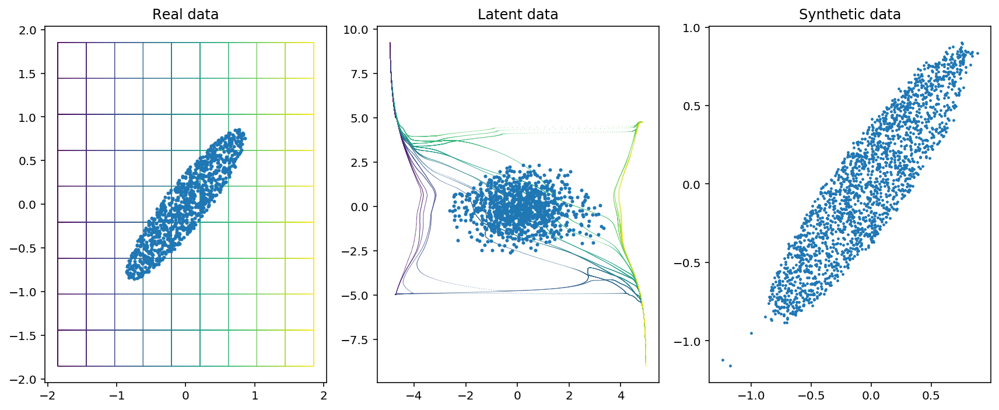

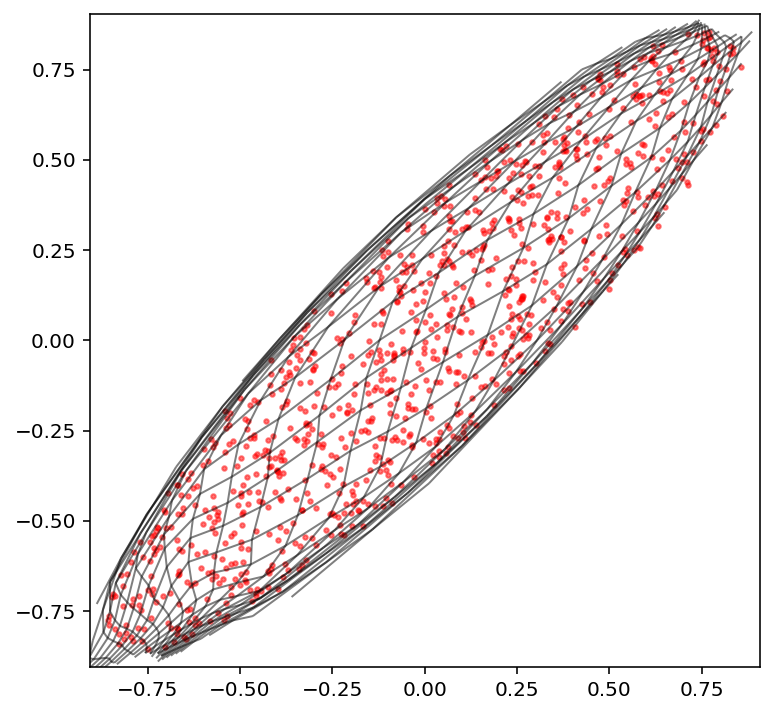

Creating directory for new run logs/test/run362
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


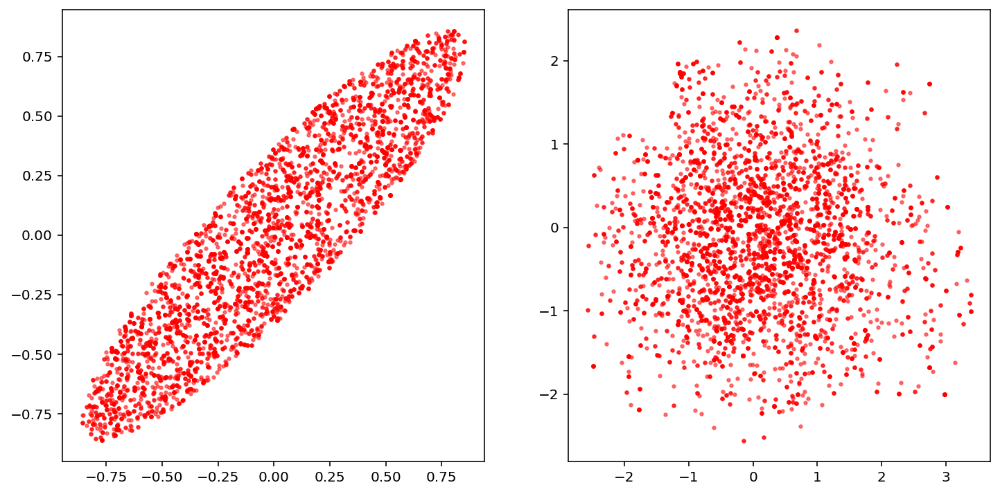

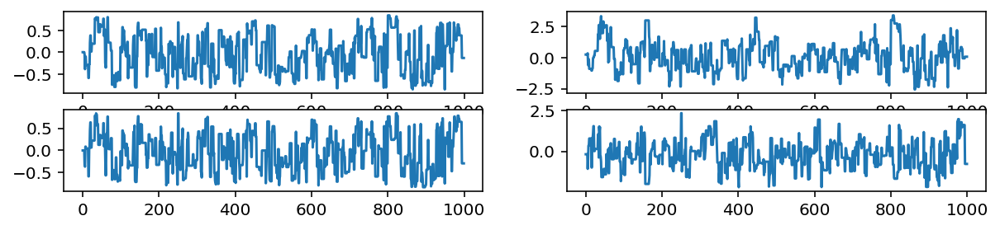

Removed no burn in
634.0216279296817
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.73E+00            7.73             647
param2           7.14E+00            7.14             701


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0753  p_{1}
param2        0.0534  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00284
  2      0.01667

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0330   0.0894   0.0834 upper
param1       0.0117   0.0235   0.0404 lower
param2       0.0381   0.0374   0.0348 upper
param2       0.0167   0.0277   0.0211 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           2          

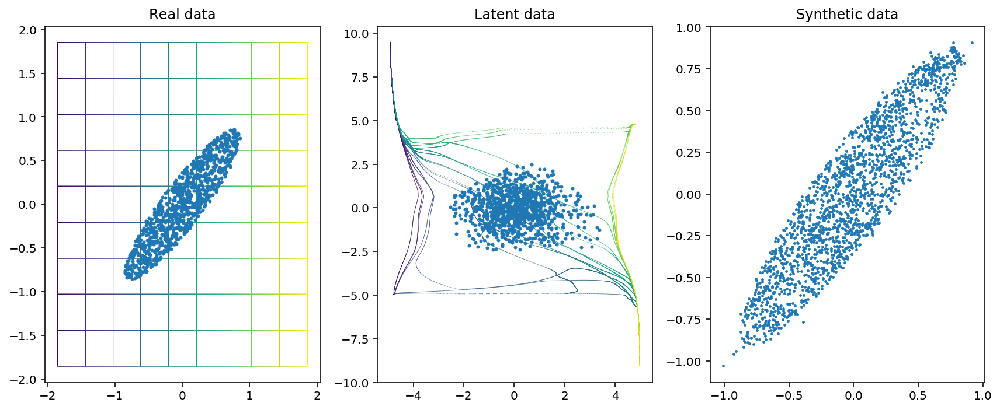

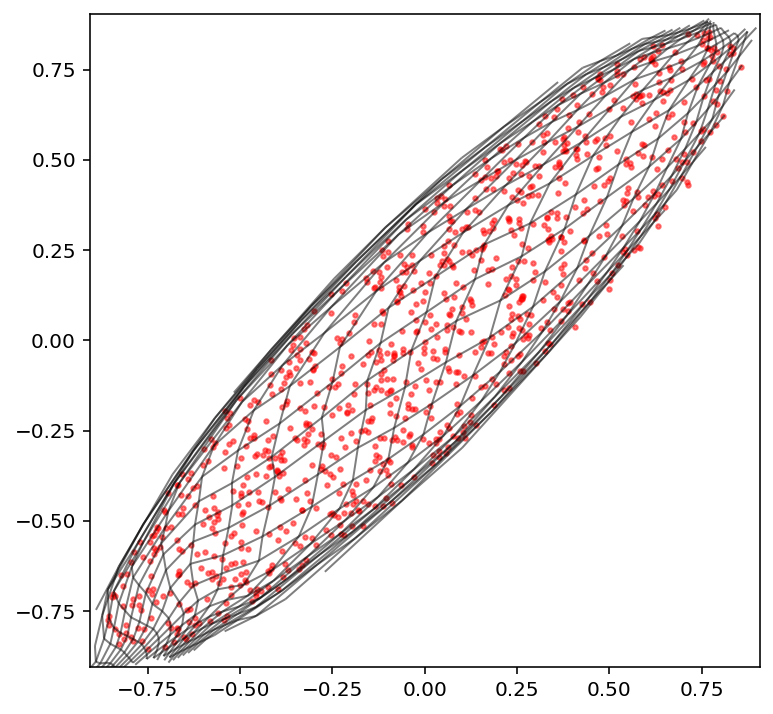

Creating directory for new run logs/test/run363
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


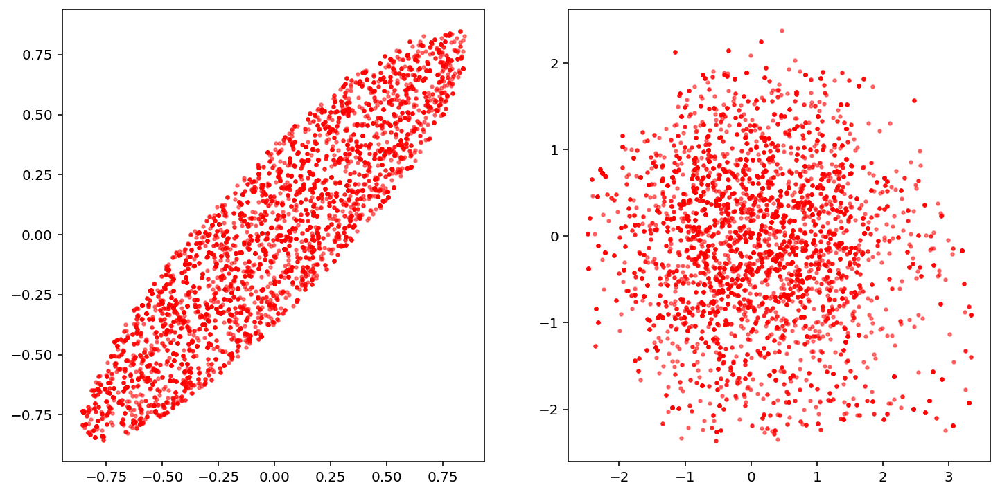

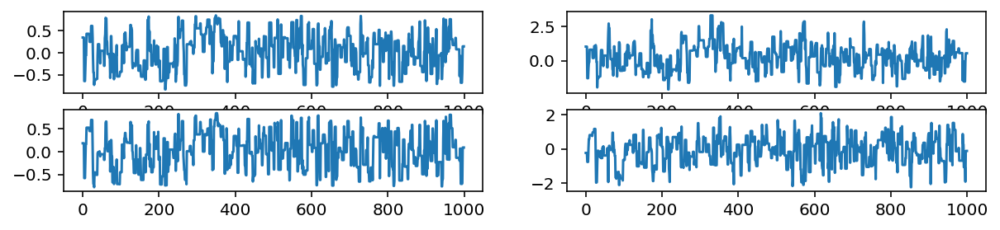

Removed no burn in
608.8350552360076
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.75E+00            7.75             645
param2           6.93E+00            6.93             721


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1153  p_{1}
param2        0.1000  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00683
  2      0.01464

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0516   0.0491   0.0460 upper
param1       0.0470   0.1258   0.1252 lower
param2       0.0223   0.0418   0.0406 upper
param2       0.0361   0.0601   0.0679 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [12]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [13]:
like = Himmelblau(2)
prior = UniformPrior(2, -5, 5)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.1020] validation loss [0.1043]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0589] validation loss [0.0614]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0507] validation loss [0.0522]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0491] validation loss [0.0502]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0489] validation loss [0.0498]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [700] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [702] ran

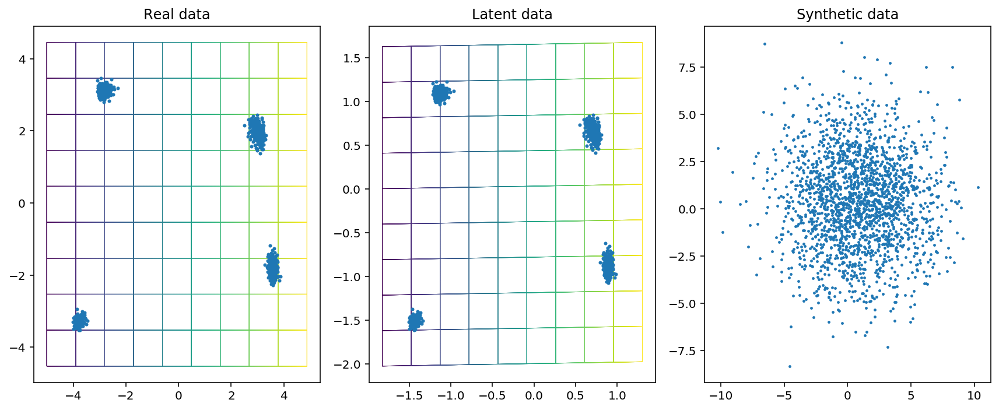

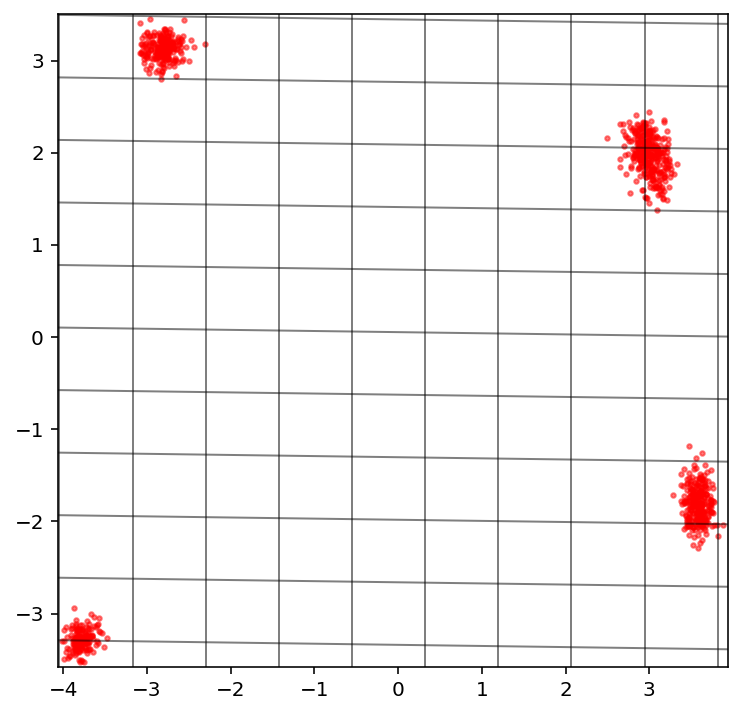

Creating directory for new run logs/test/run364
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


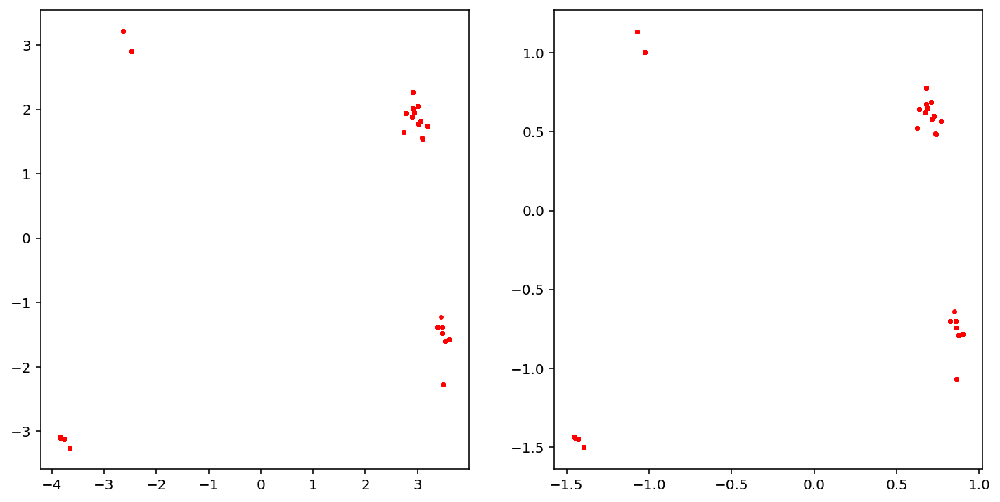

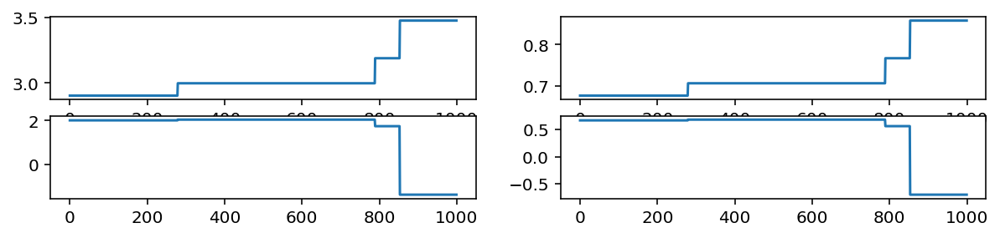

Removed no burn in
18.467768810694437
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.55E-01            0.86            5852
param2           7.06E-01            0.71            7088


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.4602  p_{1}
param2        0.7214  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.18173
  2      0.52039

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0225   0.0238   0.0206 upper
param1       0.0184   1.5793   1.3678 lower
param2       0.2216   0.3264   0.2936 upper
param2       0.0514   0.7426   0.6442 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

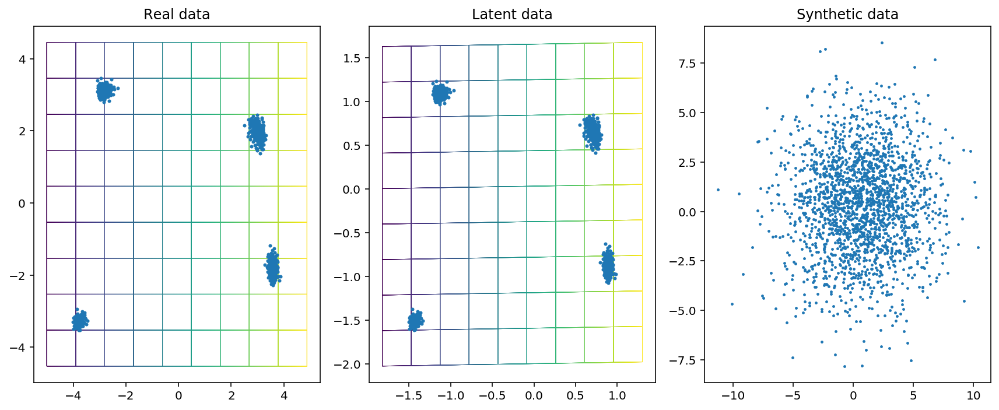

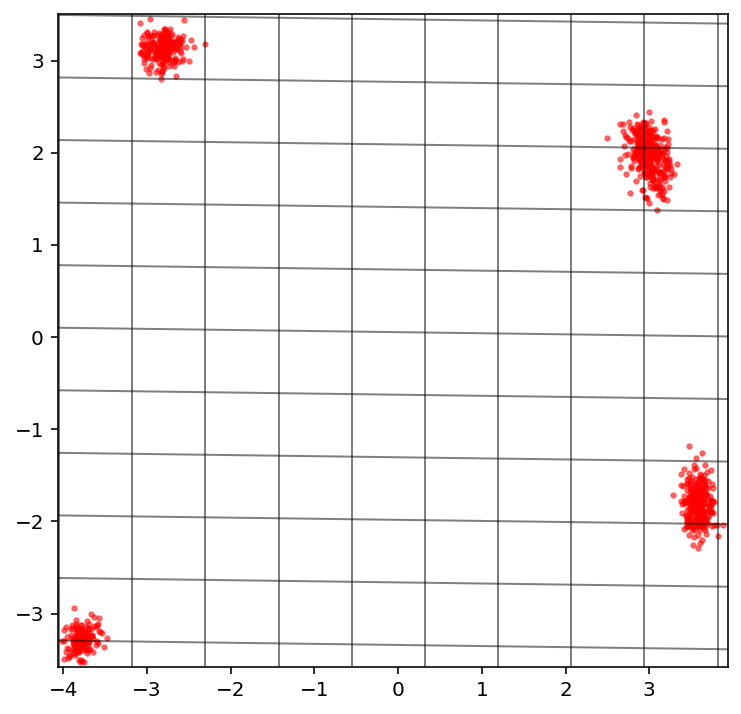

Creating directory for new run logs/test/run365
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:343: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


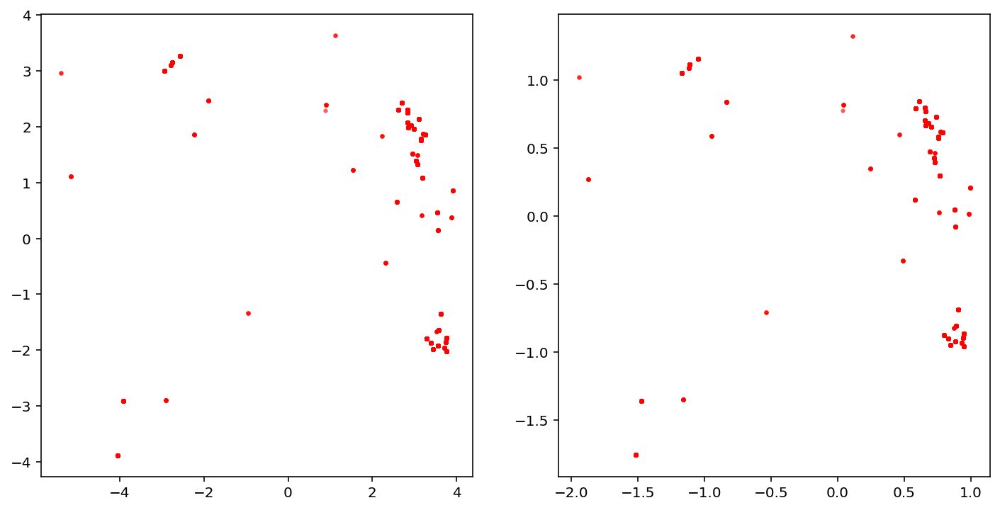

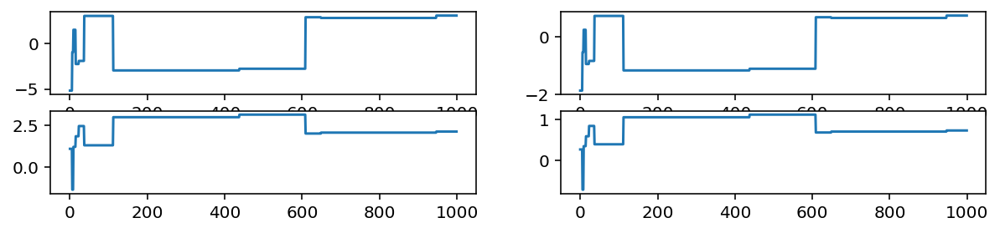

Removed no burn in
15.622610428896298
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.98E-01            0.70            7170
param2           7.10E-01            0.71            7049


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.7353  p_{1}
param2        0.7146  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.05348
  2      0.96351

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0017   0.0036   0.0091 upper
param1       0.2908   0.4077   1.4508 lower
param2       0.0193   0.2580   0.2844 upper
param2       0.3193   0.4152   0.5238 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

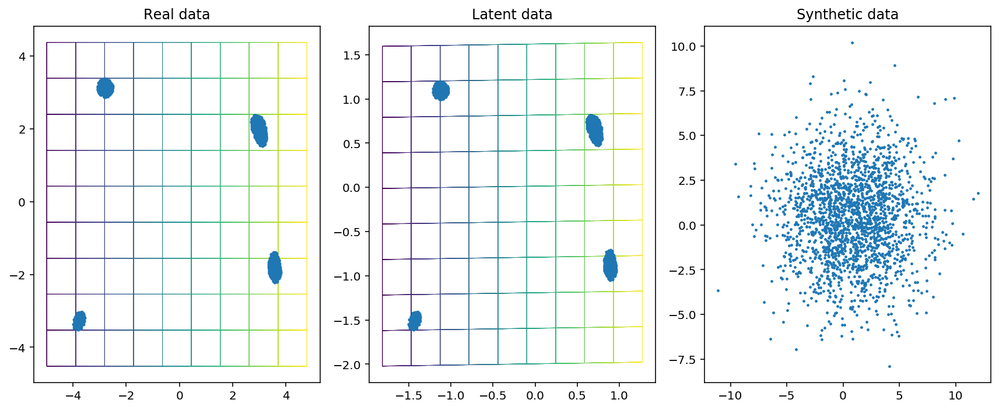

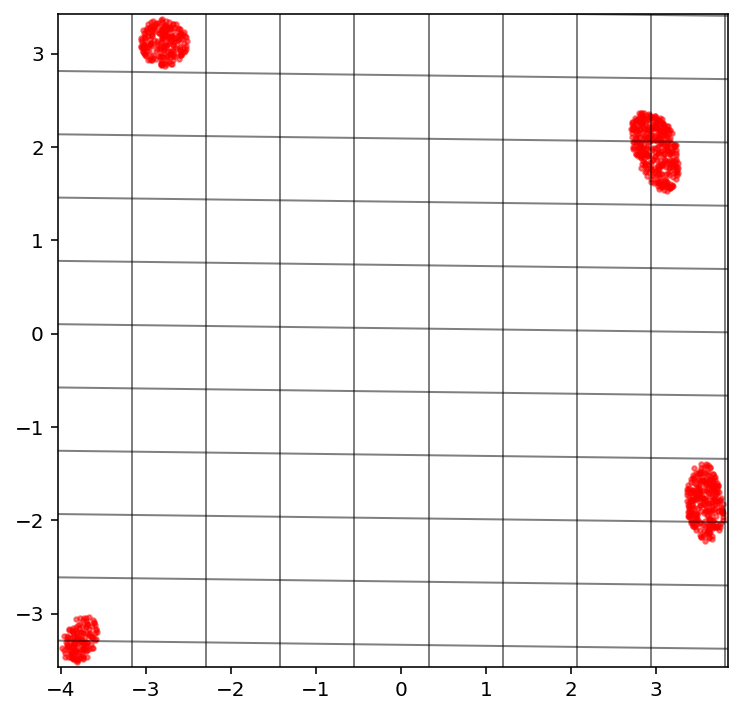

Creating directory for new run logs/test/run366
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


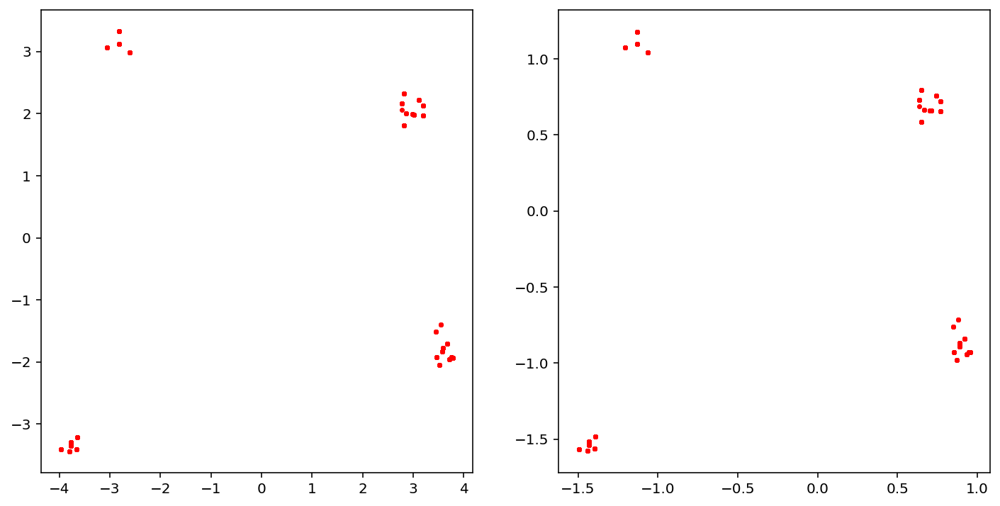

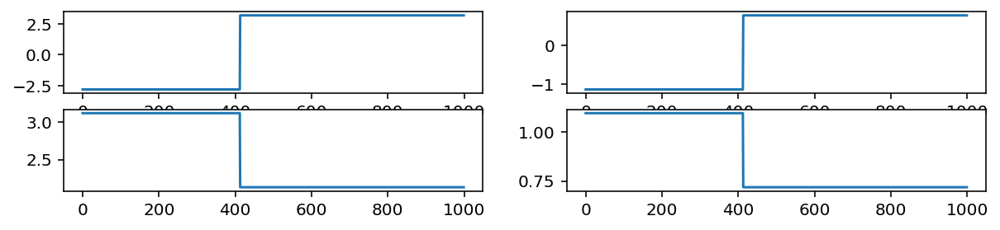

Removed no burn in
5004.999922892288
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.32E-01            0.33           15070
param2           4.43E-01            0.44           11286


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.5856  p_{1}
param2        1.2526  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.94092
  2      3.05374

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0049   0.0183   0.0336 upper
param1       0.0351   0.1700   0.1472 lower
param2       0.3668   0.2995   0.3415 upper
param2       0.0069   0.3325   0.3130 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

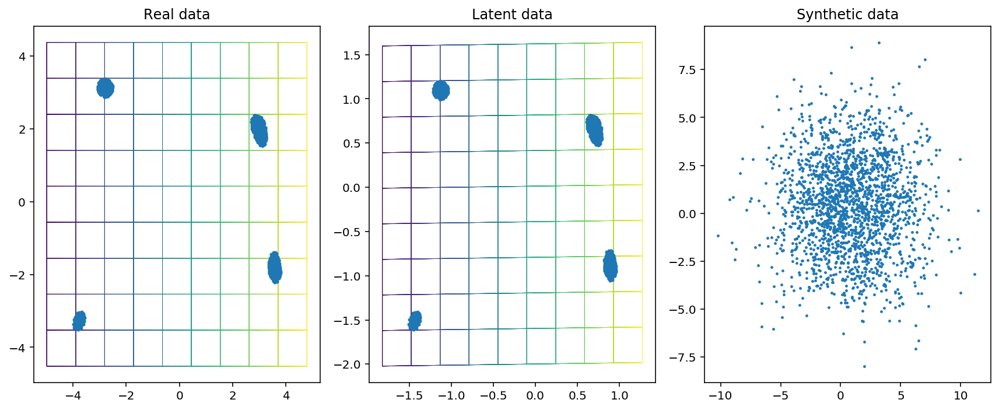

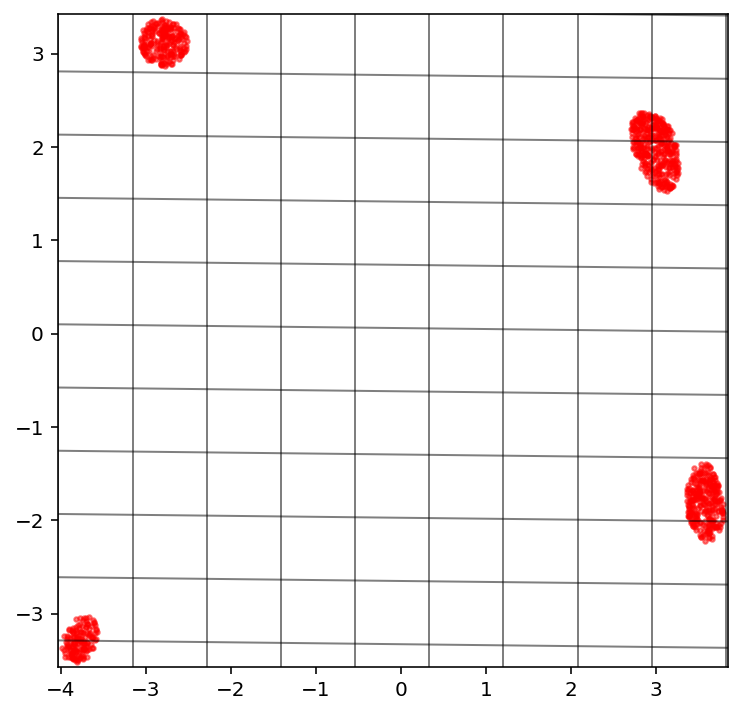

Creating directory for new run logs/test/run367
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


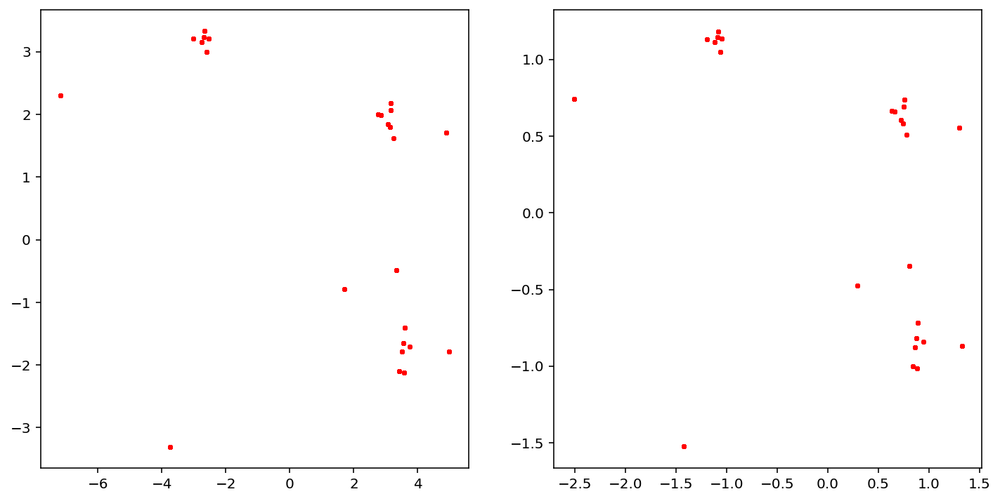

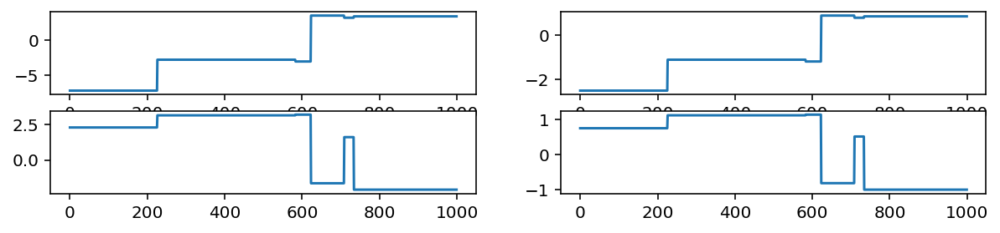

Removed no burn in
10.543941204228503
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.08E-01            0.51            9853
param2           6.54E-01            0.65            7654


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.1004  p_{1}
param2        0.8134  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.59352
  2      1.25343

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.2726   0.2226   0.2724 upper
param1       0.7071   0.9540   1.0674 lower
param2       0.0319   0.0325   0.0234 upper
param2       0.3843   0.3138   0.2827 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

In [14]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

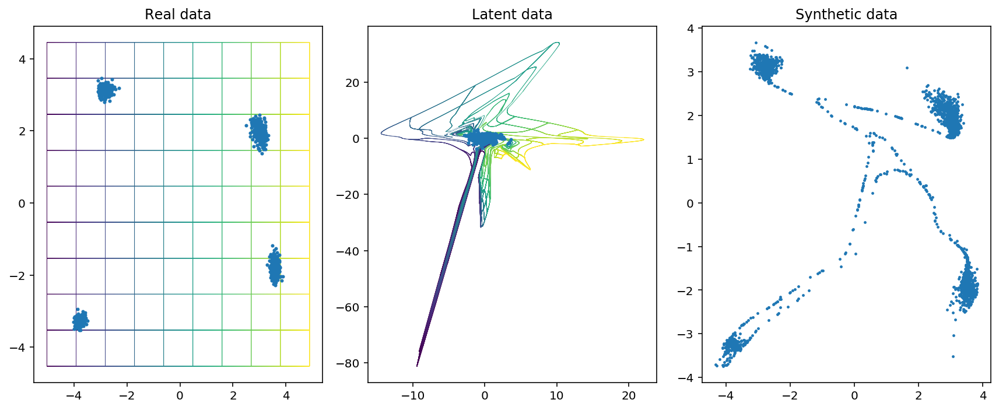

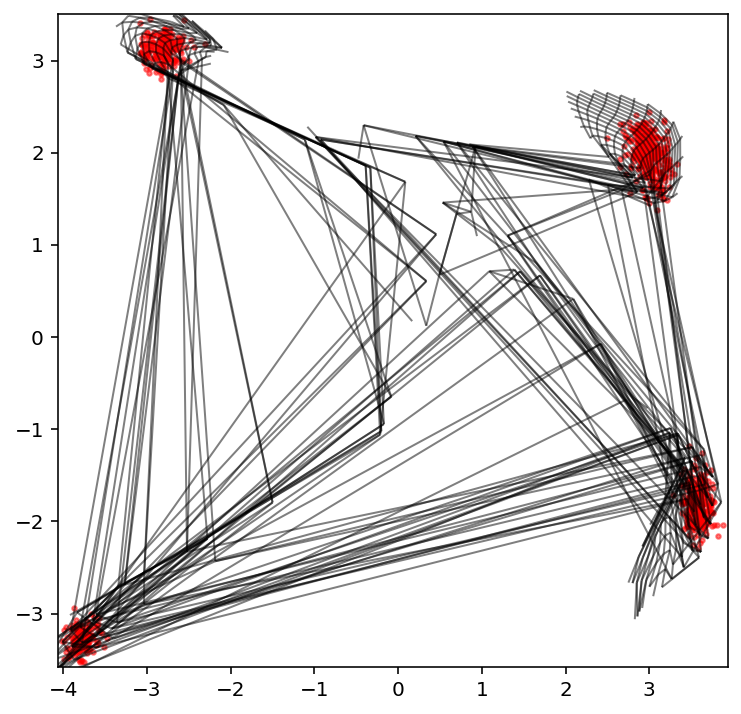

Creating directory for new run logs/test/run368
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


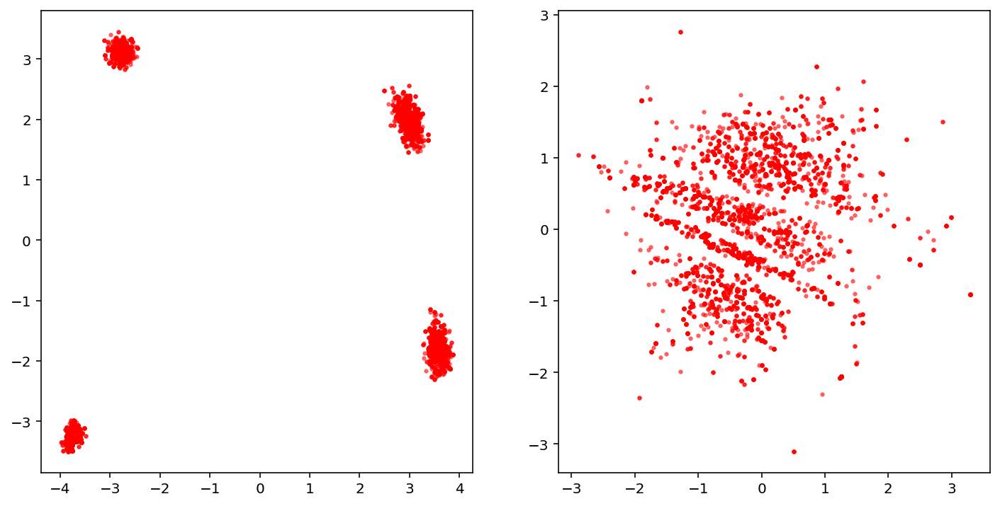

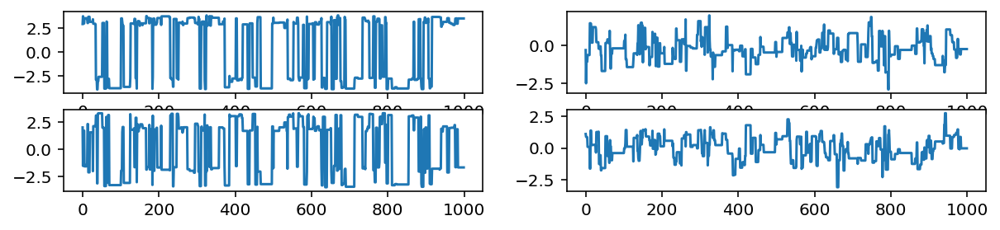

Removed no burn in
258.90731881053847
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.64E+01           16.36             305
param2           1.08E+01           10.83             462


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1744  p_{1}
param2        0.0982  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00648
  2      0.03560

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0047   0.0081   0.0077 upper
param1       0.0059   0.0029   0.0102 lower
param2       0.0036   0.0131   0.0159 upper
param2       0.0095   0.0149   0.0266 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

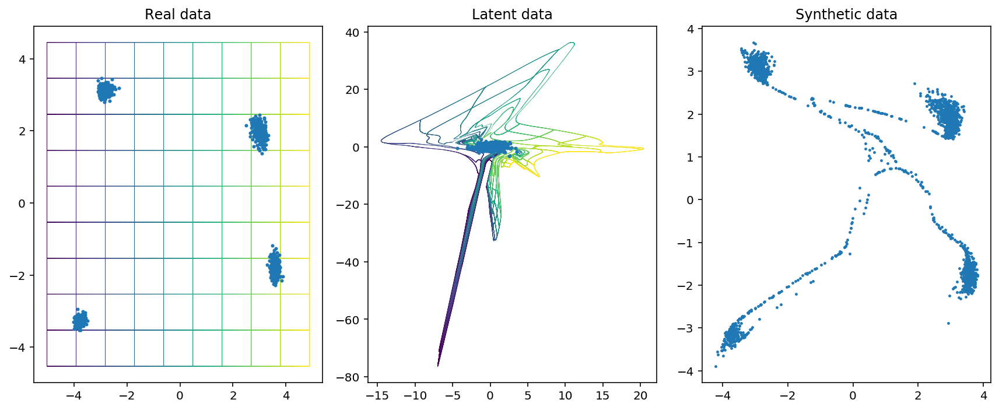

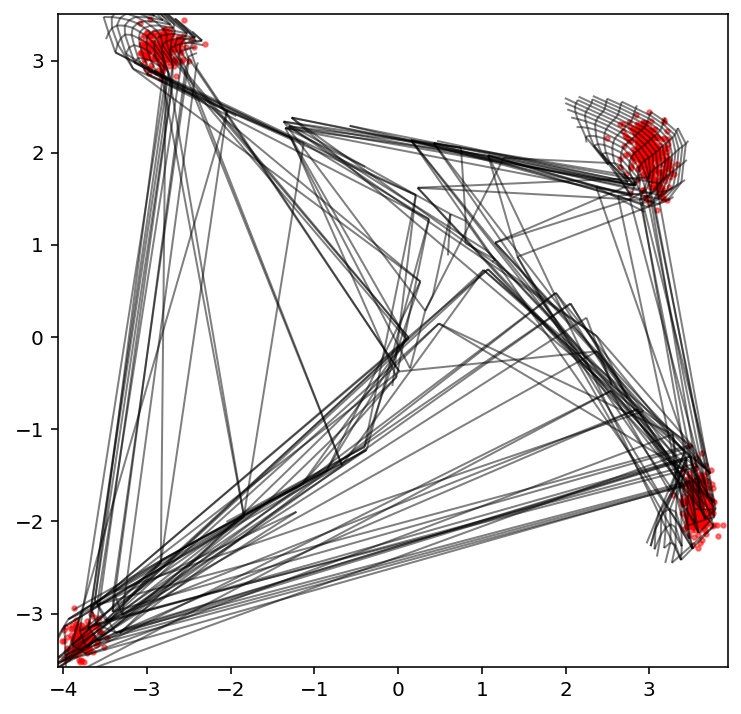

Creating directory for new run logs/test/run369
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


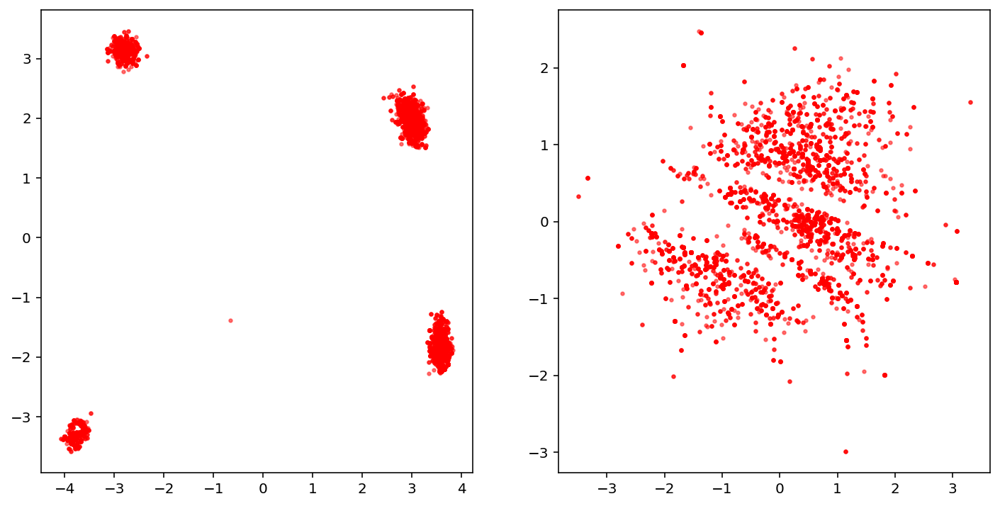

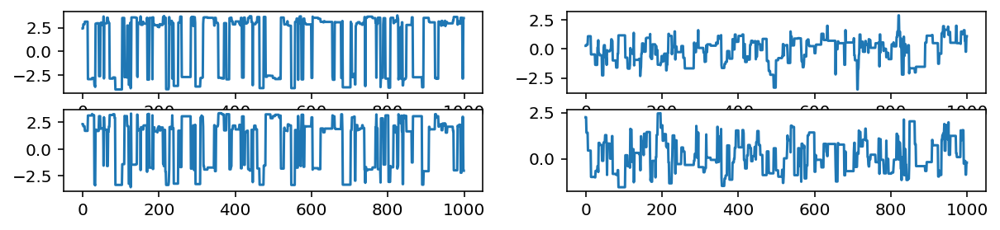

Removed no burn in
393.73494632059504
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.21E+01           12.11             413
param2           1.16E+01           11.60             431


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1457  p_{1}
param2        0.1172  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00579
  2      0.02695

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0007   0.0085   0.0088 upper
param1       0.0061   0.0083   0.0084 lower
param2       0.0058   0.0040   0.0077 upper
param2       0.0042   0.0118   0.0128 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

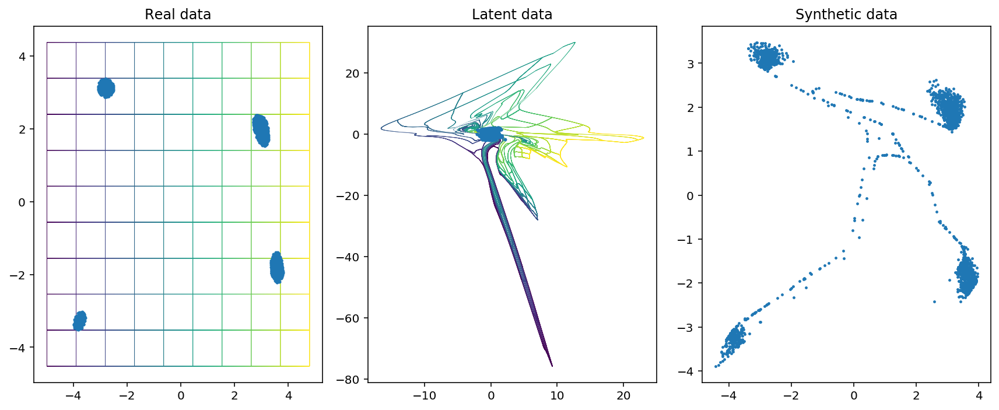

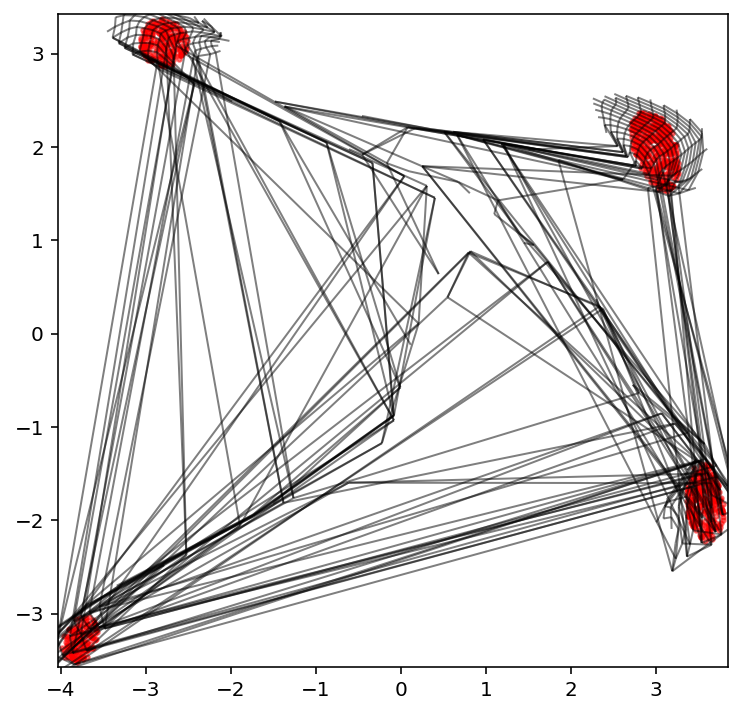

Creating directory for new run logs/test/run370
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


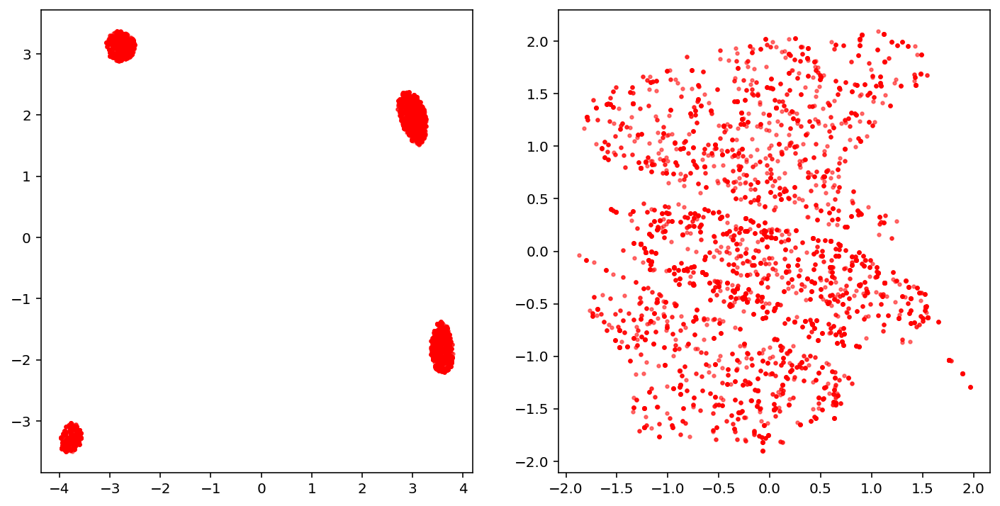

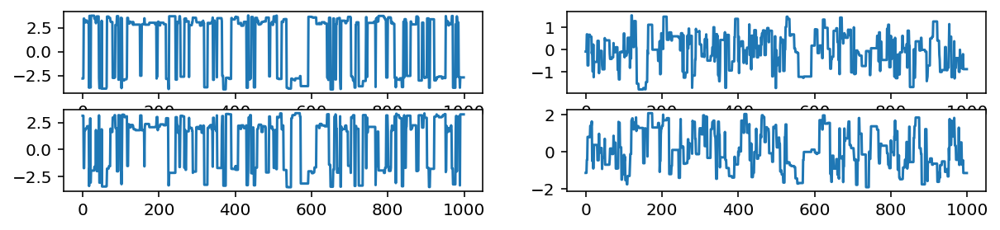

Removed no burn in
619.4832255881154
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.06E+00            8.06             620
param2           8.87E+00            8.87             564


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0681  p_{1}
param2        0.1097  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00399
  2      0.01247

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0027   0.0038   0.0042 upper
param1       0.0057   0.0046   0.0049 lower
param2       0.0011   0.0026   0.0036 upper
param2       0.0009   0.0045   0.0074 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

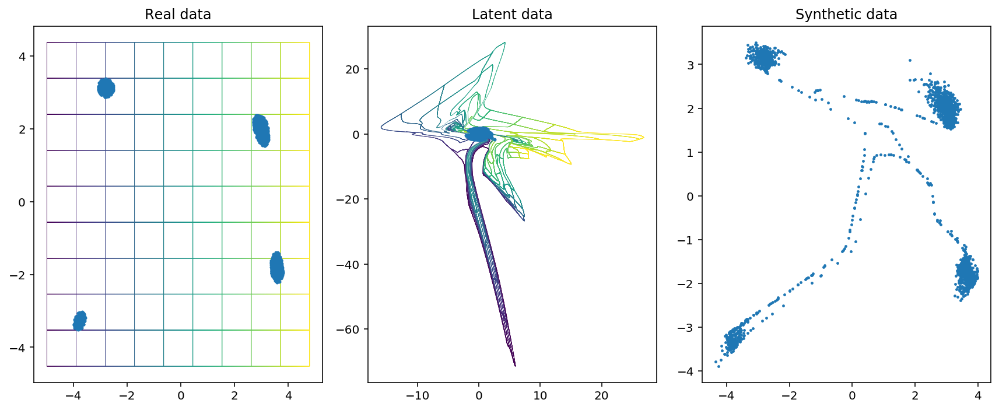

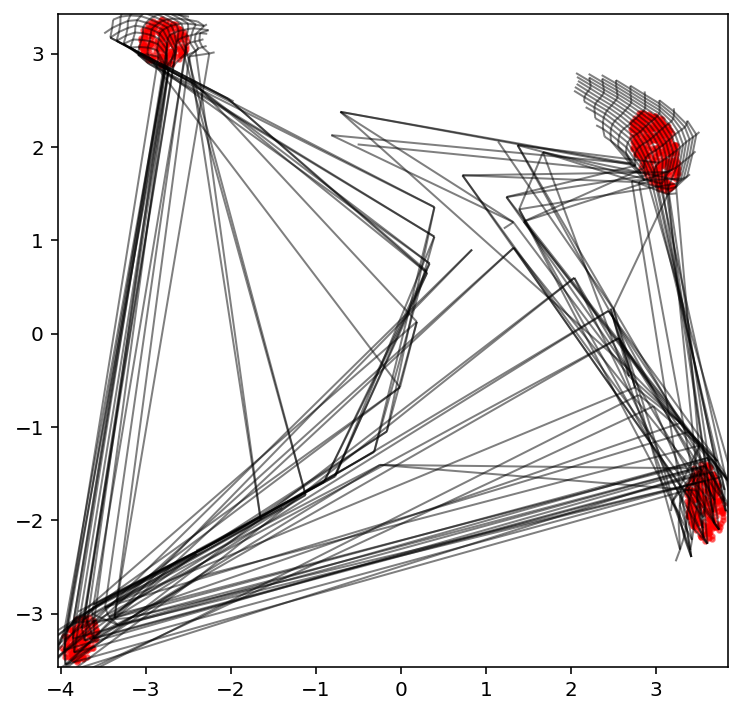

Creating directory for new run logs/test/run371
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


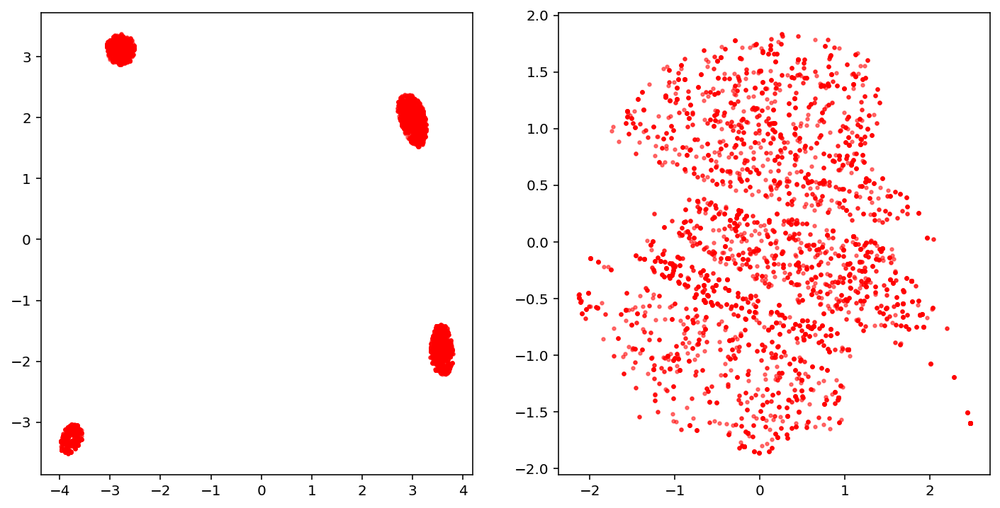

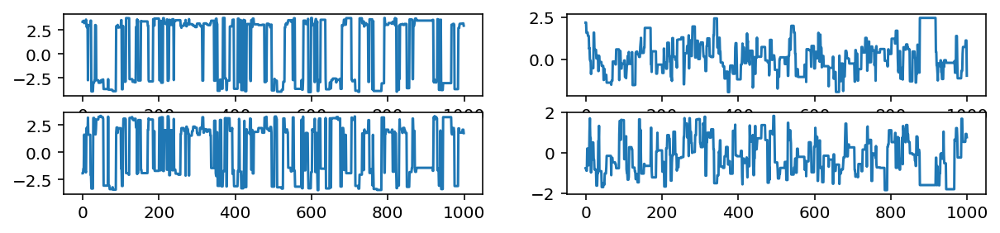

Removed no burn in
604.7000261704995
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.10E+00            8.10             617
param2           7.74E+00            7.74             646


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0976  p_{1}
param2        0.0488  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00190
  2      0.00987

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0029   0.0026   0.0030 upper
param1       0.0040   0.0133   0.0119 lower
param2       0.0027   0.0044   0.0045 upper
param2       0.0141   0.0131   0.0120 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [15]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

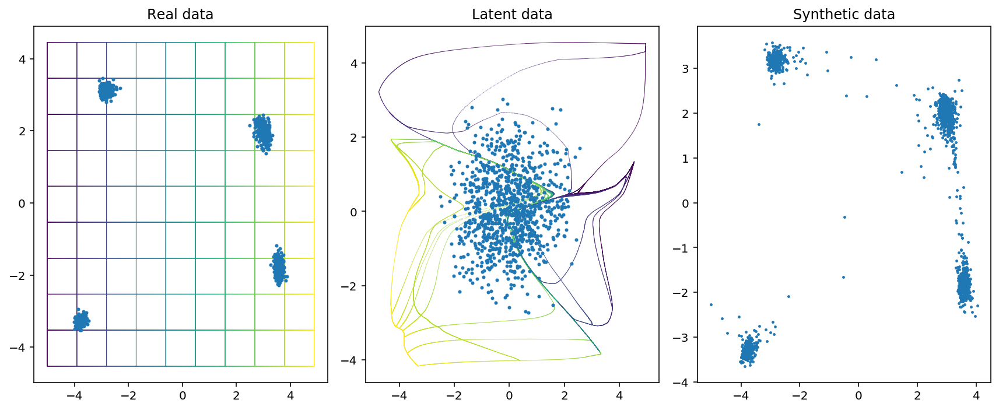

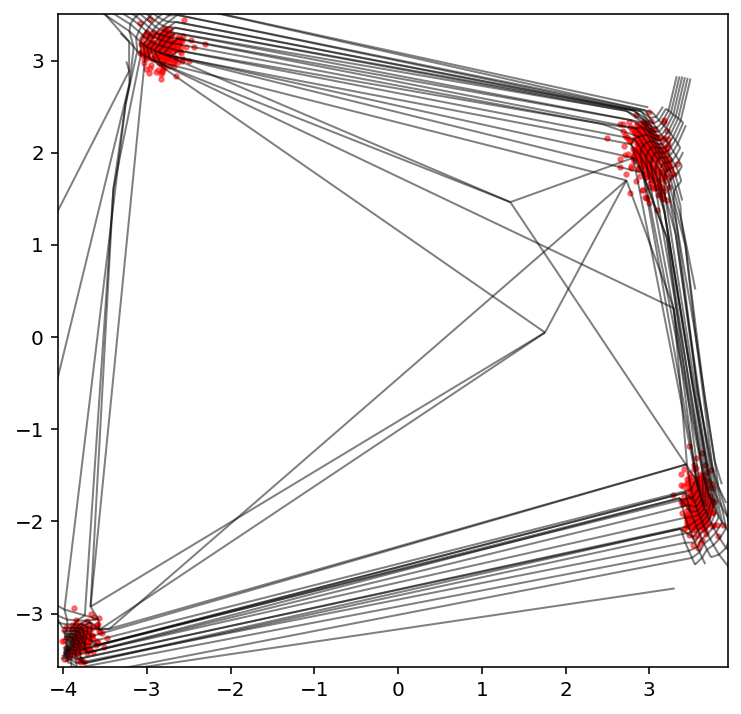

Creating directory for new run logs/test/run373
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


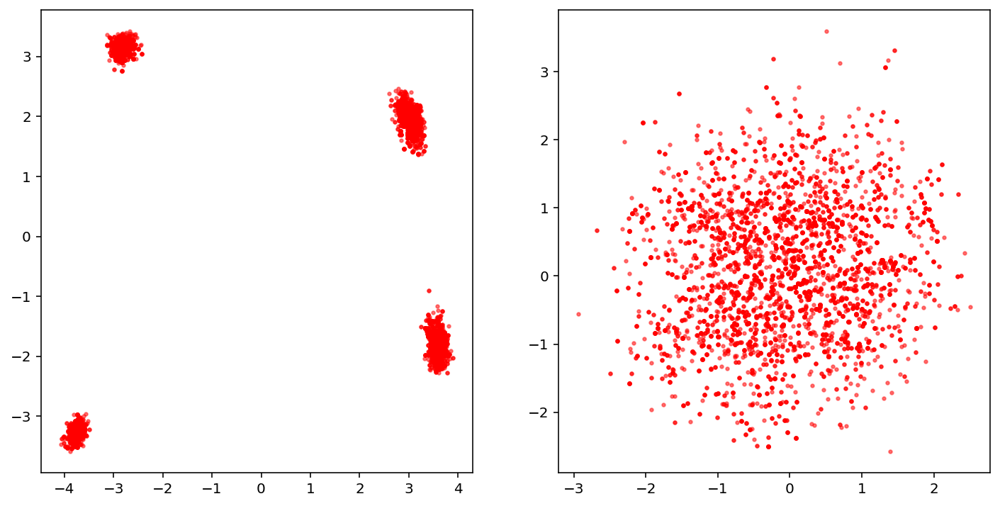

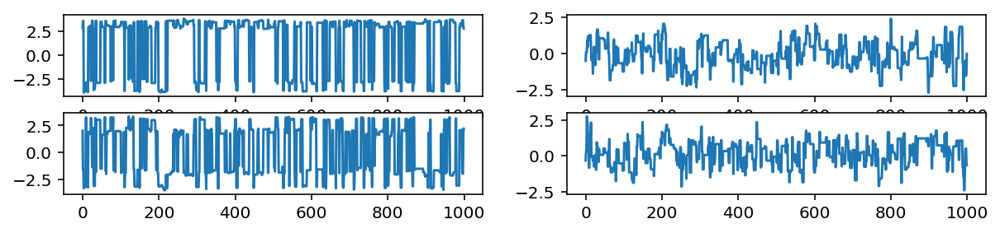

Removed no burn in
772.286133809871
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.43E+00            6.43             777
param2           7.56E+00            7.56             661


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0717  p_{1}
param2        0.0696  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00423
  2      0.00569

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0043   0.0036   0.0043 upper
param1       0.0040   0.0053   0.0062 lower
param2       0.0012   0.0066   0.0076 upper
param2       0.0040   0.0096   0.0090 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

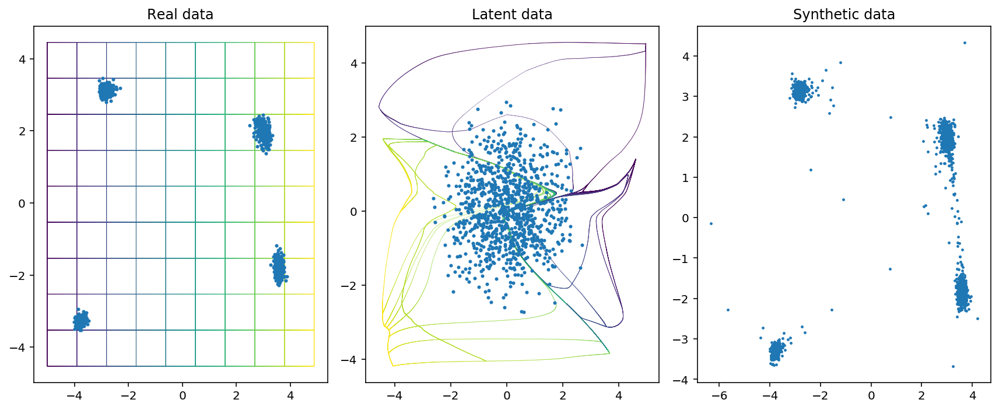

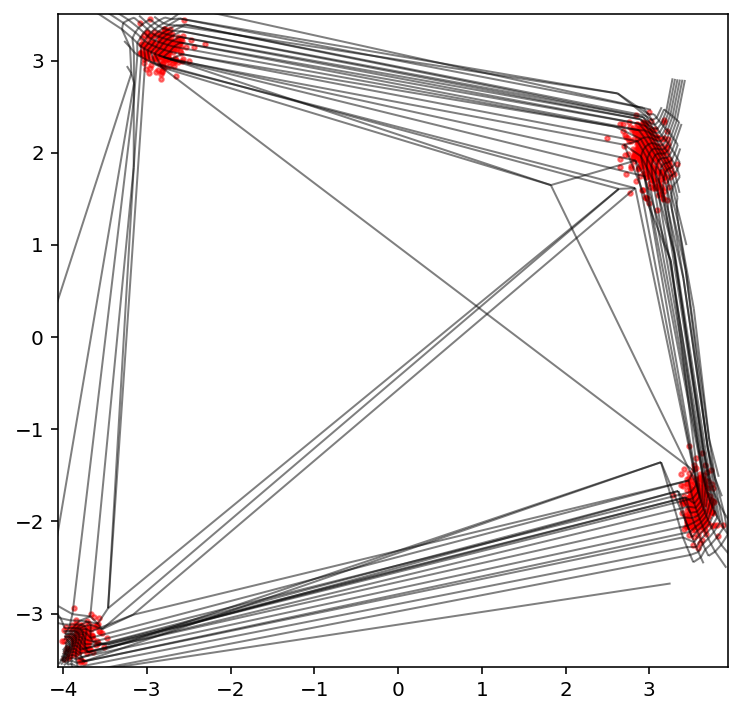

Creating directory for new run logs/test/run374
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


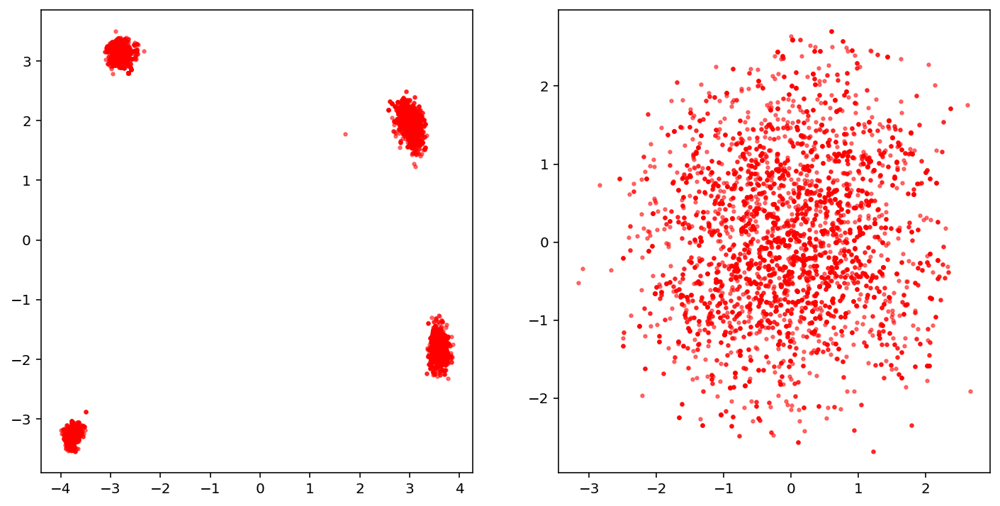

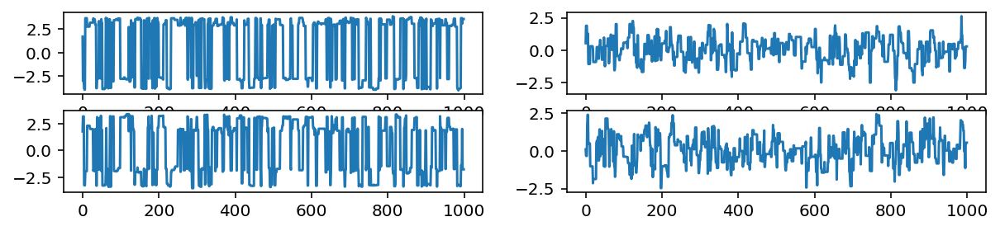

Removed no burn in
788.6590180838111
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.33E+00            6.33             790
param2           6.85E+00            6.85             730


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0474  p_{1}
param2        0.0813  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00215
  2      0.00673

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0004   0.0025   0.0036 upper
param1       0.0053   0.0050   0.0058 lower
param2       0.0034   0.0123   0.0109 upper
param2       0.0021   0.0017   0.0116 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

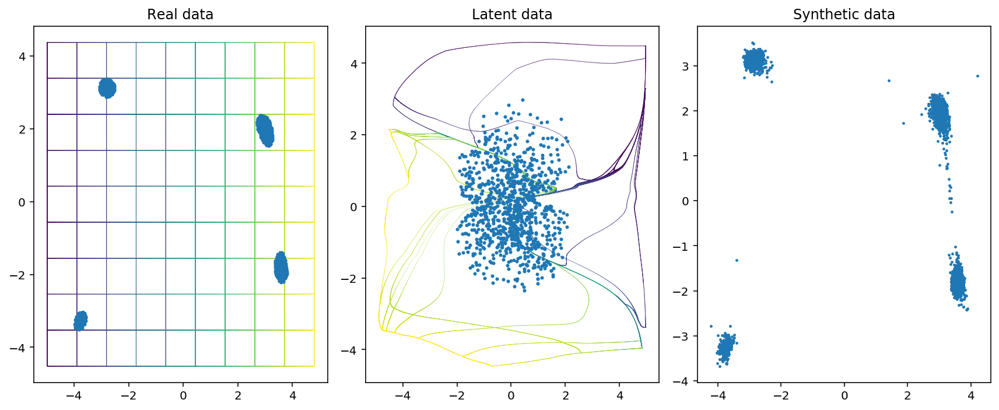

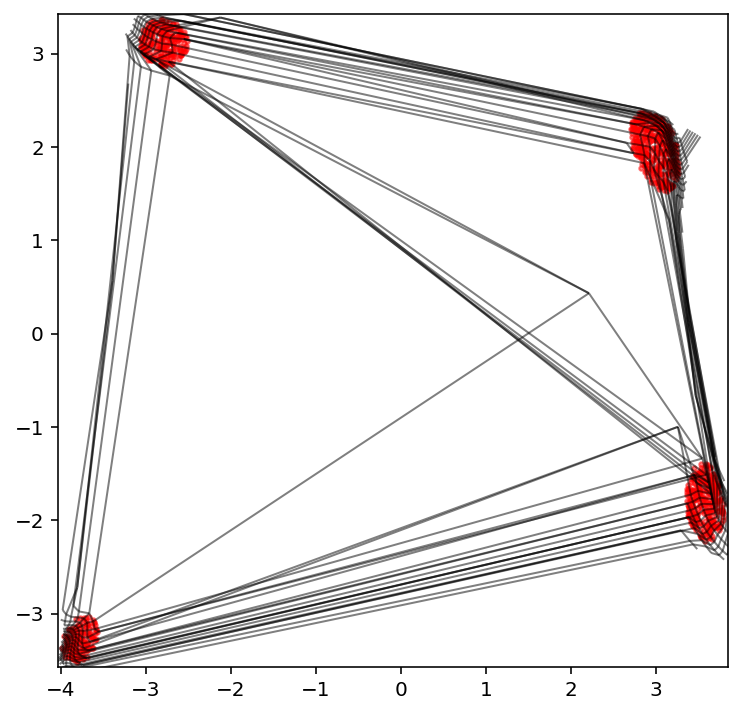

Creating directory for new run logs/test/run375
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


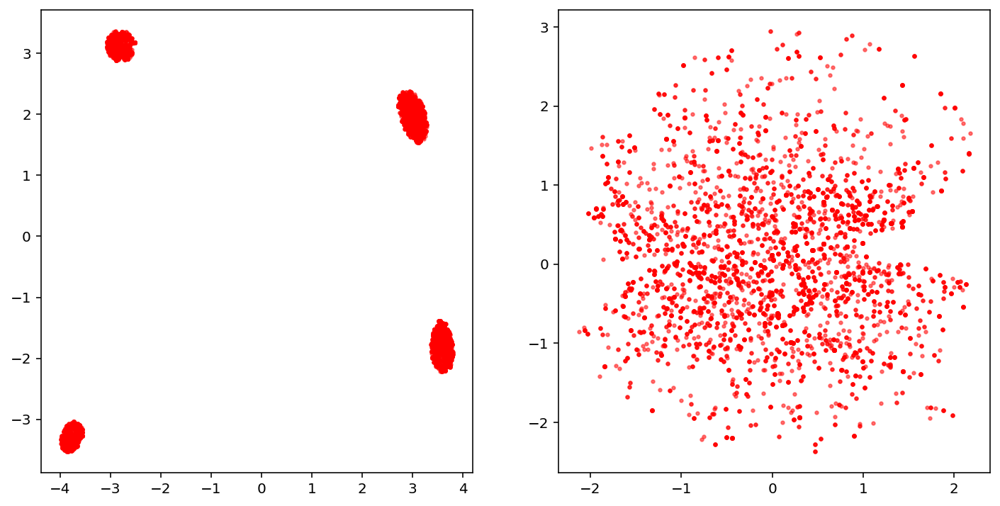

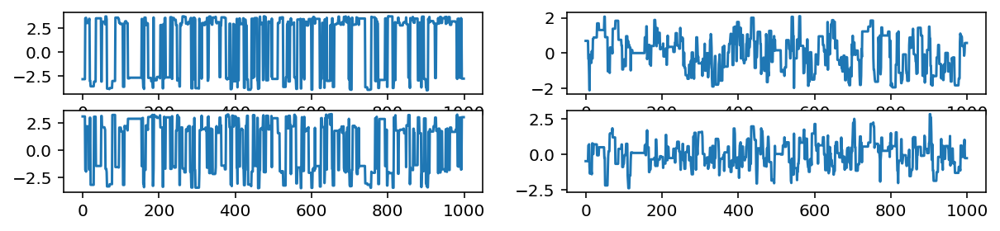

Removed no burn in
727.3680402179774
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.87E+00            6.87             728
param2           7.87E+00            7.87             636


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0542  p_{1}
param2        0.0794  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00151
  2      0.00757

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0008   0.0023   0.0022 upper
param1       0.0001   0.0121   0.0064 lower
param2       0.0044   0.0052   0.0096 upper
param2       0.0012   0.0117   0.0115 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

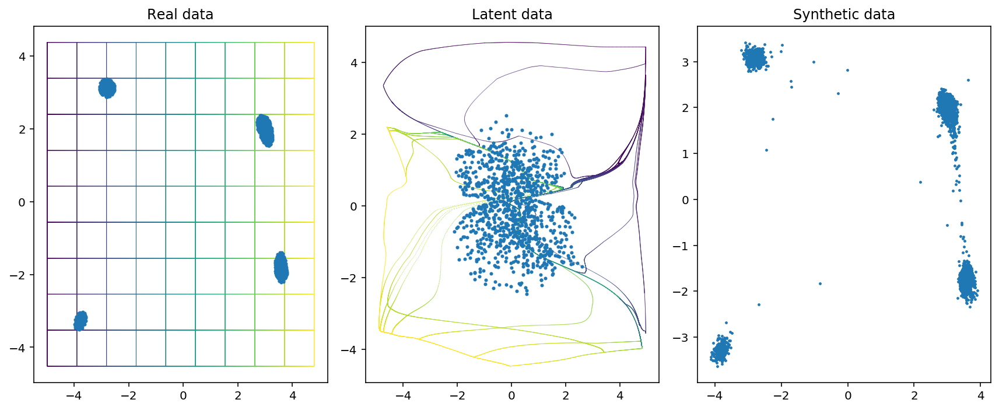

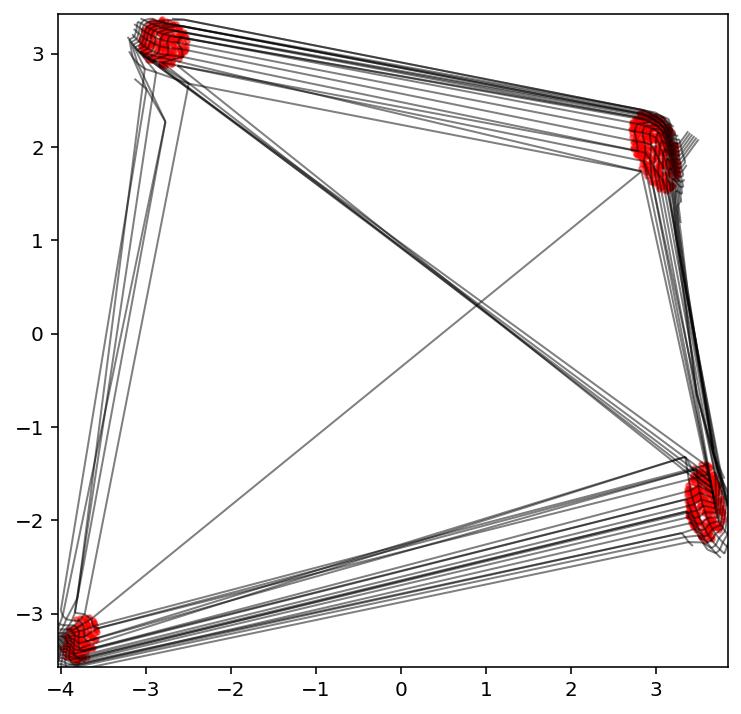

Creating directory for new run logs/test/run376
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


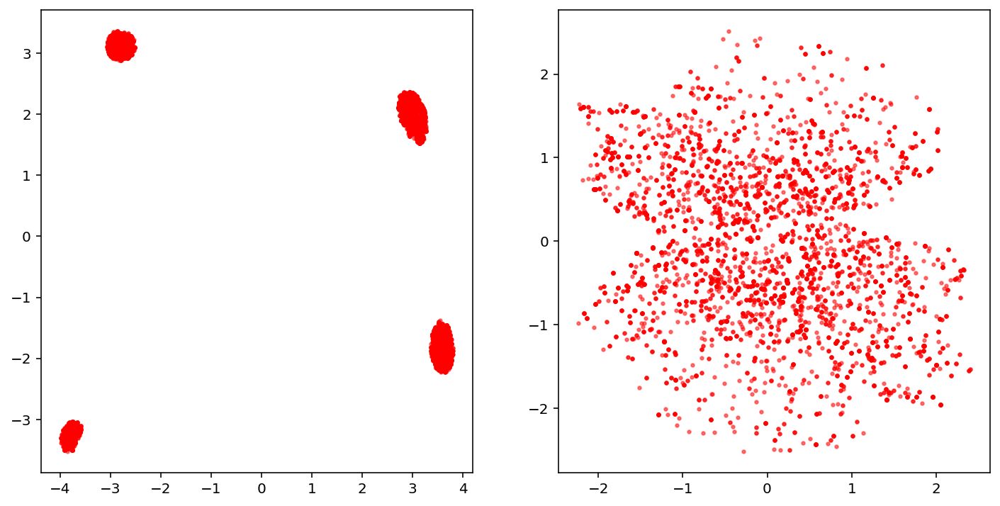

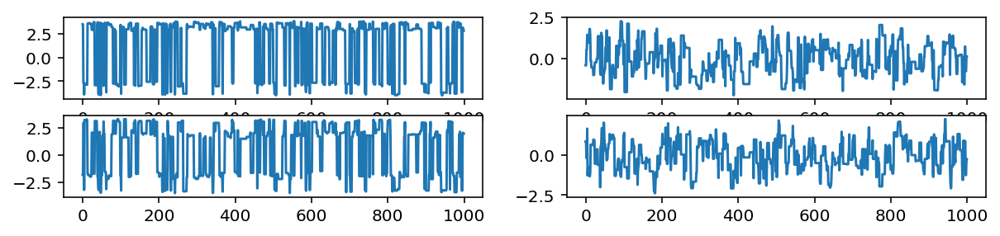

Removed no burn in
766.7315356109546
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.41E+00            6.41             781
param2           7.90E+00            7.90             633


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0899  p_{1}
param2        0.0674  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00231
  2      0.00957

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0027   0.0009   0.0057 upper
param1       0.0021   0.0110   0.0091 lower
param2       0.0019   0.0021   0.0015 upper
param2       0.0038   0.0187   0.0167 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [16]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [17]:
like = Rosenbrock(2)
prior = UniformPrior(2, -2, 12)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0502] validation loss [0.0384]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0277] validation loss [0.0255]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0251] validation loss [0.0238]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0236] validation loss [0.0228]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0225] validation loss [0.0221]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0218] validation loss [0.0218]
[nnest.trainer] [INFO] Epoch [593] ran out of patience
[nnest.trainer] [INFO] Best epoch [543] validation loss [0.0218]


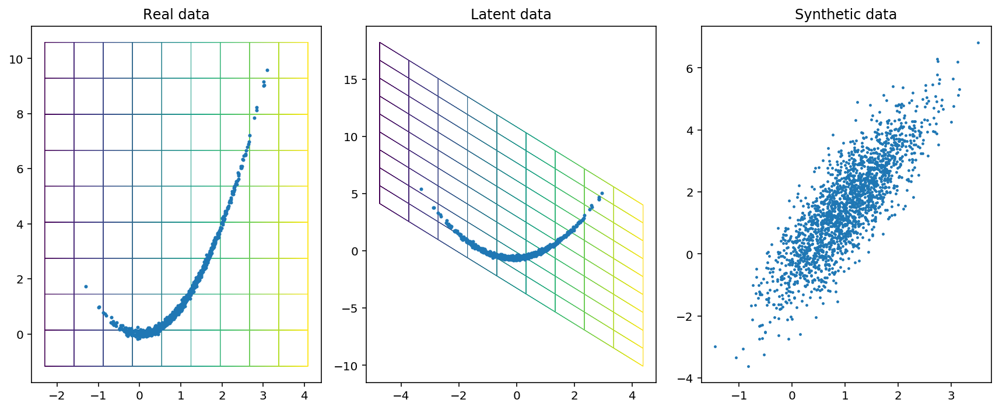

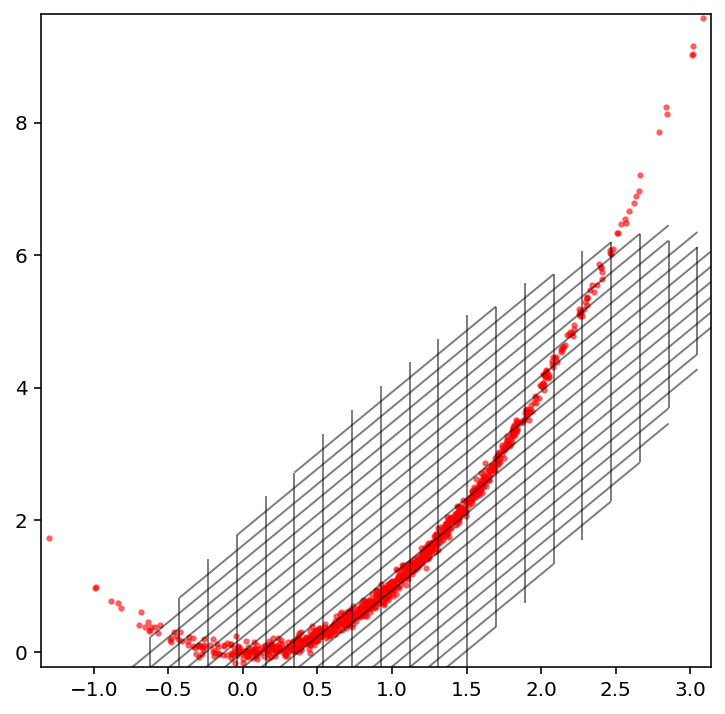

Creating directory for new run logs/test/run377
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


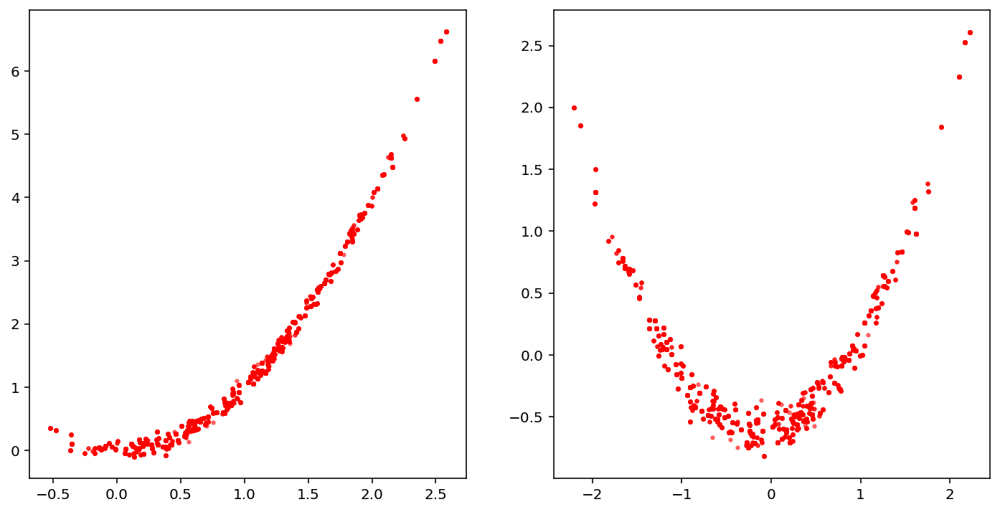

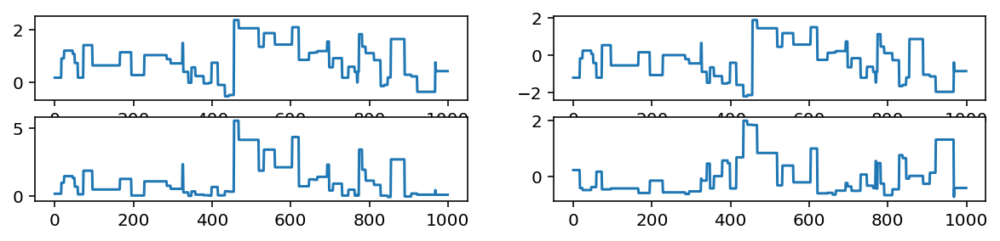

Removed no burn in
123.41663417451132
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.77E+01           37.73             132
param2           3.67E+01           36.69             136


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2005  p_{1}
param2        0.2019  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.03913
  2      0.04092

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.3783   0.3405   0.3080 upper
param1       0.2352   0.2049   0.2683 lower
param2       0.8068   0.7851   0.7028 upper
param2       0.0190   0.0218   0.0296 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

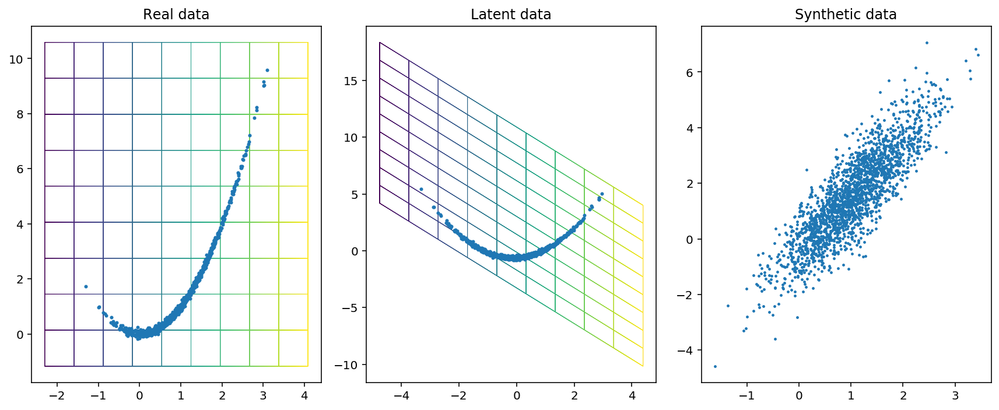

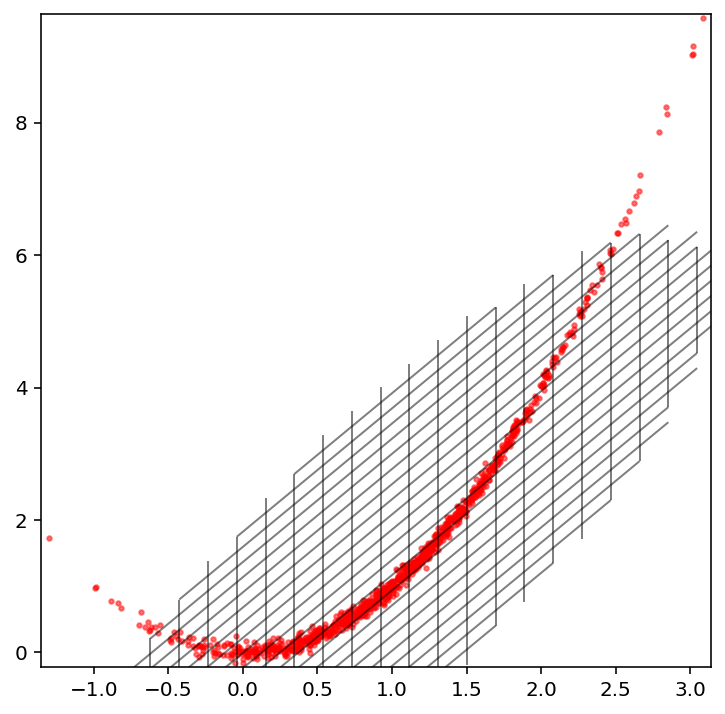

Creating directory for new run logs/test/run378
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


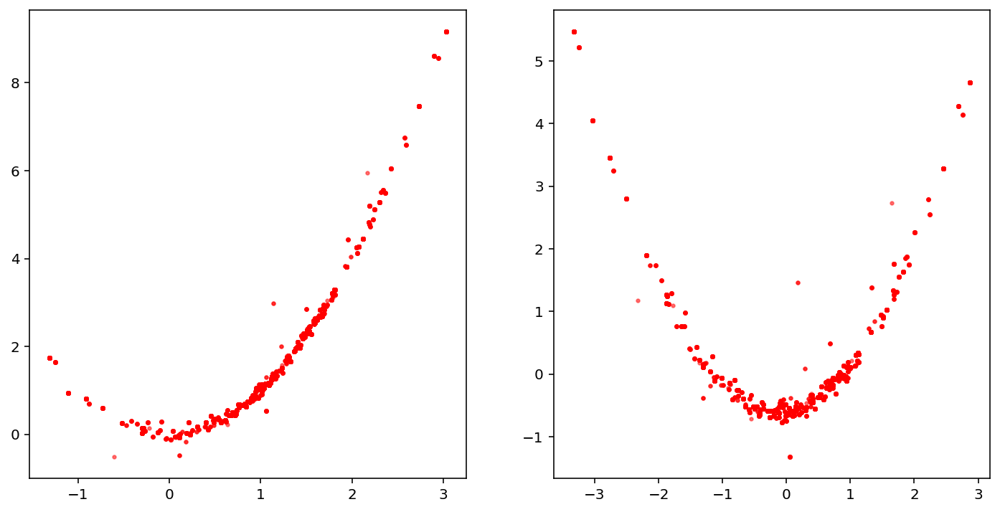

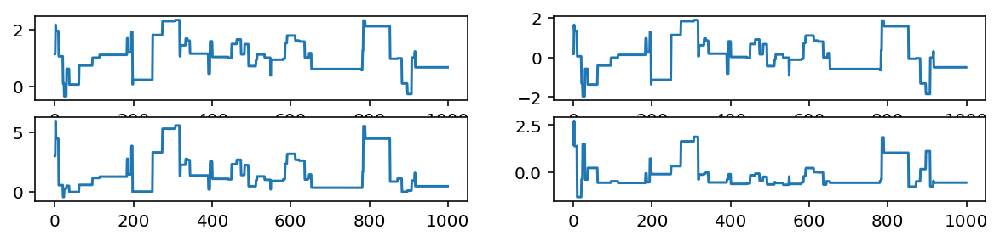

Removed no burn in
36.87406080384758
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.89E-01            0.89            5627
param2           9.03E-01            0.90            5545


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3944  p_{1}
param2        0.3673  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.10209
  2      0.15572

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.3941   0.5082   0.6368 upper
param1       0.2400   0.7080   0.9362 lower
param2       1.0555   1.2936   1.5219 upper
param2       0.0274   0.0271   0.0360 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

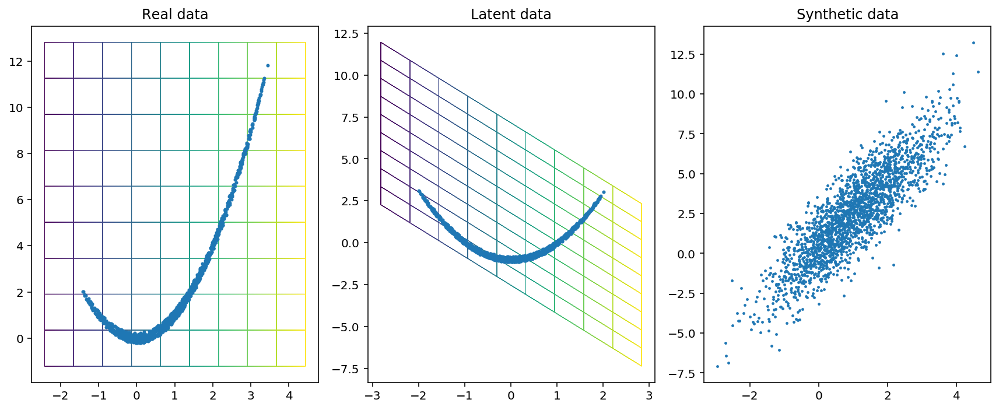

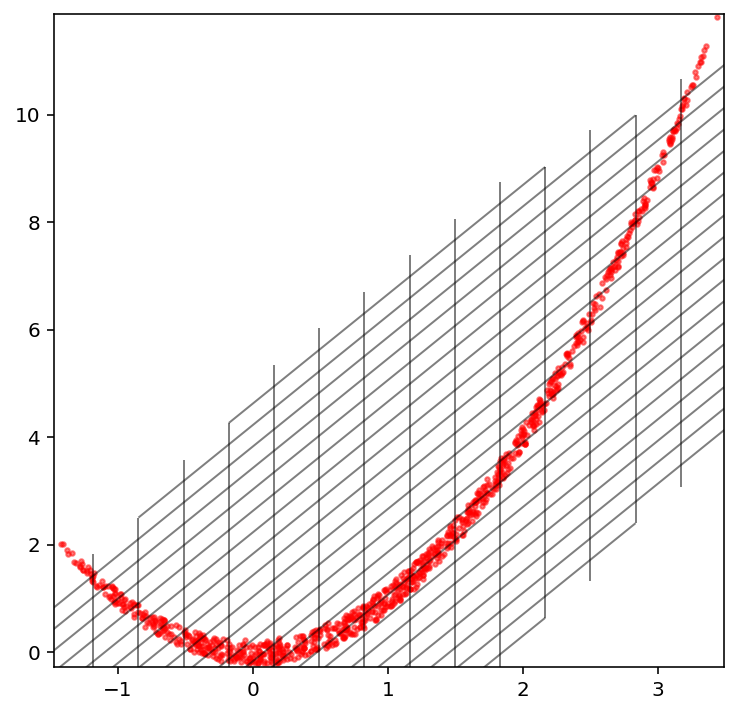

Creating directory for new run logs/test/run379
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


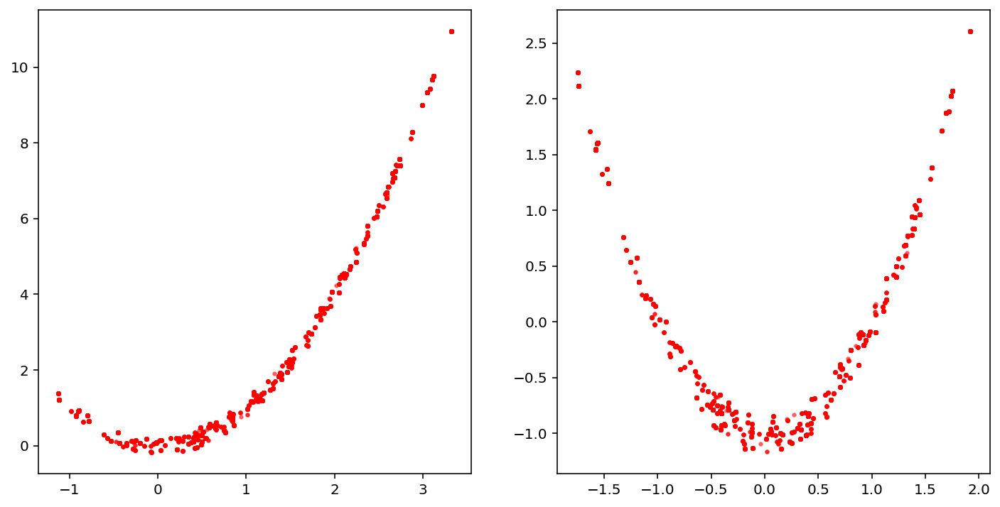

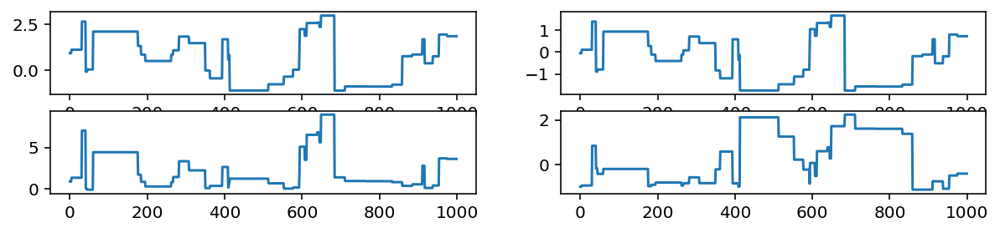

Removed no burn in
26.76570566484757
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.00E-01            0.90            5562
param2           9.59E-01            0.96            5217


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3732  p_{1}
param2        0.2306  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00515
  2      0.18800

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1209   0.3289   0.2297 upper
param1       0.1082   0.1244   0.2990 lower
param2       0.2763   0.7562   0.5391 upper
param2       0.0150   0.0196   0.0211 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

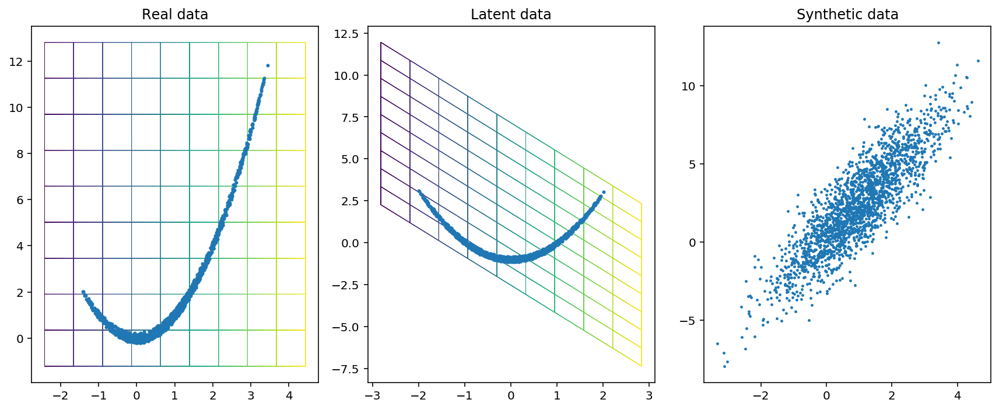

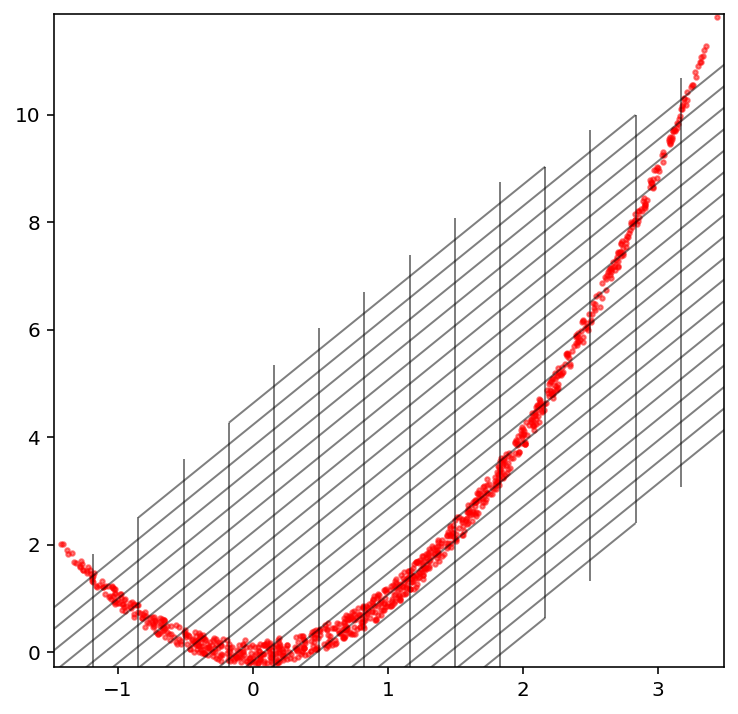

Creating directory for new run logs/test/run380
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


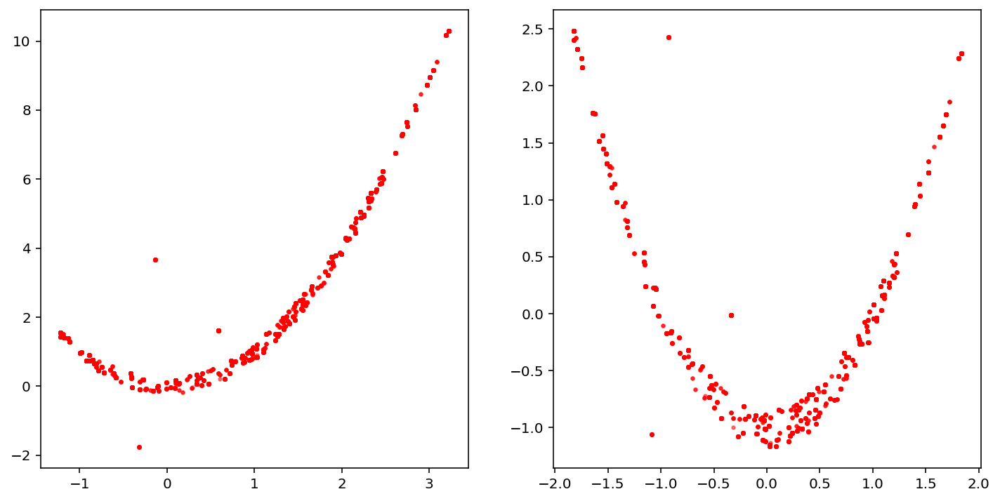

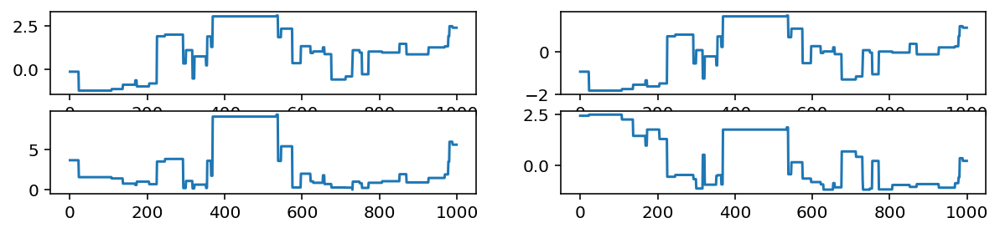

Removed no burn in
35.75516248093833
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.25E-01            0.93            5409
param2           9.59E-01            0.96            5218


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3178  p_{1}
param2        0.2309  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.03782
  2      0.12576

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0806   0.1846   0.1607 upper
param1       0.0208   0.0170   0.1121 lower
param2       0.2440   0.4726   0.4116 upper
param2       0.0123   0.0408   0.0270 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [18]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

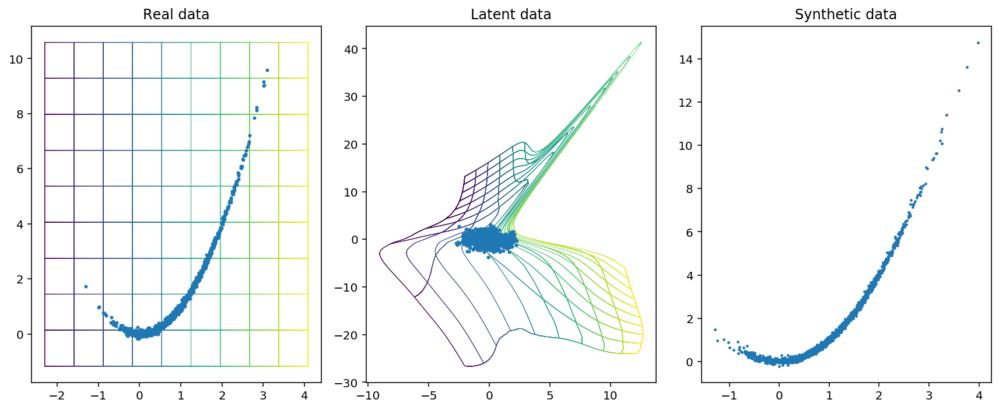

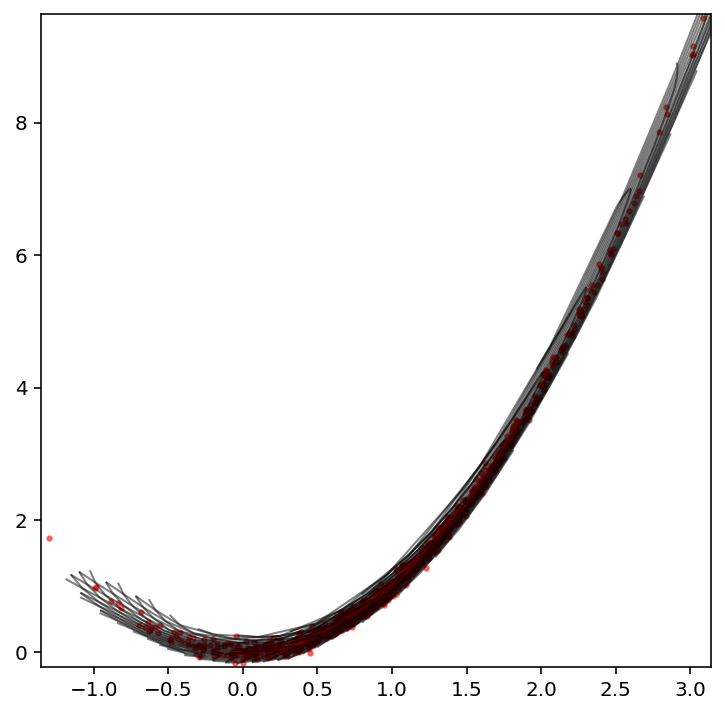

Creating directory for new run logs/test/run381
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


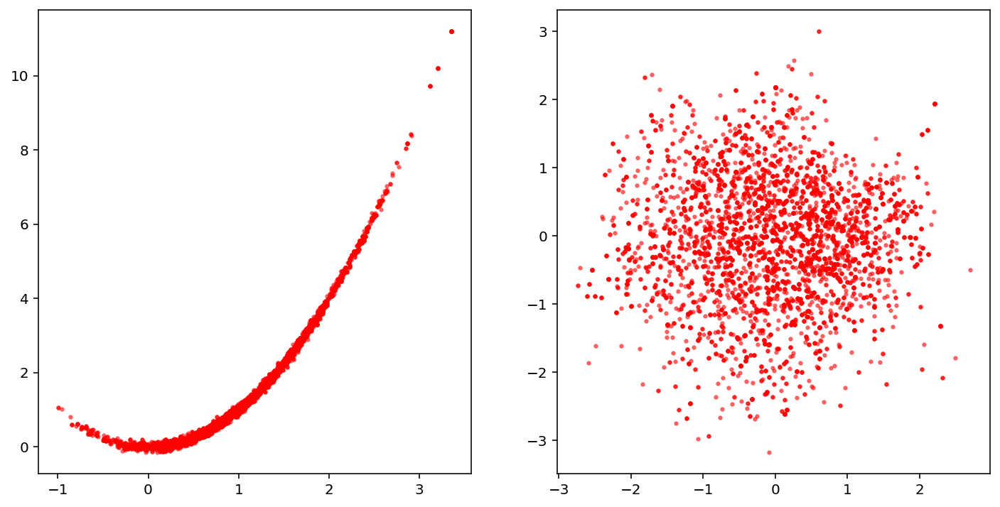

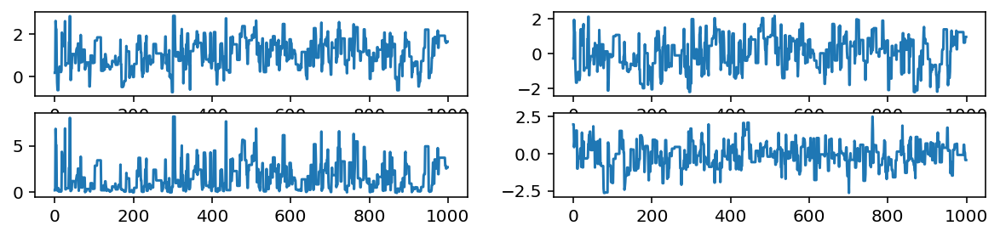

Removed no burn in
590.5367110863652
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.86E+00            7.86             636
param2           7.42E+00            7.42             674


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1129  p_{1}
param2        0.1085  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01170
  2      0.02145

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0778   0.0286   0.0835 upper
param1       0.1607   0.1483   0.1688 lower
param2       0.1702   0.0637   0.1803 upper
param2       0.0049   0.0005   0.0156 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

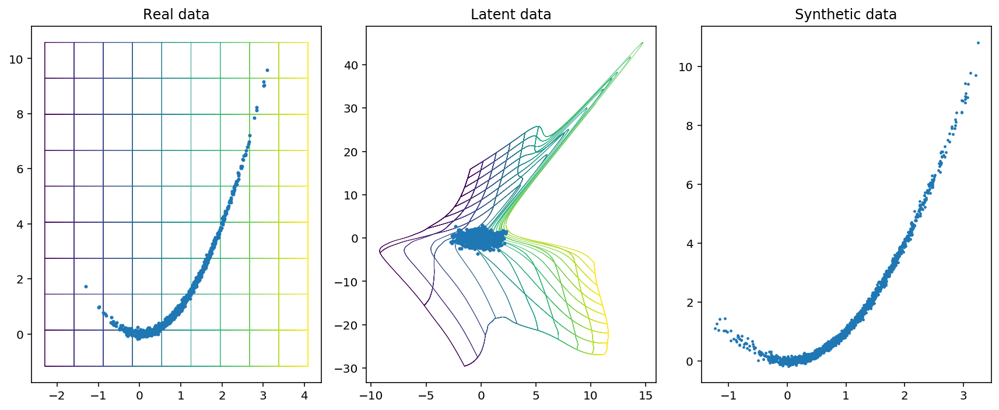

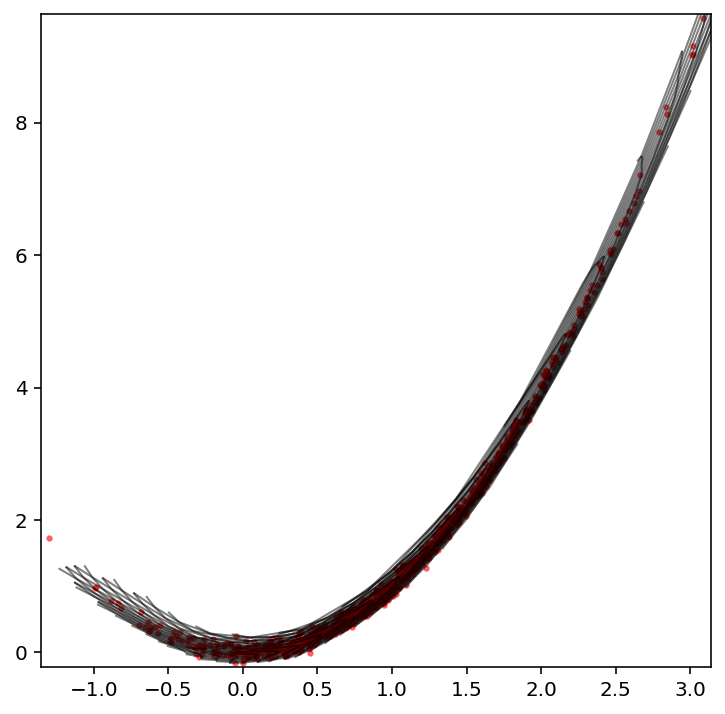

Creating directory for new run logs/test/run382
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


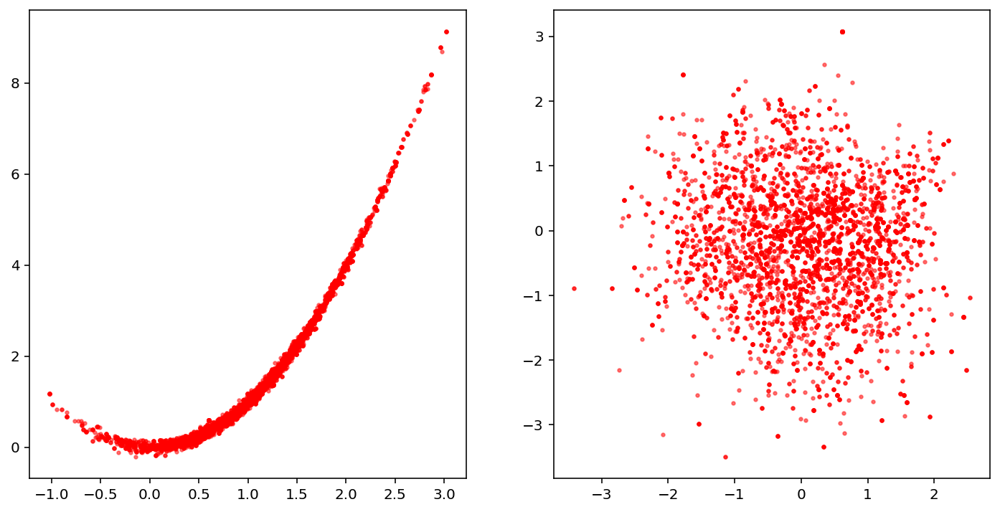

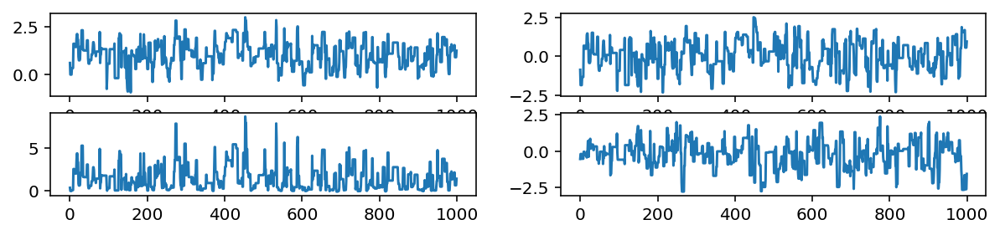

Removed no burn in
650.8942617410534
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.44E+00            7.44             672
param2           6.90E+00            6.90             725


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1009  p_{1}
param2        0.0844  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00101
  2      0.01061

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0802   0.1085   0.0849 upper
param1       0.0292   0.0605   0.0535 lower
param2       0.1596   0.2336   0.1615 upper
param2       0.0025   0.0052   0.0056 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

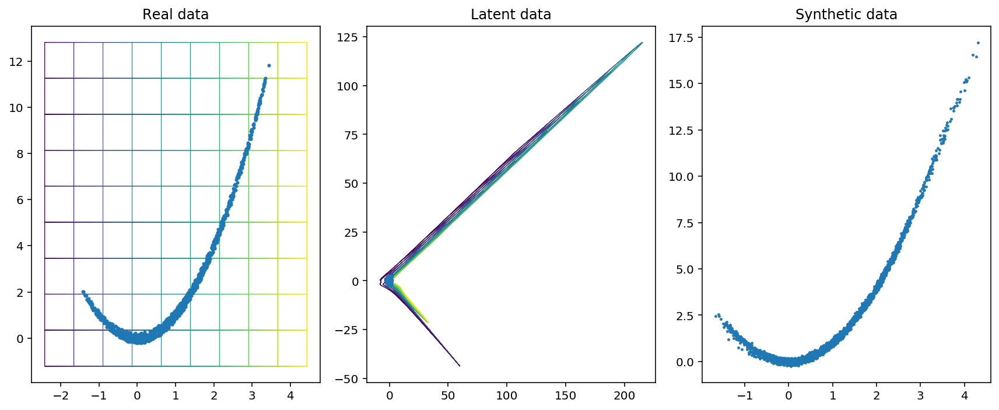

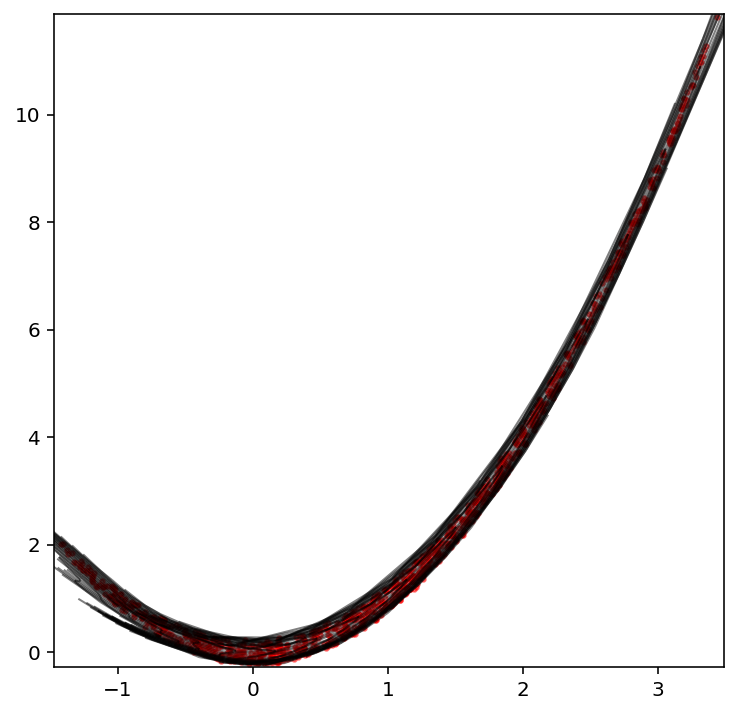

Creating directory for new run logs/test/run383
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


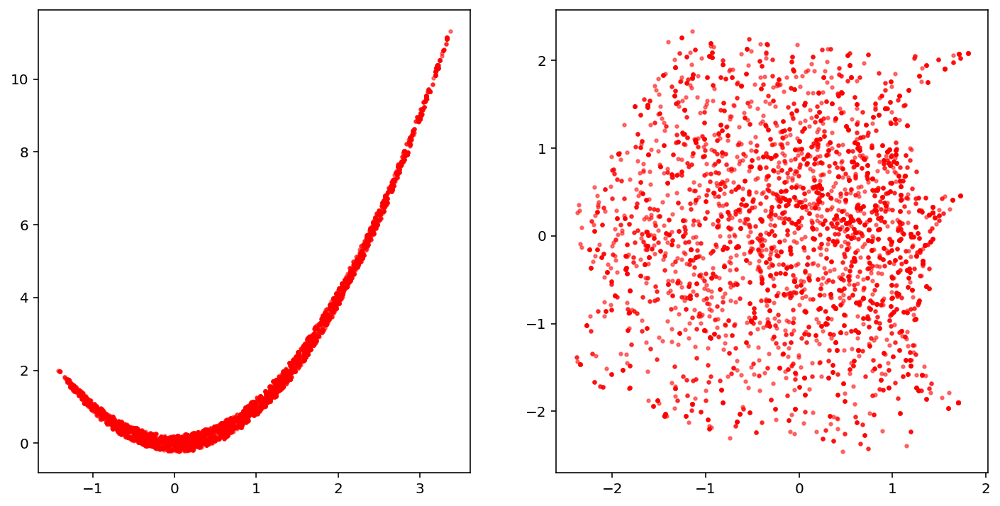

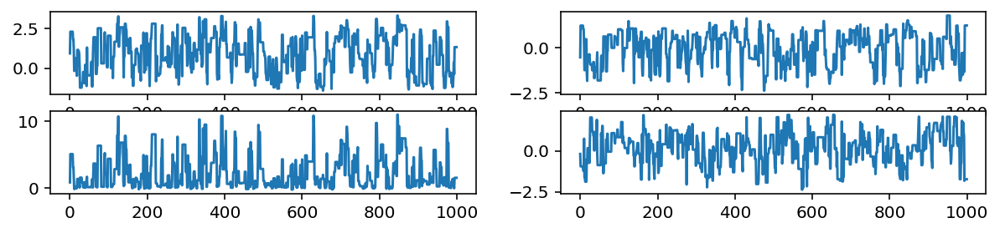

Removed no burn in
604.7442059283069
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.25E+00            8.25             606
param2           8.53E+00            8.53             586


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0538  p_{1}
param2        0.0722  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00262
  2      0.00773

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0532   0.0995   0.0755 upper
param1       0.0382   0.0318   0.0576 lower
param2       0.1517   0.2598   0.1999 upper
param2       0.0013   0.0070   0.0046 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

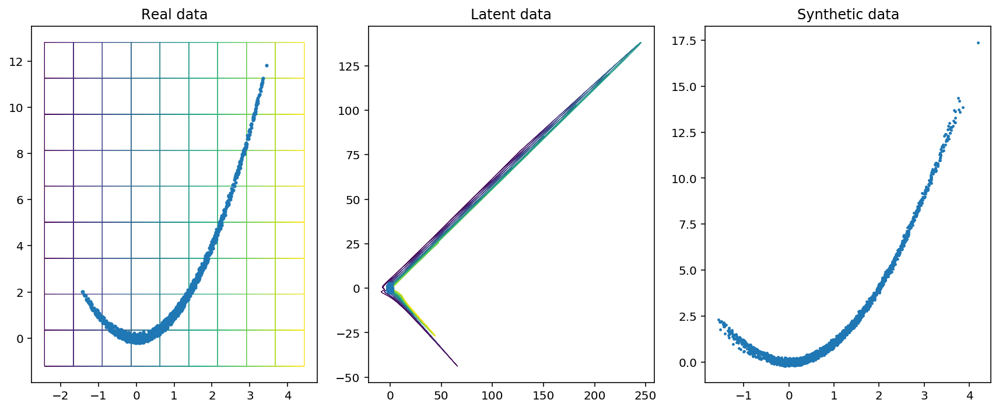

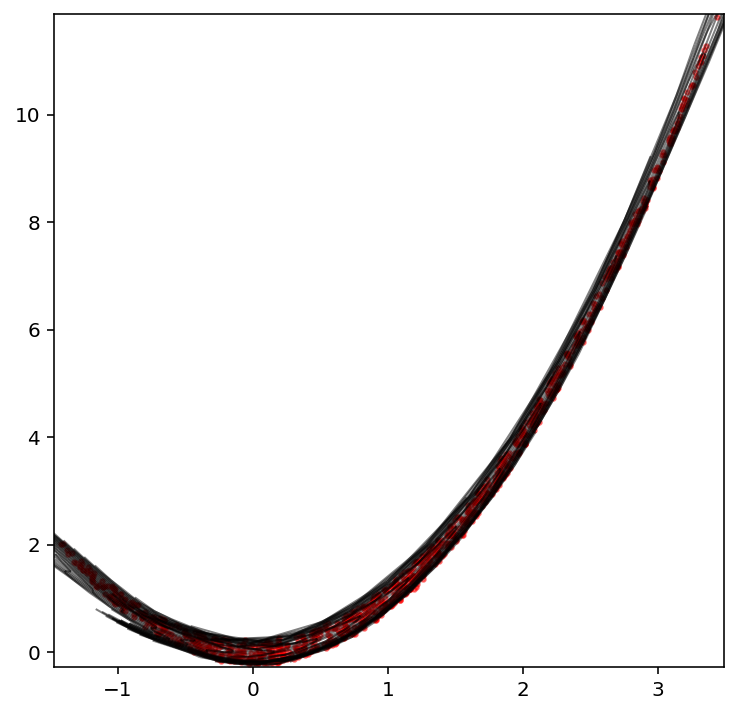

Creating directory for new run logs/test/run384
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


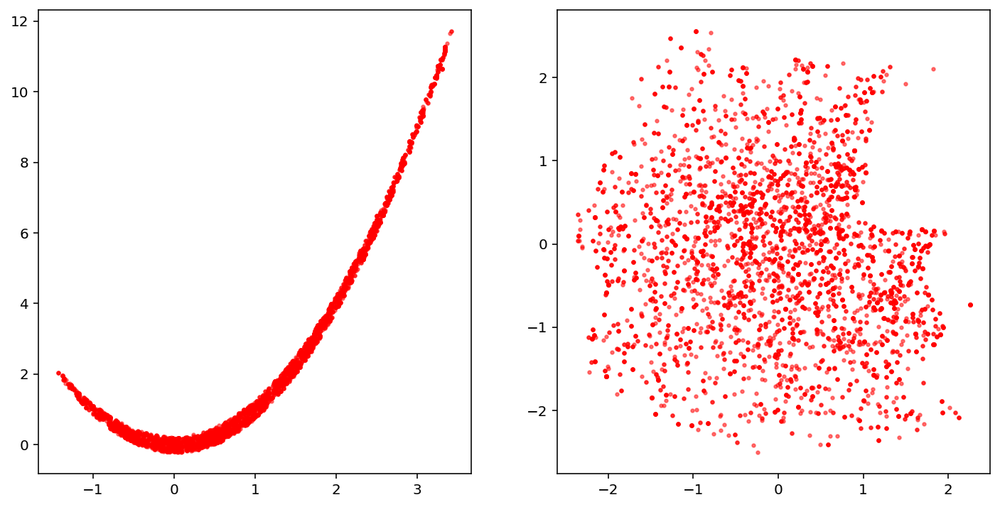

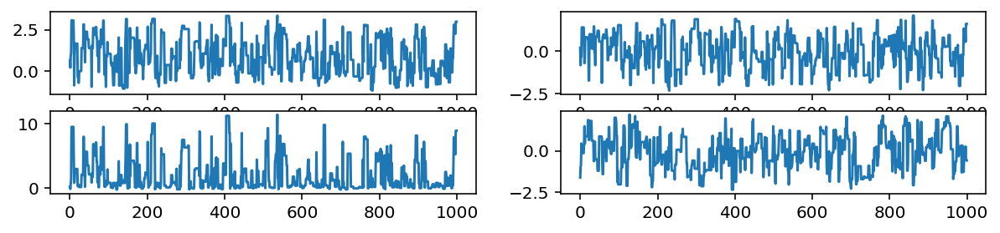

Removed no burn in
605.5596746344371
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.66E+00            7.66             653
param2           7.00E+00            7.00             714


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0861  p_{1}
param2        0.0794  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00500
  2      0.00756

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0279   0.0239   0.0290 upper
param1       0.0318   0.0462   0.0505 lower
param2       0.0724   0.0696   0.0632 upper
param2       0.0067   0.0058   0.0069 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [19]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

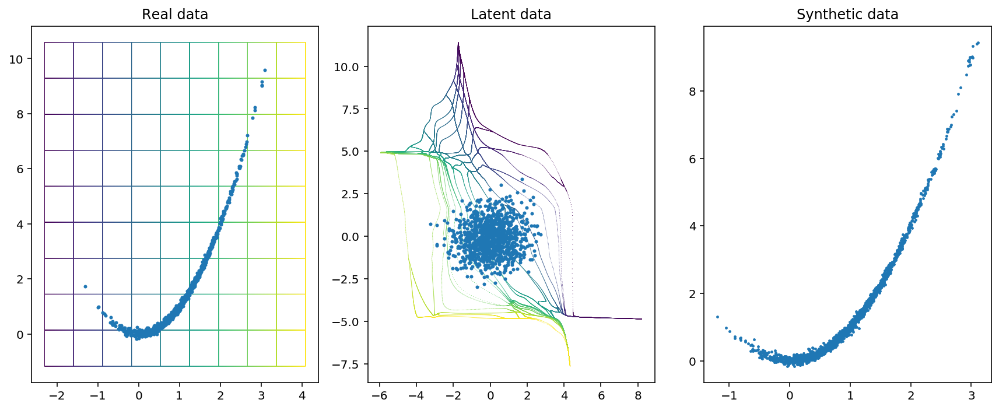

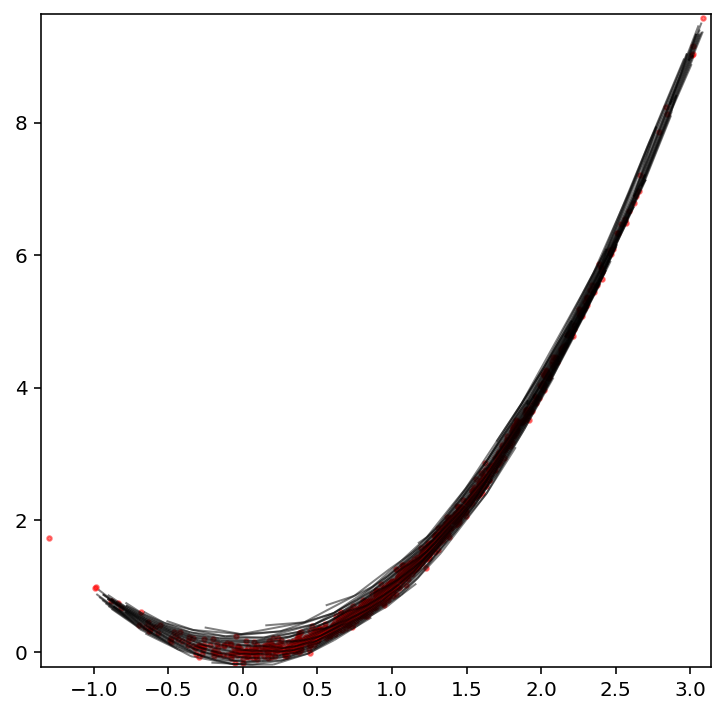

Creating directory for new run logs/test/run385
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


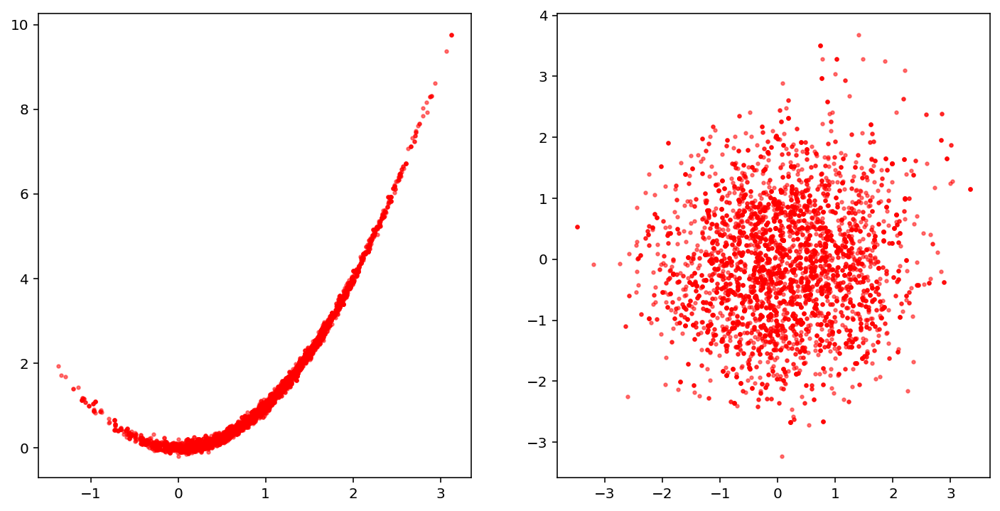

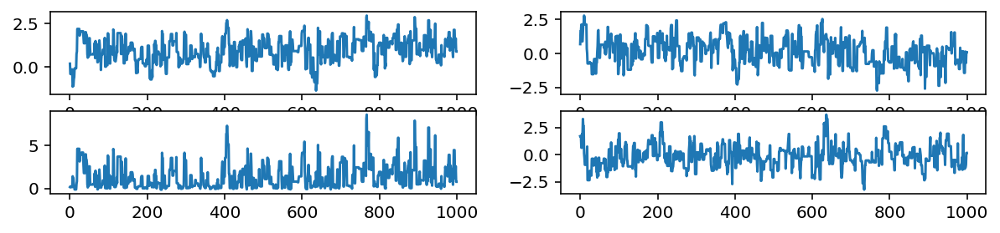

Removed no burn in
623.0376418764984
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.92E+00            7.92             631
param2           7.10E+00            7.10             705


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0726  p_{1}
param2        0.0876  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00526
  2      0.01570

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0940   0.1609   0.1201 upper
param1       0.0171   0.1054   0.1963 lower
param2       0.1751   0.3498   0.2842 upper
param2       0.0010   0.0026   0.0131 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

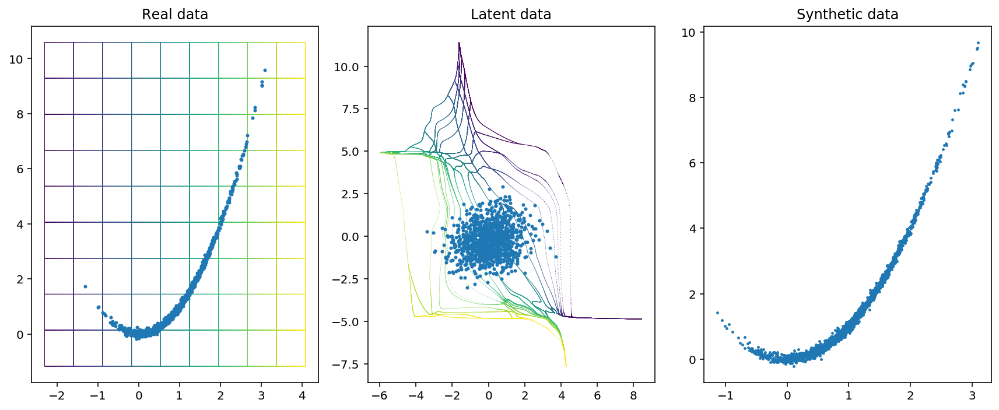

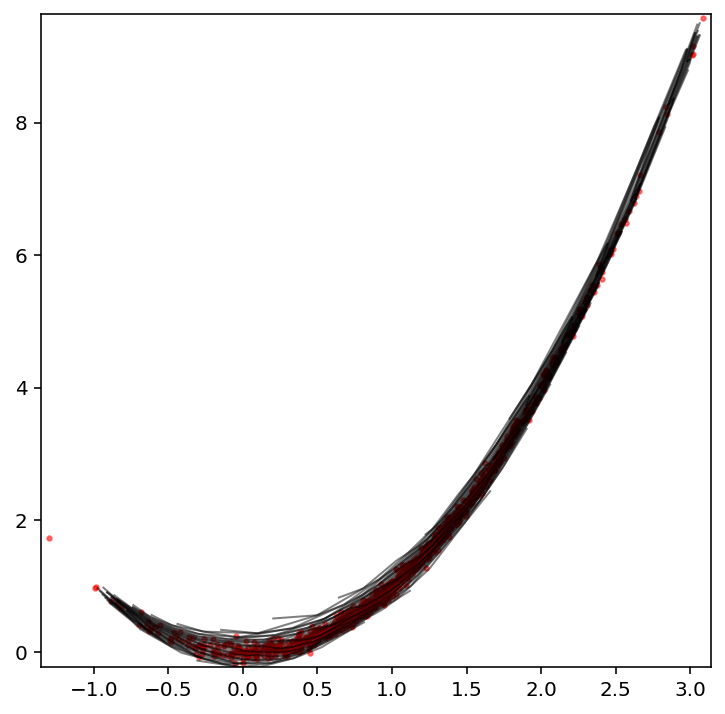

Creating directory for new run logs/test/run386
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


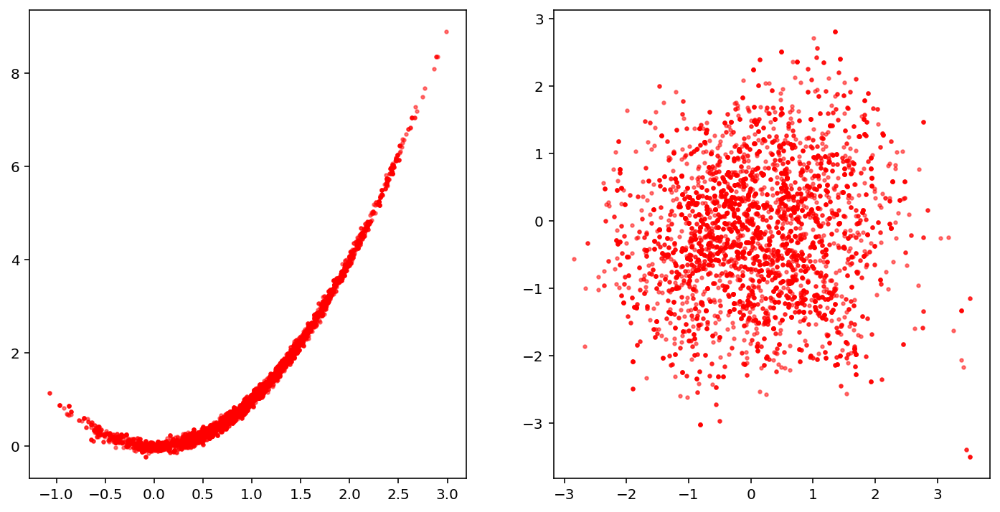

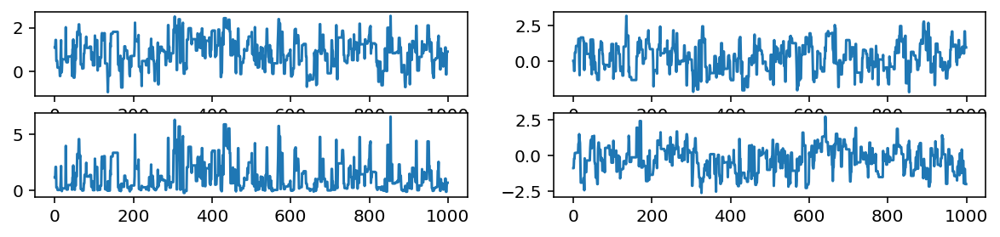

Removed no burn in
660.9799734310297
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.44E+00            7.44             672
param2           6.72E+00            6.72             744


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0909  p_{1}
param2        0.1096  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00118
  2      0.01247

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1042   0.0970   0.1357 upper
param1       0.0274   0.0438   0.1058 lower
param2       0.2145   0.2738   0.2686 upper
param2       0.0093   0.0031   0.0106 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

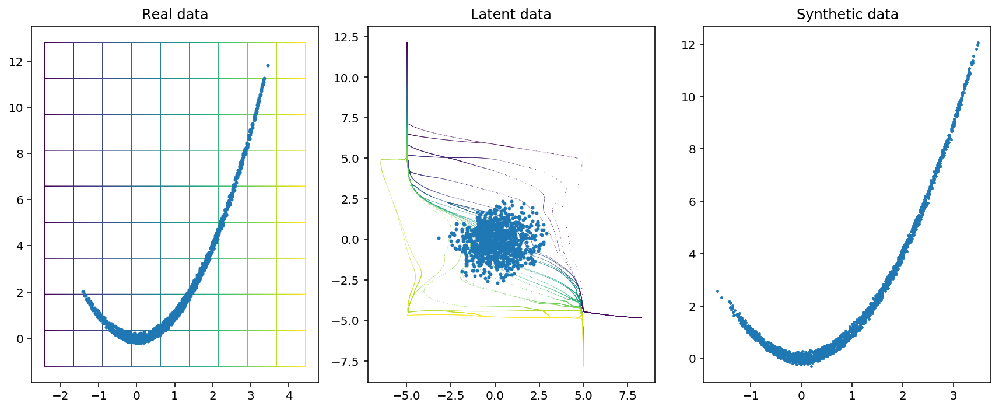

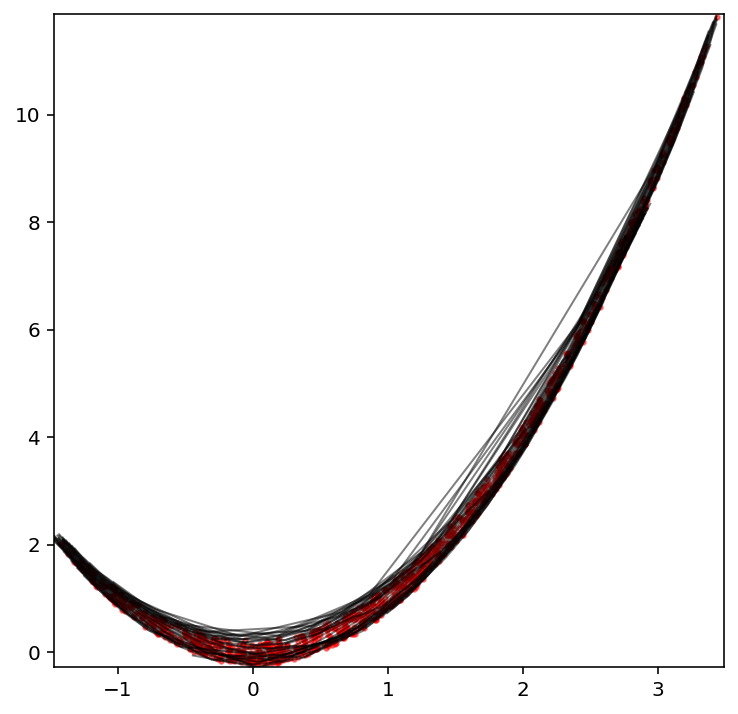

Creating directory for new run logs/test/run387
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


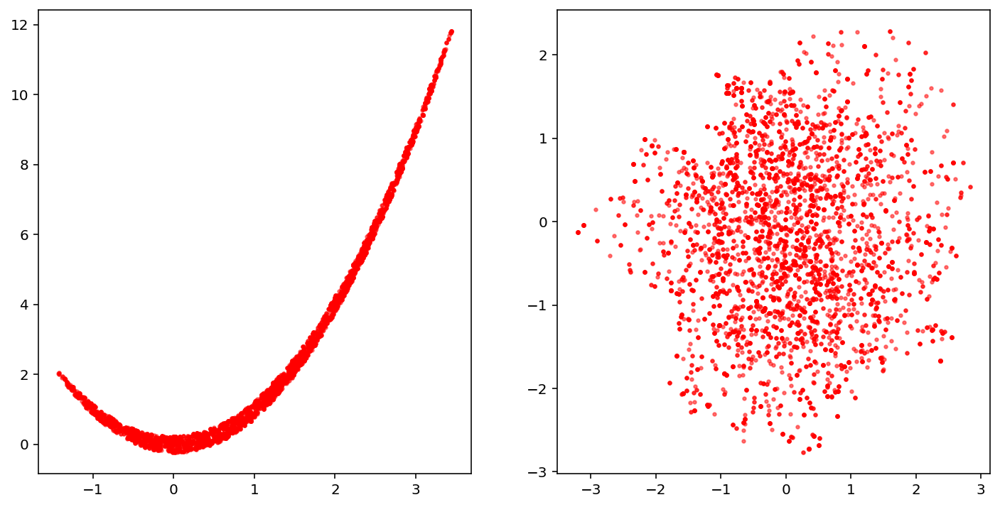

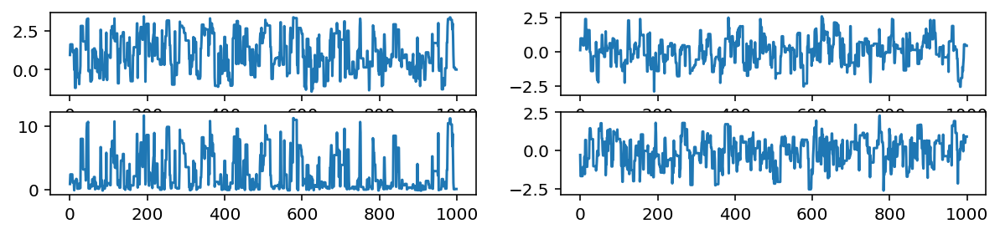

Removed no burn in
652.5039636434024
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.67E+00            7.67             652
param2           7.62E+00            7.62             657


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0320  p_{1}
param2        0.0462  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00098
  2      0.00728

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0185   0.0195   0.0416 upper
param1       0.0187   0.0353   0.0153 lower
param2       0.0678   0.0685   0.1029 upper
param2       0.0003   0.0037   0.0026 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

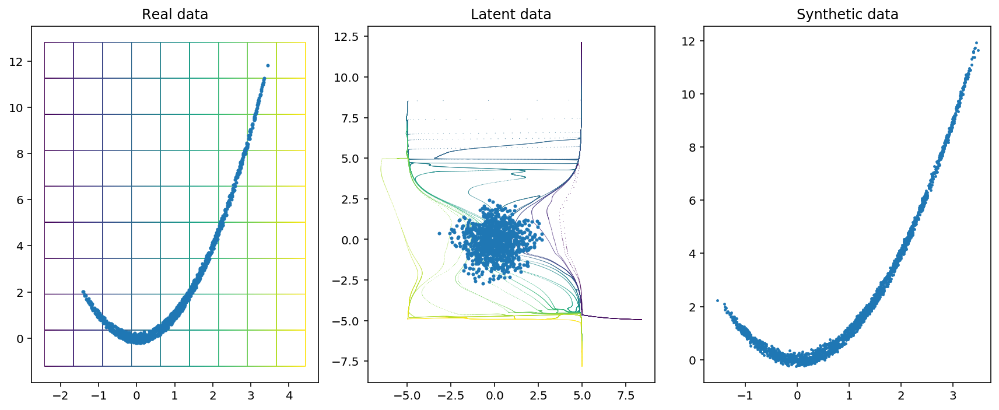

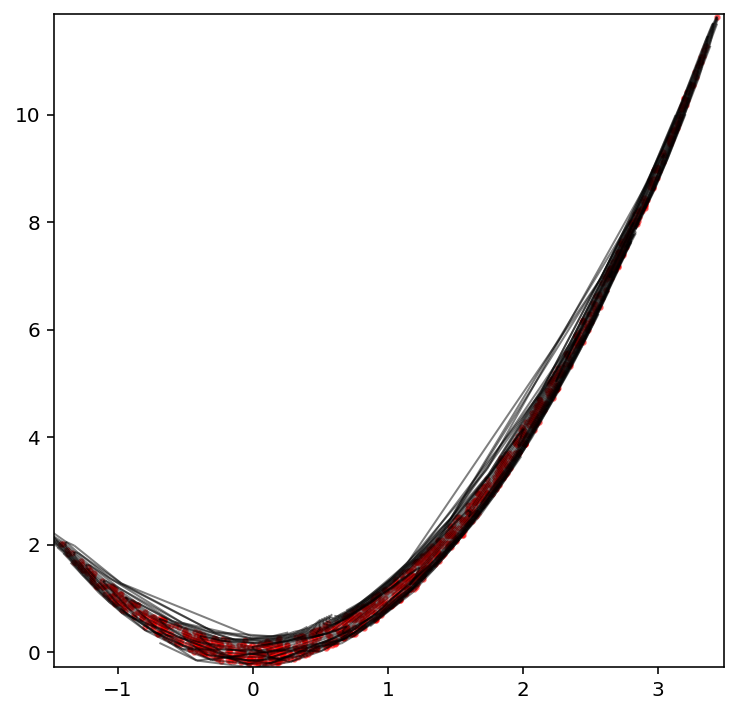

Creating directory for new run logs/test/run388
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


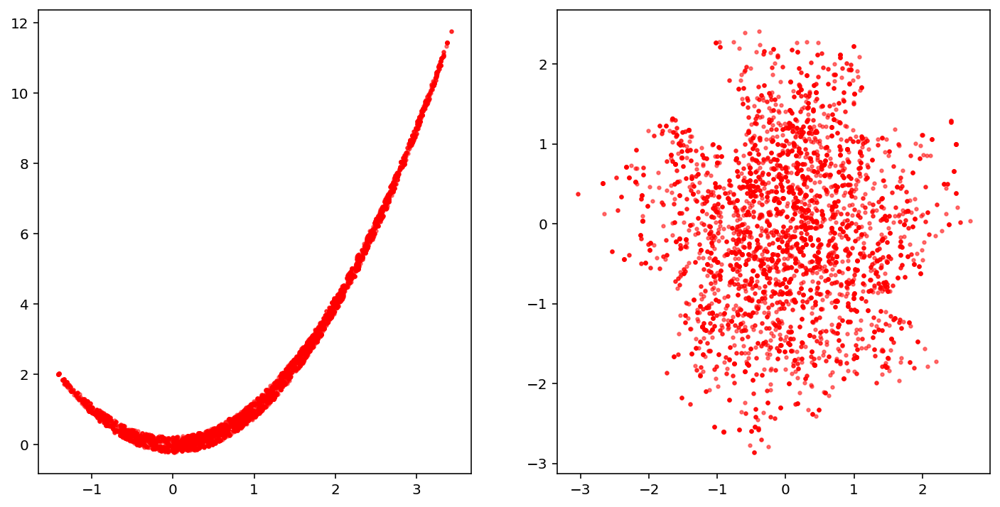

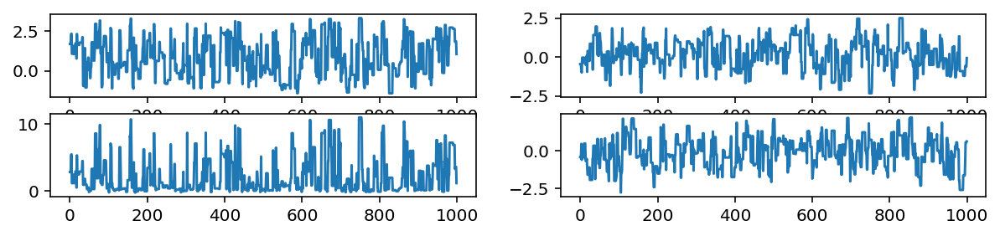

Removed no burn in
739.7690595560567
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.25E+00            6.25             800
param2           6.40E+00            6.40             781


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1405  p_{1}
param2        0.1474  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00389
  2      0.02219

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0619   0.0430   0.0507 upper
param1       0.0003   0.0094   0.0222 lower
param2       0.1402   0.0866   0.1189 upper
param2       0.0016   0.0013   0.0028 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [20]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [21]:
prior = UniformPrior(2, -15, 15)
like = Eggbox(2)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.8741] validation loss [0.8460]
[nnest.trainer] [INFO] Epoch [100] train loss [0.3413] validation loss [0.3317]
[nnest.trainer] [INFO] Epoch [200] train loss [0.1778] validation loss [0.1738]
[nnest.trainer] [INFO] Epoch [300] train loss [0.1173] validation loss [0.1153]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0918] validation loss [0.0906]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0805] validation loss [0.0797]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0755] validation loss [0.0750]
[nnest.trainer] [INFO] Epoch [700] train loss [0.0736] validation loss [0.0733]
[nnest.trainer] [INFO] Epoch [800] tra

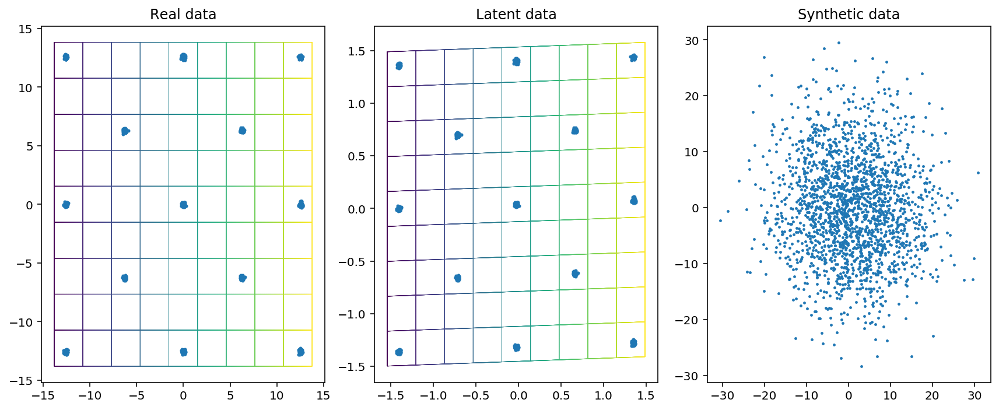

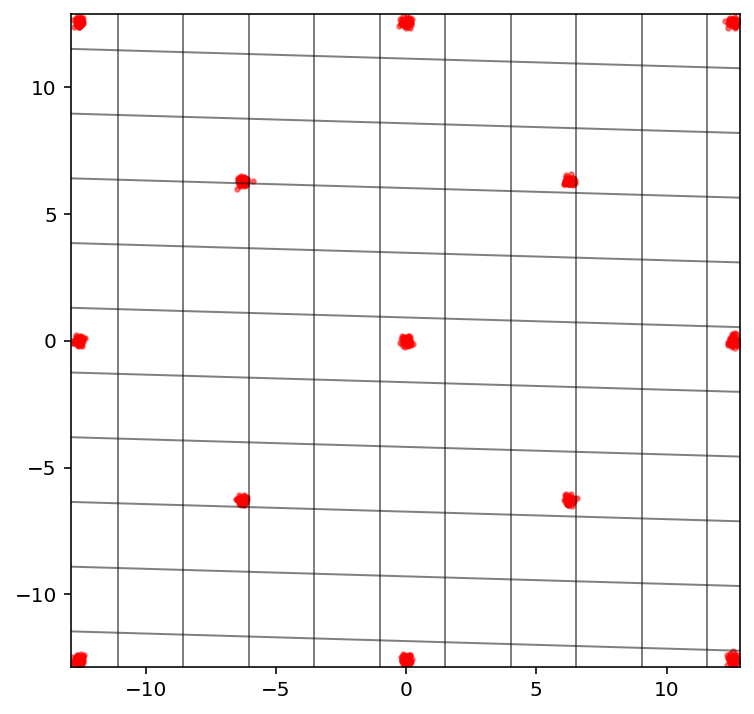

Creating directory for new run logs/test/run389
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


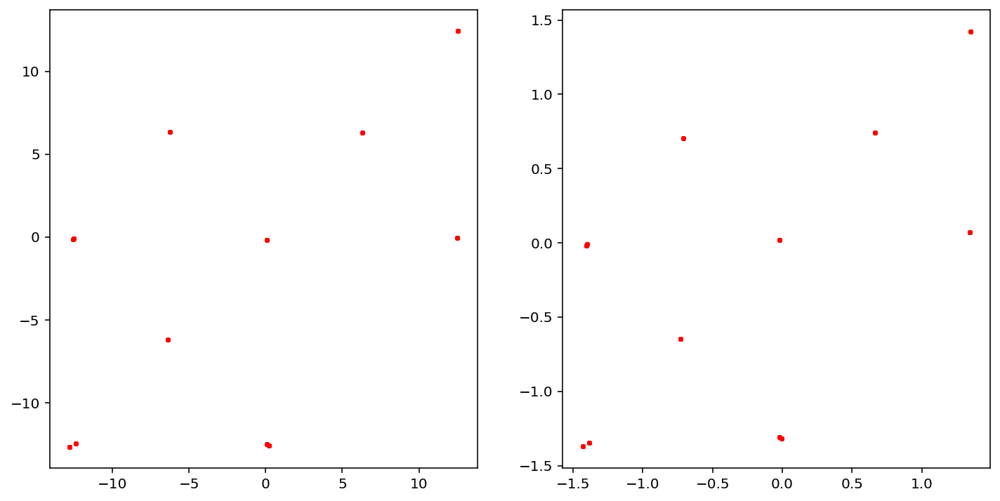

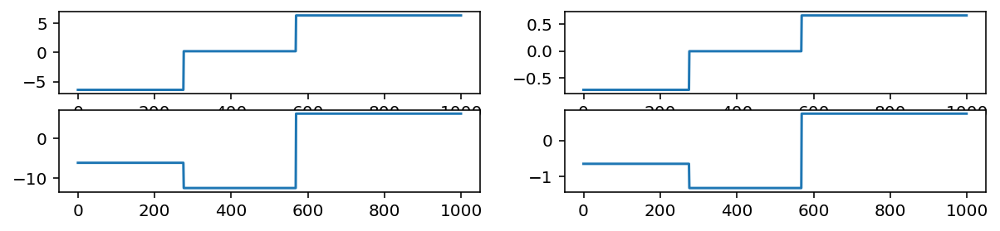

Removed no burn in
14.170219543627747
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.54E-01            0.65            7650
param2           4.17E-01            0.42           12004


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.8129  p_{1}
param2        1.3222  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.64200
  2      2.93397

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       1.0798   0.9854   1.1451 upper
param1       0.0204   0.0338   0.0326 lower
param2       0.9958   1.6615   1.6027 upper
param2       0.0142   0.0164   0.7008 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

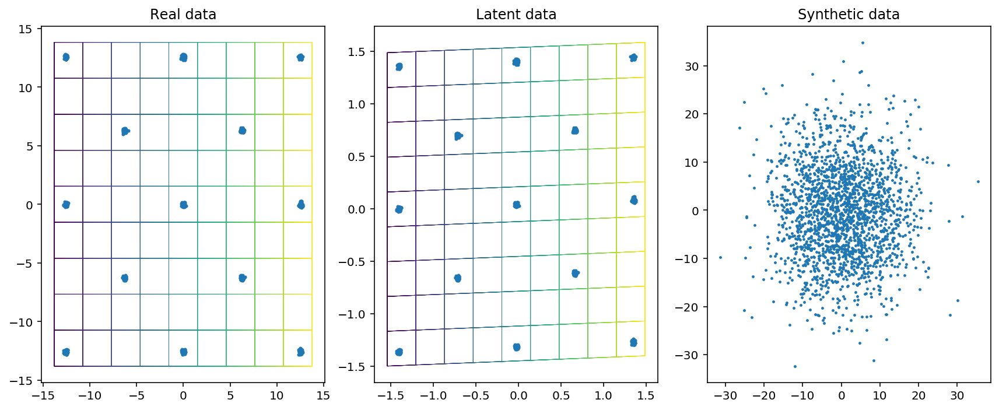

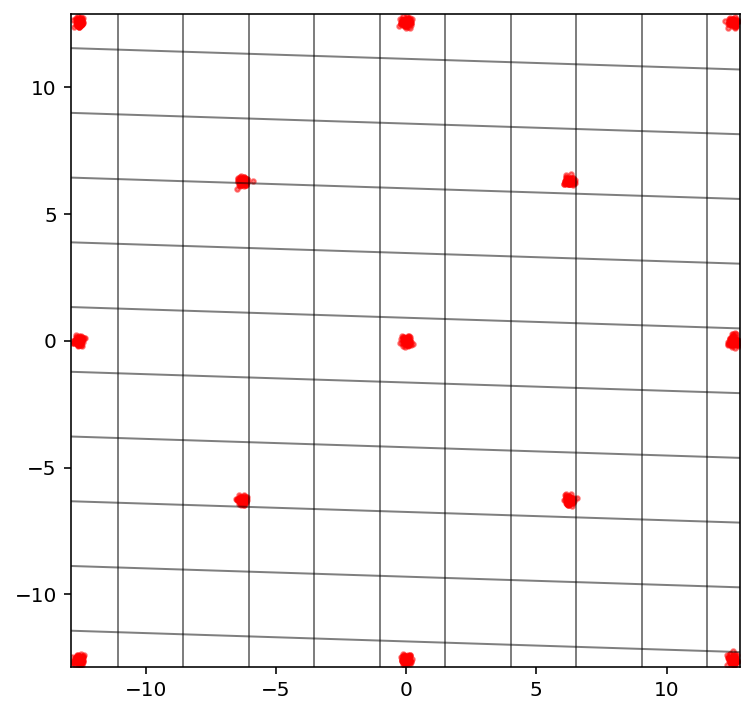

Creating directory for new run logs/test/run390
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:343: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


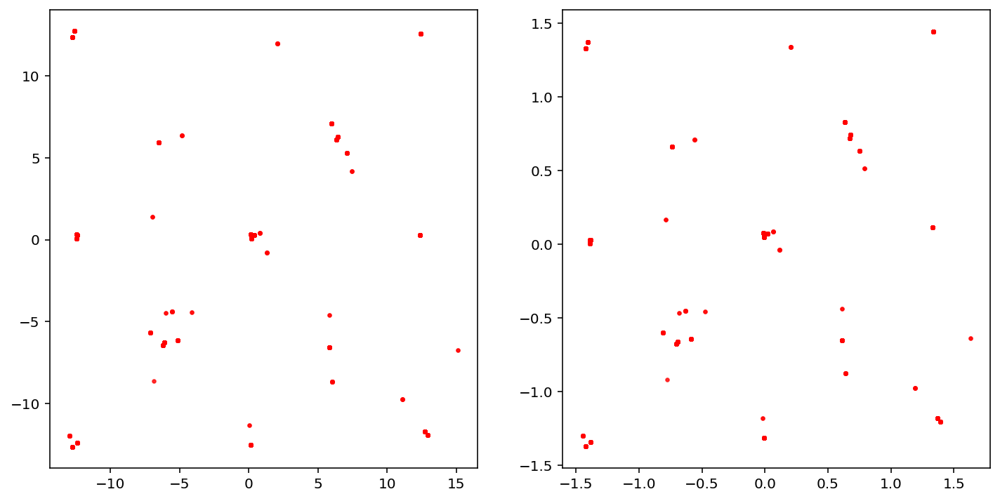

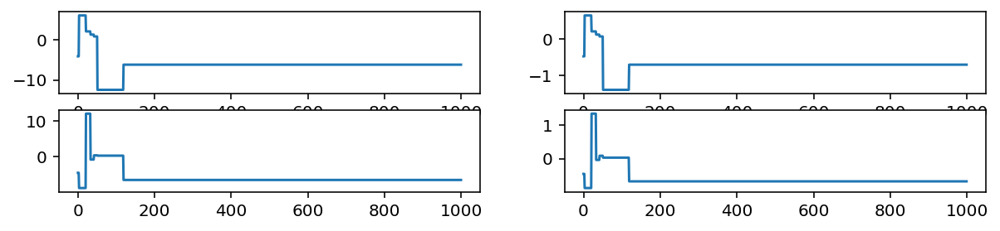

Removed no burn in
5005.000052932103
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           4.80E-01            0.48           10424
param2           7.55E-01            0.75            6629


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.1635  p_{1}
param2        0.6369  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.40293
  2      1.40809

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.4935   0.4267   0.4687 upper
param1       0.0018   0.0105   0.0185 lower
param2       0.0138   0.0314   0.4722 upper
param2       0.0098   0.4580   0.3951 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

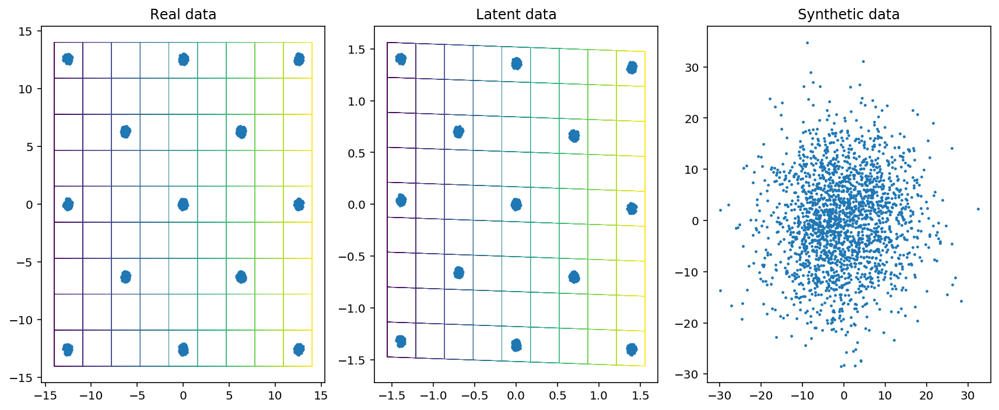

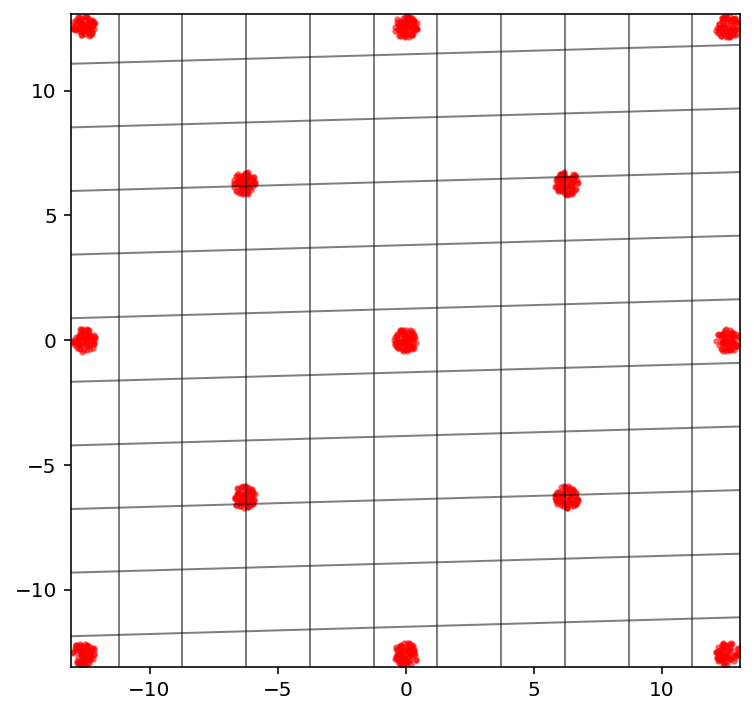

Creating directory for new run logs/test/run391
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


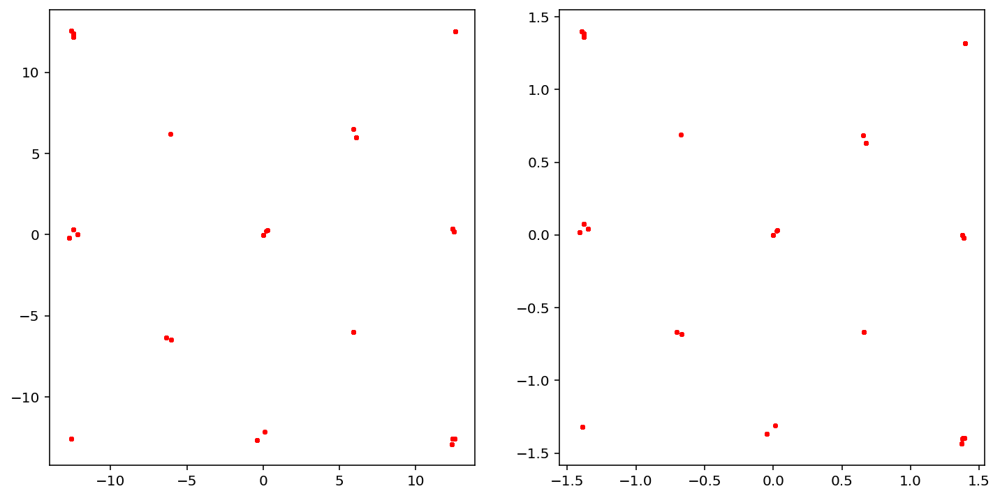

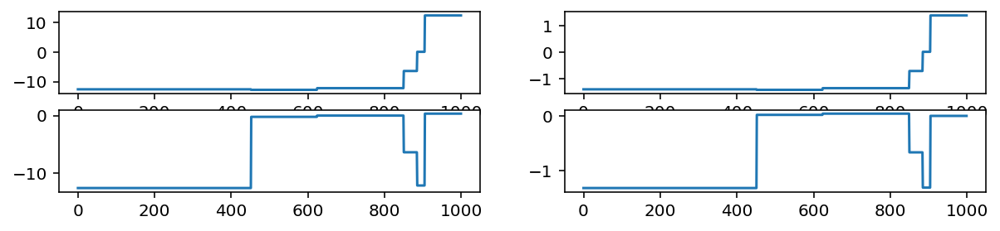

Removed no burn in
5005.000007804031
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.69E-01            0.37           13564
param2           6.31E-01            0.63            7935


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.4621  p_{1}
param2        0.8555  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.55364
  2      3.69847

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0095   0.0081   0.0112 upper
param1       0.0182   0.9185   0.7955 lower
param2       0.0019   0.0073   0.6082 upper
param2       0.0000   0.0277   0.0240 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

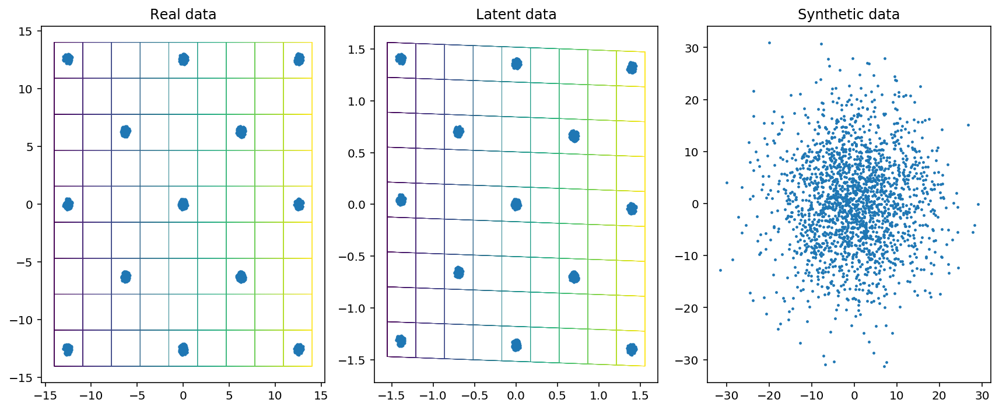

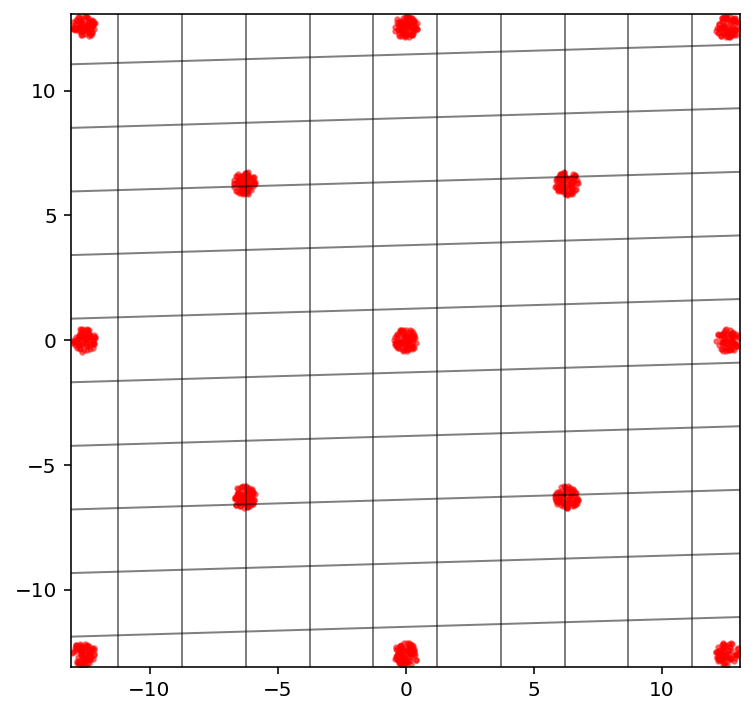

Creating directory for new run logs/test/run392
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


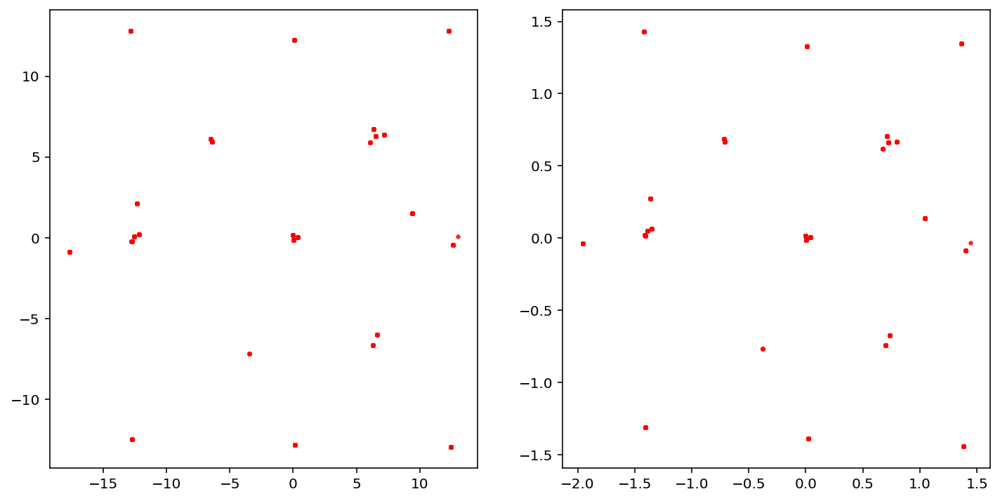

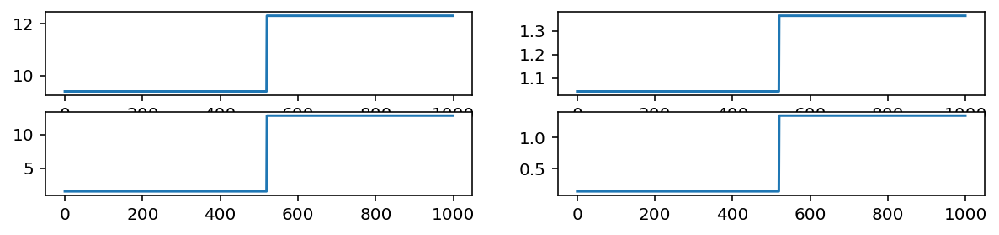

Removed no burn in
5004.99995050081
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           2.07E-01            0.21           24213
param2           5.86E-01            0.59            8544


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        2.1903  p_{1}
param2        0.9402  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.88405
  2      5.72282

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.4098   0.3346   0.6612 upper
param1       0.3252   1.3900   1.2255 lower
param2       0.0001   0.4986   0.9990 upper
param2       0.0342   1.0116   1.2480 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enough

In [22]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

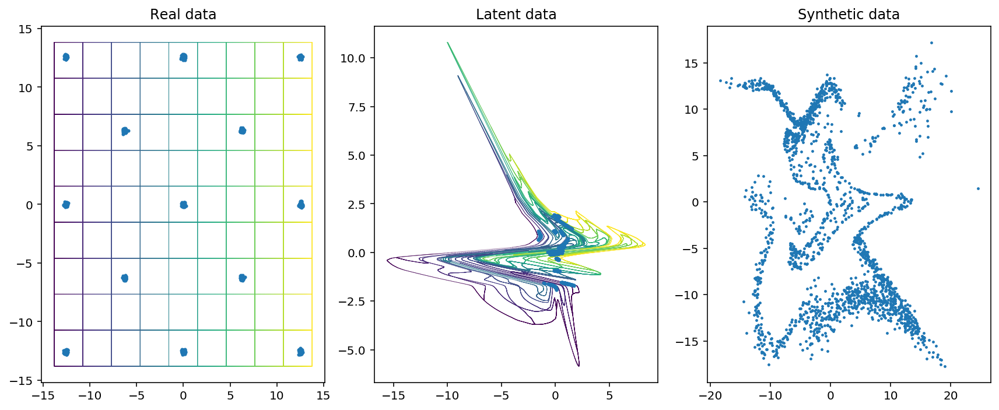

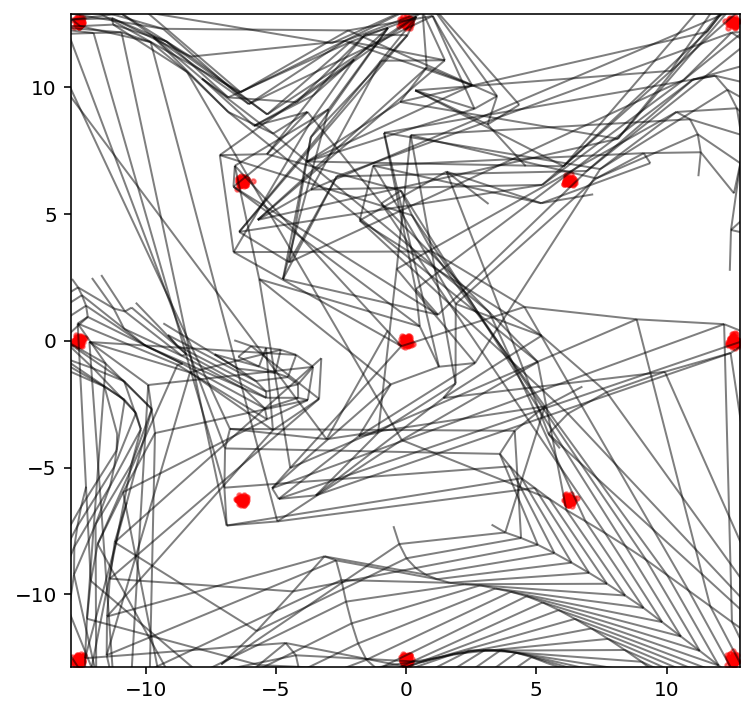

Creating directory for new run logs/test/run393
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


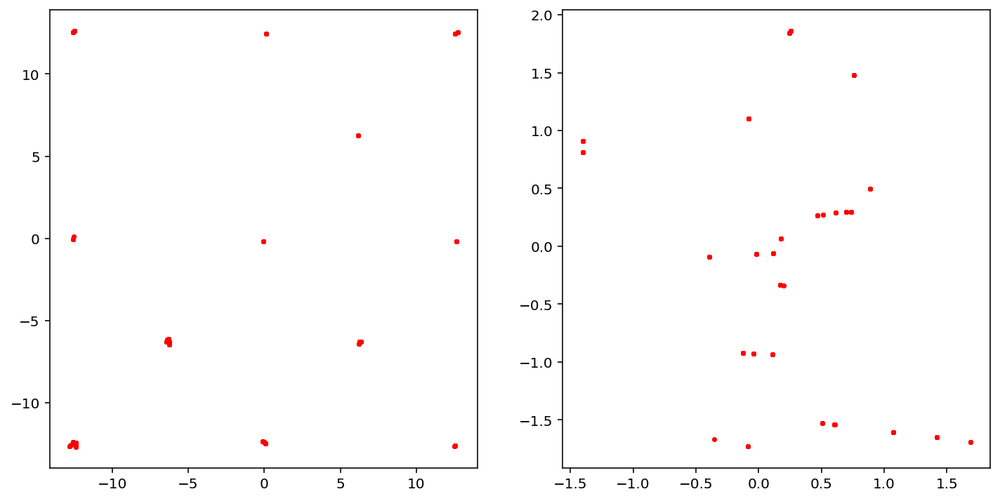

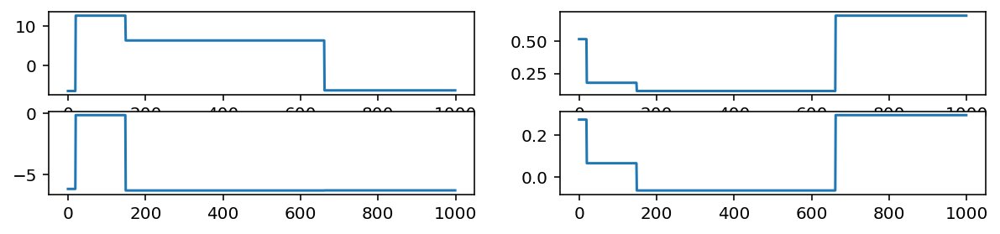

Removed no burn in
19.956057264869262
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.04E-01            0.70            7105
param2           7.83E-01            0.78            6395


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.7243  p_{1}
param2        0.5893  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.27161
  2      0.57779

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0143   0.4200   0.3639 upper
param1       0.0096   0.0123   0.0127 lower
param2       0.0000   0.7868   0.7611 upper
param2       0.0024   0.0063   0.0059 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

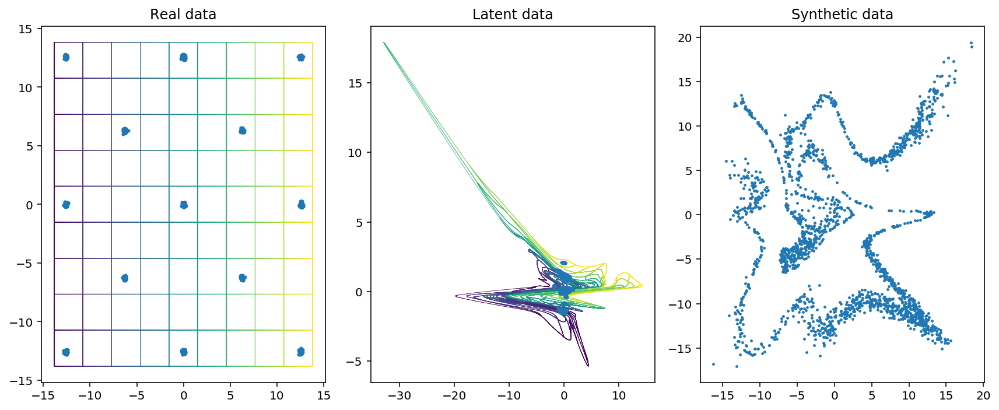

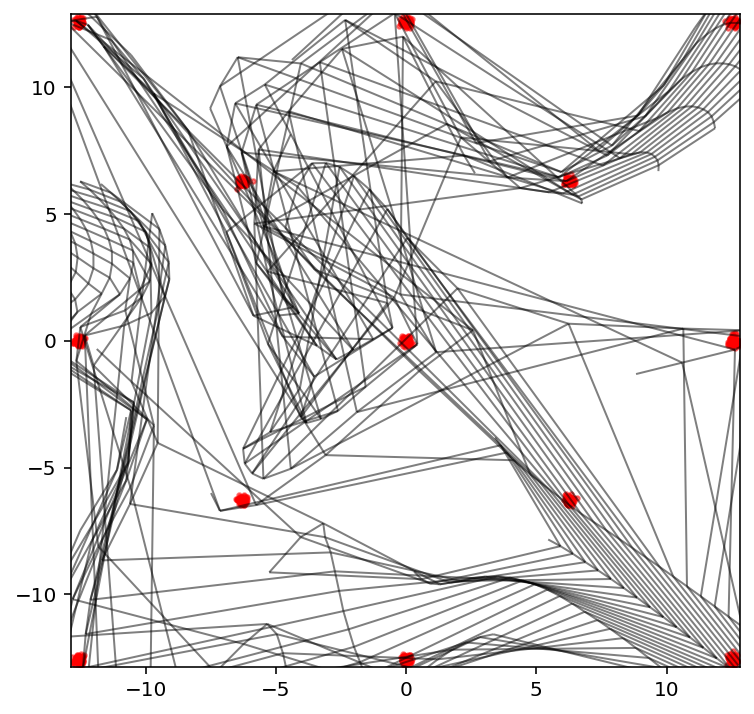

Creating directory for new run logs/test/run394
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


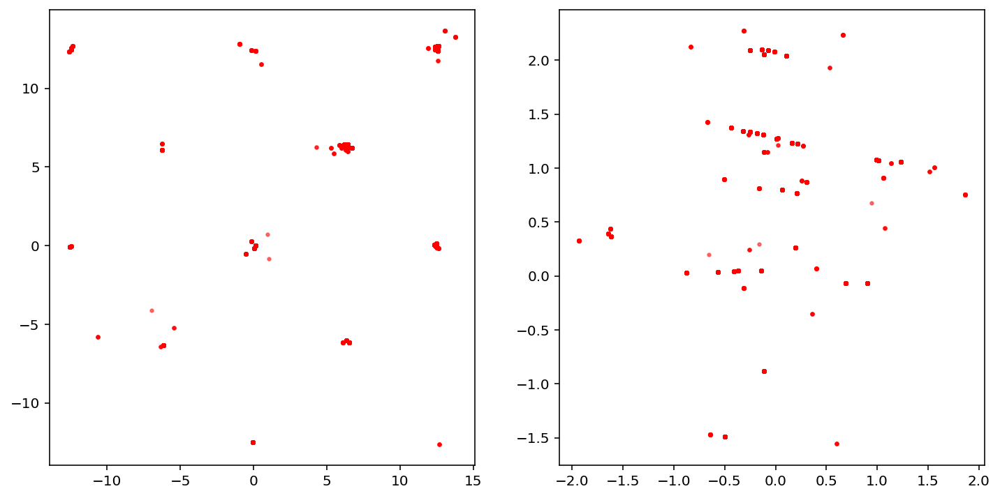

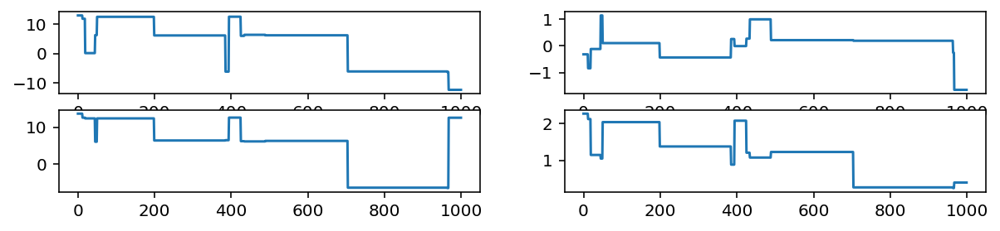

Removed no burn in
5004.999972619785
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.42E-01            0.84            5944
param2           8.88E-01            0.89            5635


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.4844  p_{1}
param2        0.3969  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.03965
  2      0.31476

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0038   0.0044   0.0075 upper
param1       0.0086   0.0071   0.8327 lower
param2       0.0050   0.0082   0.0674 upper
param2       0.6495   0.7411   0.7953 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

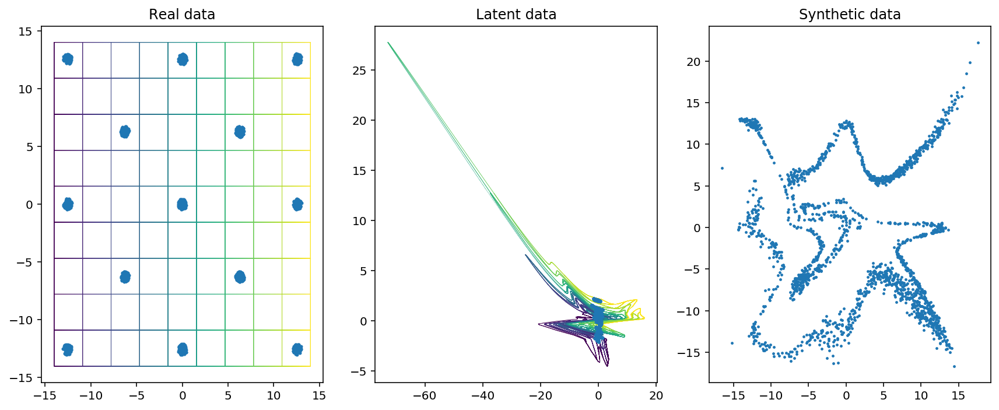

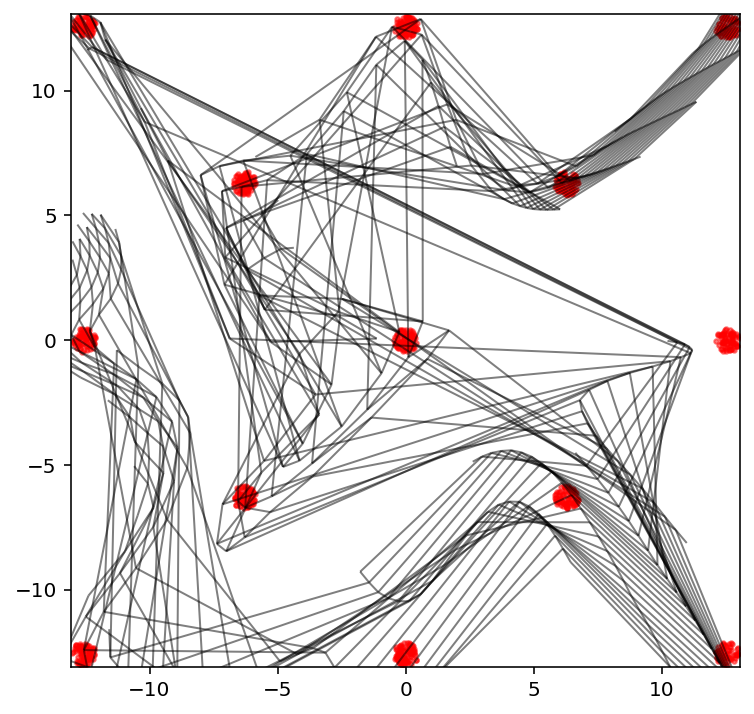

Creating directory for new run logs/test/run395
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


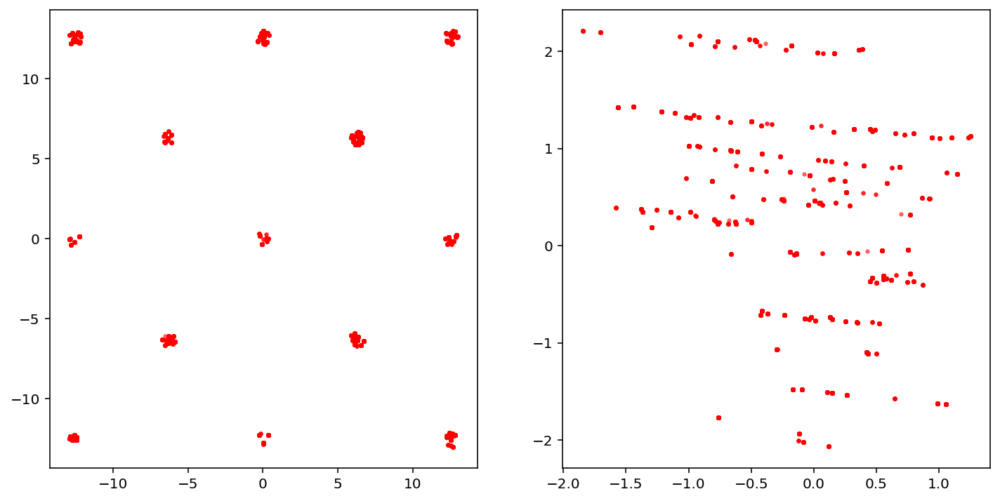

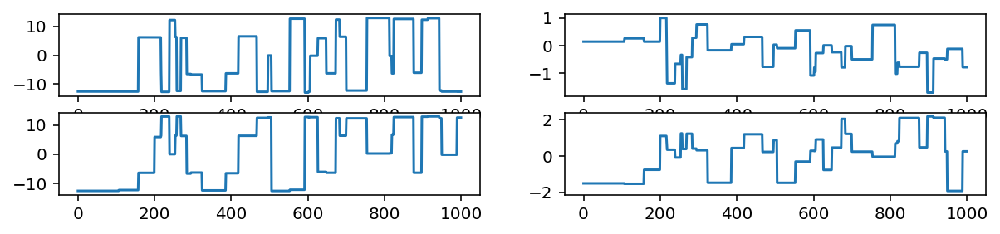

Removed no burn in
96.24828290360723
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           4.52E+01           45.17             110
param2           9.17E-01            0.92            5459


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2657  p_{1}
param2        0.3370  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.06901
  2      0.11437

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0032   0.0143   0.0126 upper
param1       0.0319   0.0264   0.0274 lower
param2       0.0012   0.0036   0.0080 upper
param2       0.0124   0.0153   0.0144 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

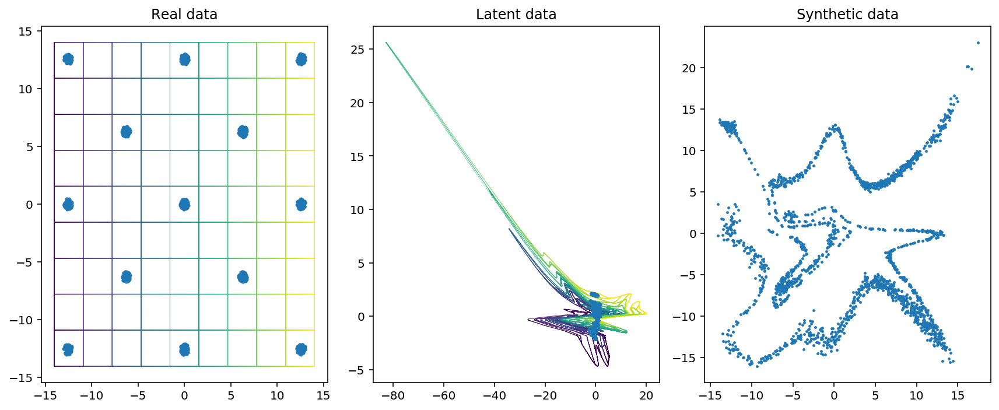

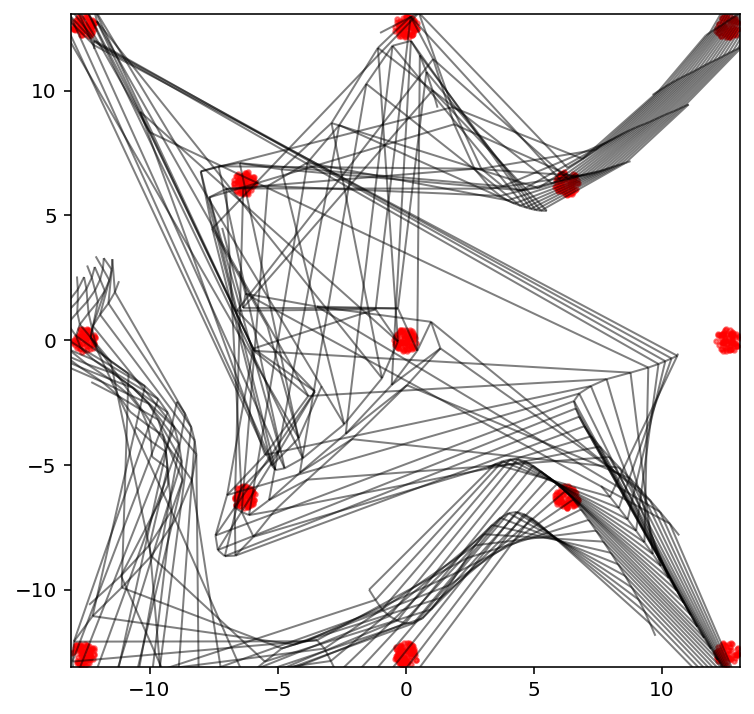

Creating directory for new run logs/test/run396
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


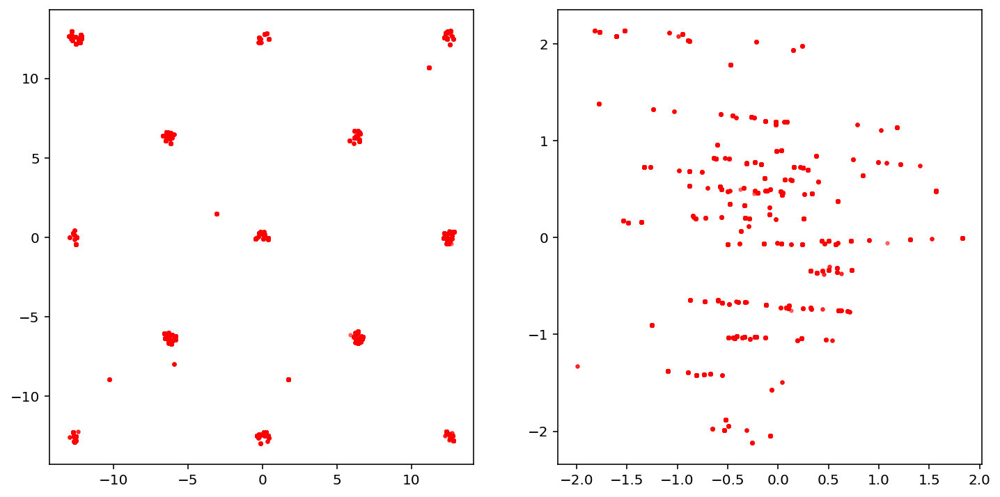

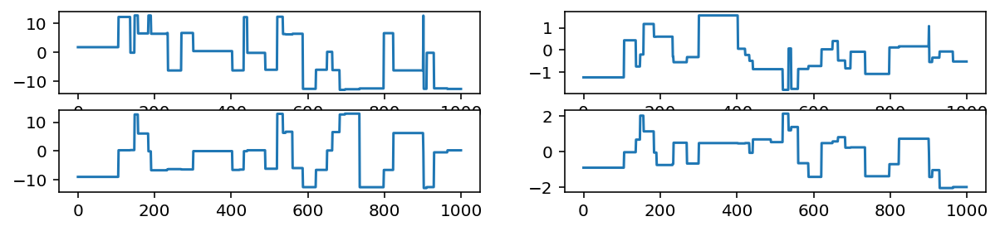

Removed no burn in
69.95118903612416
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.18E+01           51.80              96
param2           4.89E+01           48.87             102


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3443  p_{1}
param2        0.3598  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.06747
  2      0.17464

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0129   0.0086   0.0135 upper
param1       0.0010   0.0041   0.0104 lower
param2       0.0090   0.0064   0.0069 upper
param2       0.0188   0.0155   0.0200 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [23]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

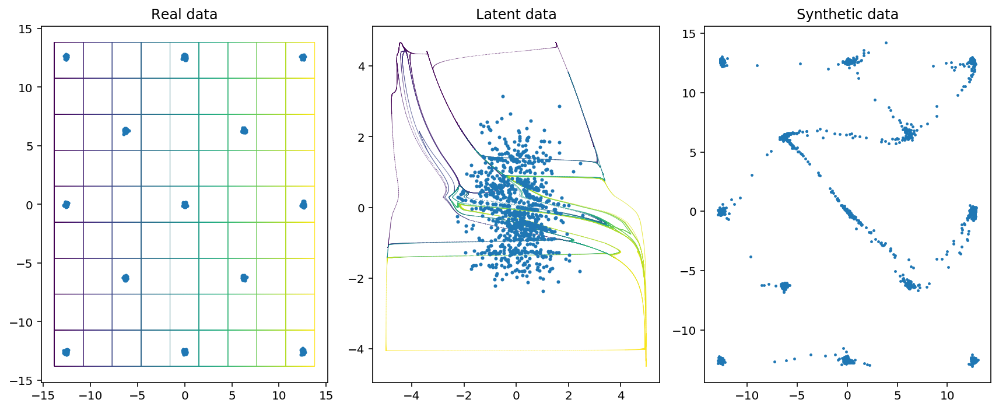

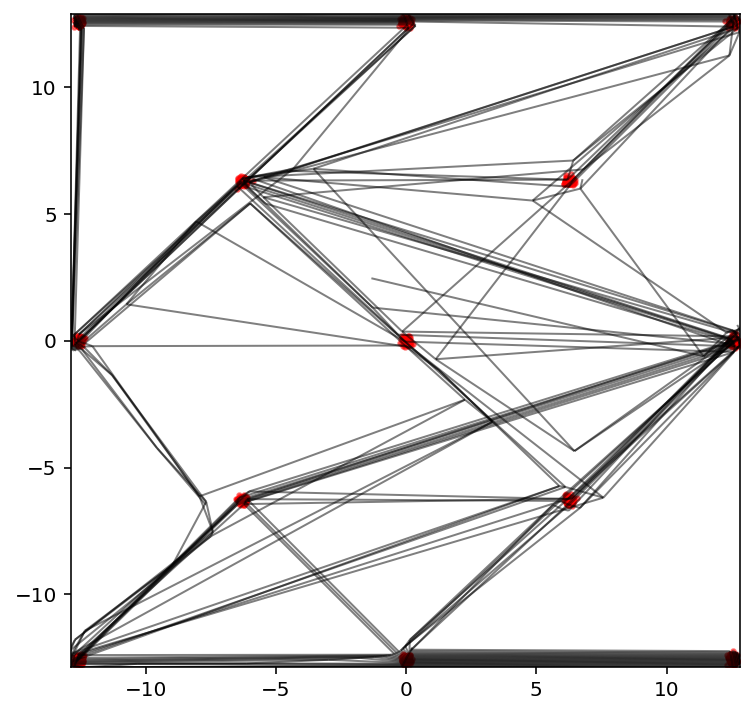

Creating directory for new run logs/test/run397
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


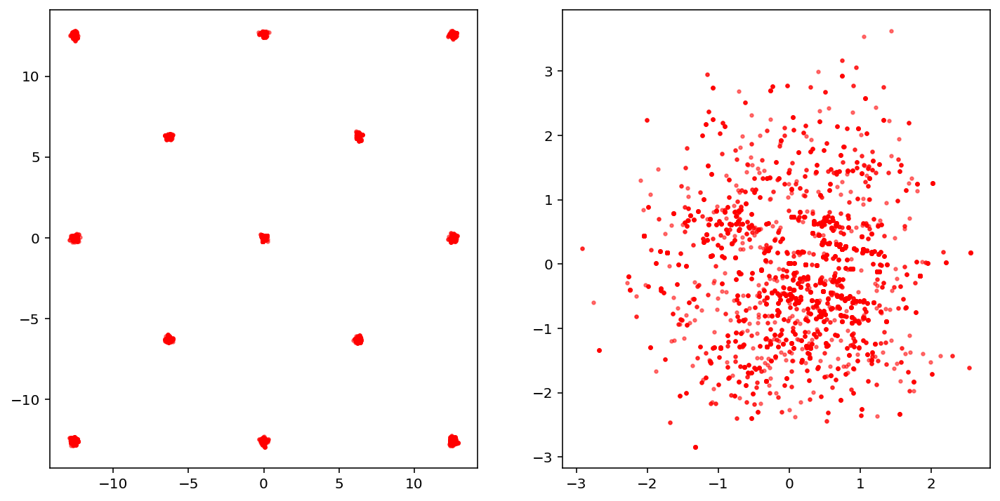

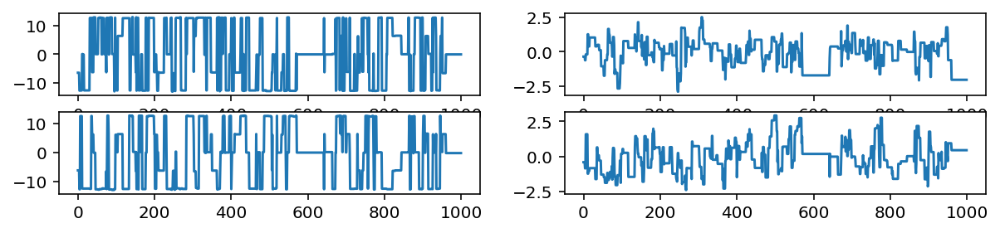

Removed no burn in
515.1806877672794
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.32E+00            9.32             537
param2           1.20E+01           12.04             415


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1242  p_{1}
param2        0.0830  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00686
  2      0.01543

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0027   0.0025   0.0029 upper
param1       0.0000   0.0018   0.0017 lower
param2       0.0002   0.0019   0.0020 upper
param2       0.0015   0.0023   0.0026 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

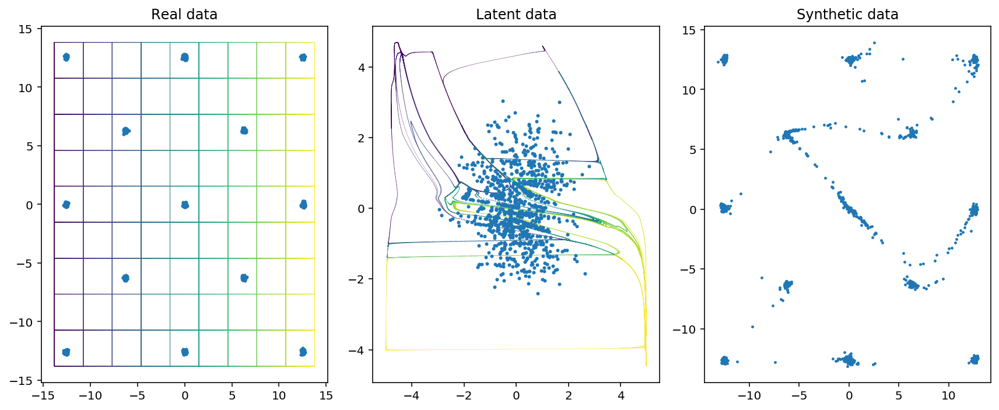

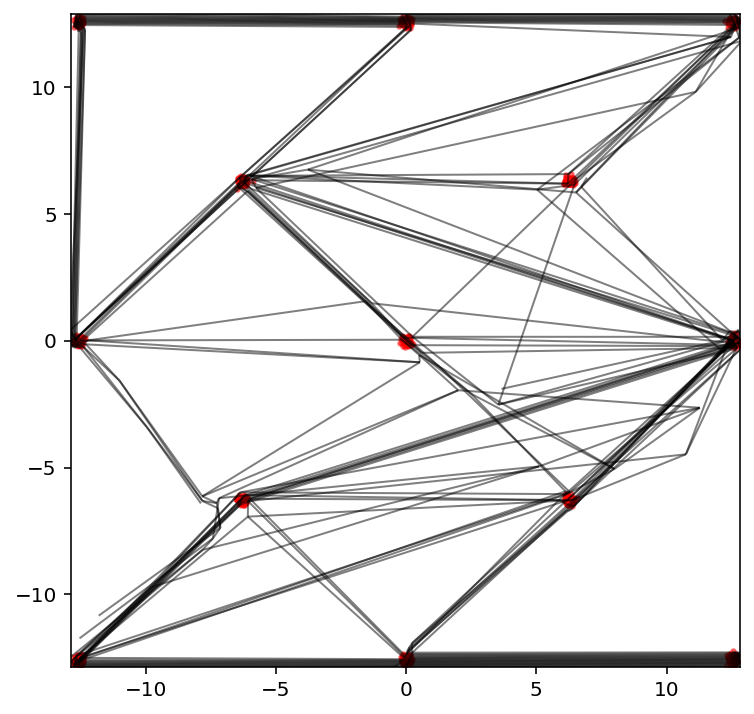

Creating directory for new run logs/test/run398
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


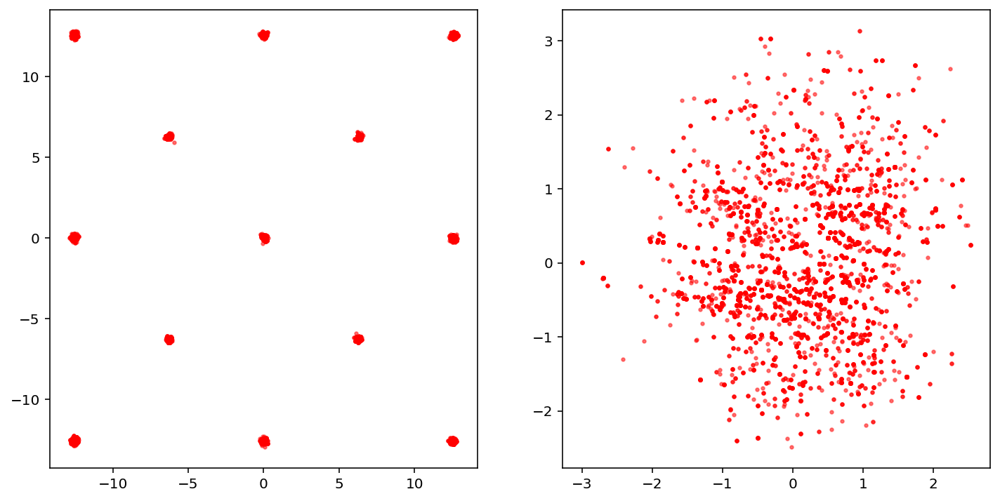

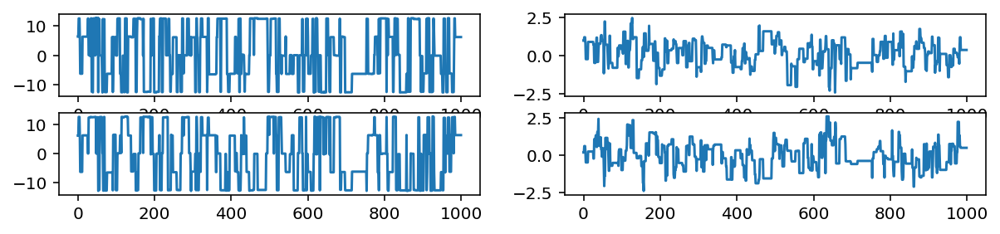

Removed no burn in
620.7532601548726
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.81E+00            7.81             640
param2           1.24E+01           12.44             402


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1145  p_{1}
param2        0.0860  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00699
  2      0.01367

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0010   0.0013   0.0035 upper
param1       0.0008   0.0014   0.0032 lower
param2       0.0002   0.0022   0.0019 upper
param2       0.0013   0.0012   0.0015 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

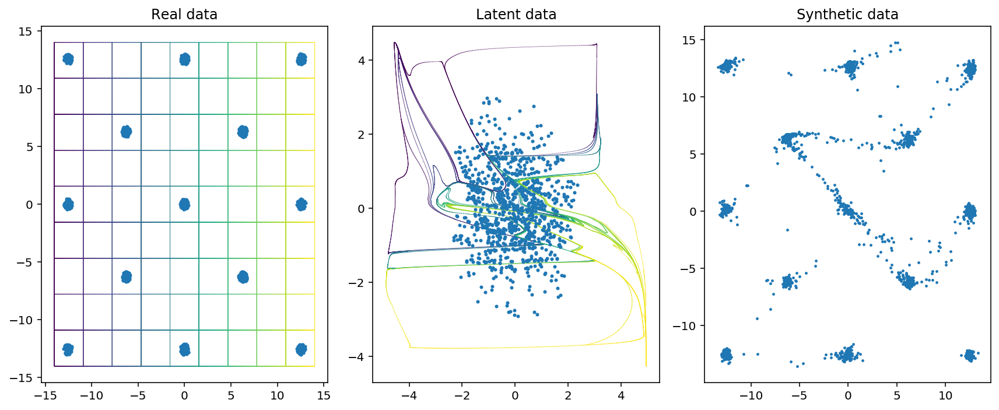

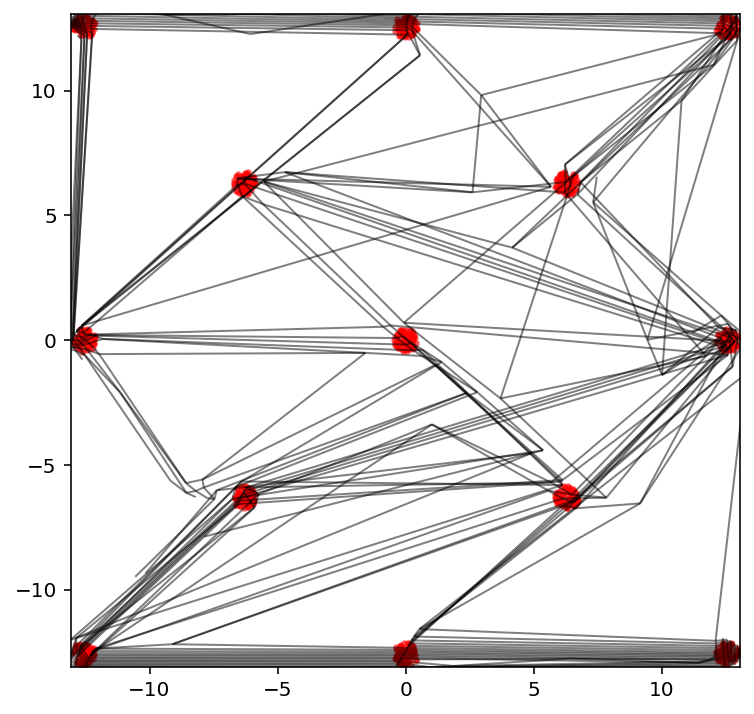

Creating directory for new run logs/test/run399
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


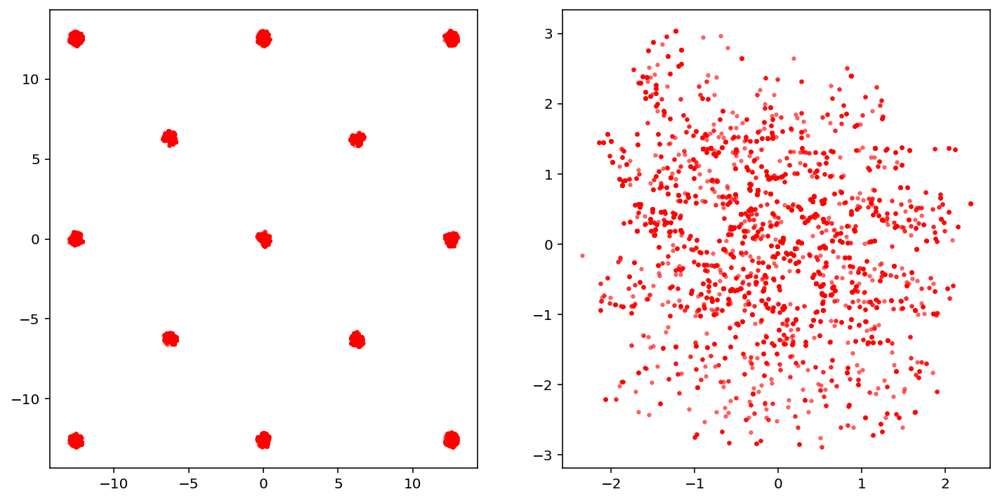

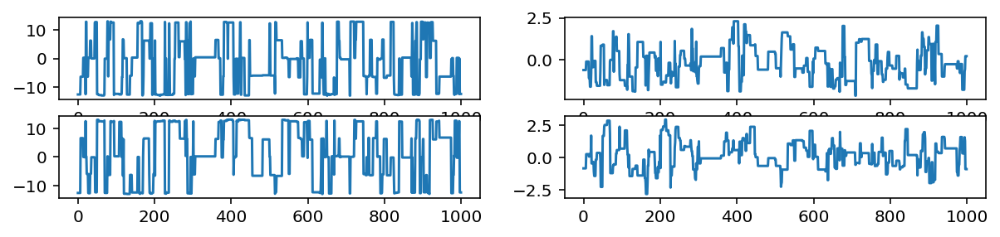

Removed no burn in
395.75653343850104
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.22E+01           12.17             411
param2           1.40E+01           13.98             357


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0925  p_{1}
param2        0.1100  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00423
  2      0.01572

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0054   0.0019   0.0075 upper
param1       0.0039   0.0050   0.0043 lower
param2       0.0065   0.0059   0.0067 upper
param2       0.0006   0.0049   0.0013 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

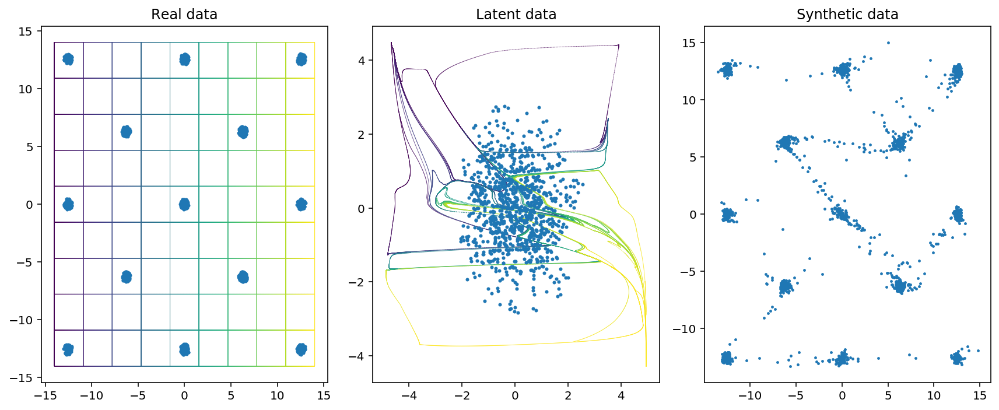

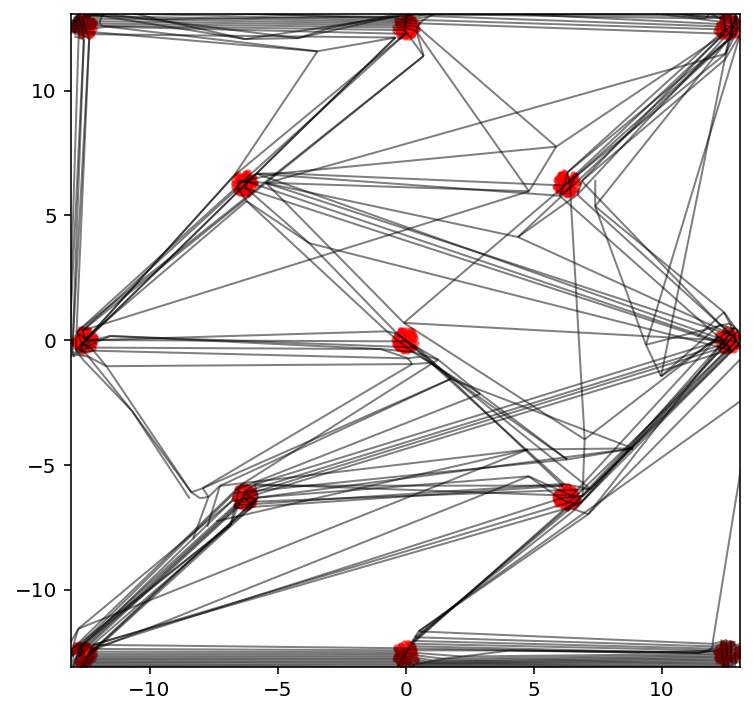

Creating directory for new run logs/test/run400
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


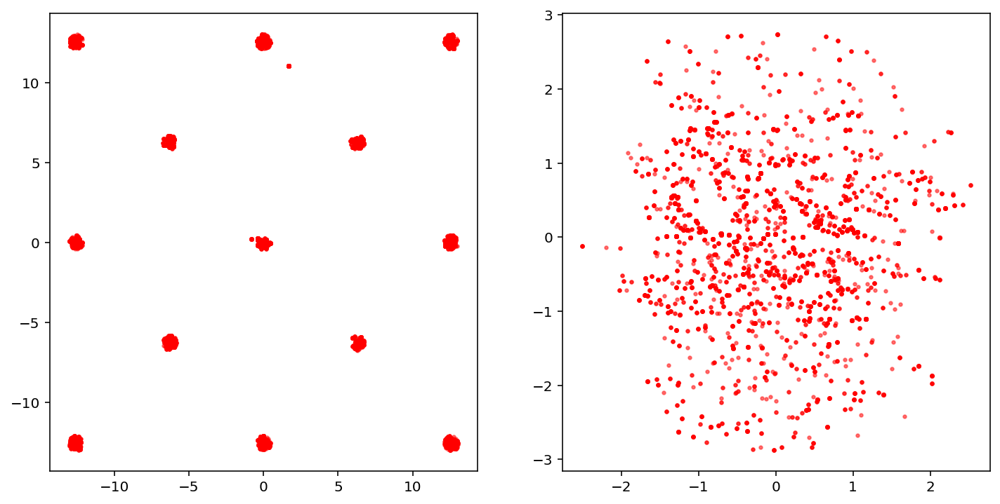

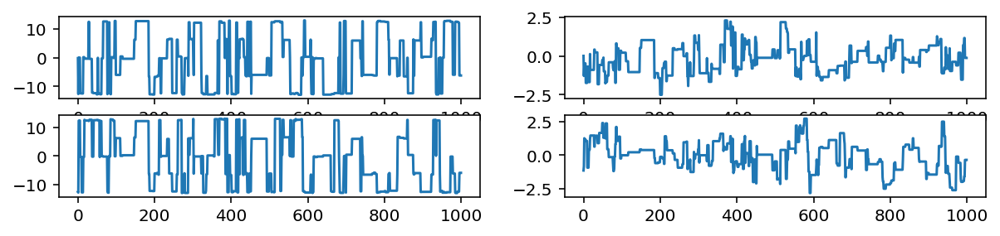

Removed no burn in
386.36266162852087
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.24E+01           12.39             404
param2           1.41E+01           14.08             355


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1334  p_{1}
param2        0.2654  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01053
  2      0.07598

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0013   0.0025   0.0041 upper
param1       0.0070   0.0036   0.0092 lower
param2       0.0009   0.0015   0.0009 upper
param2       0.0012   0.0026   0.0025 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

In [24]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [25]:
prior = UniformPrior(2, [-7, -3], [7, 3])
like = DoubleGaussianShell(2, centers=[[-4.0, 0.0], [4.0, 0.0]])

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.1224] validation loss [0.1174]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0668] validation loss [0.0650]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0524] validation loss [0.0515]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0481] validation loss [0.0476]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0470] validation loss [0.0466]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0467] validation loss [0.0464]
[nnest.trainer] [INFO] Epoch [594] ran out of patience
[nnest.trainer] [INFO] Best epoch [544] validation loss [0.0464]


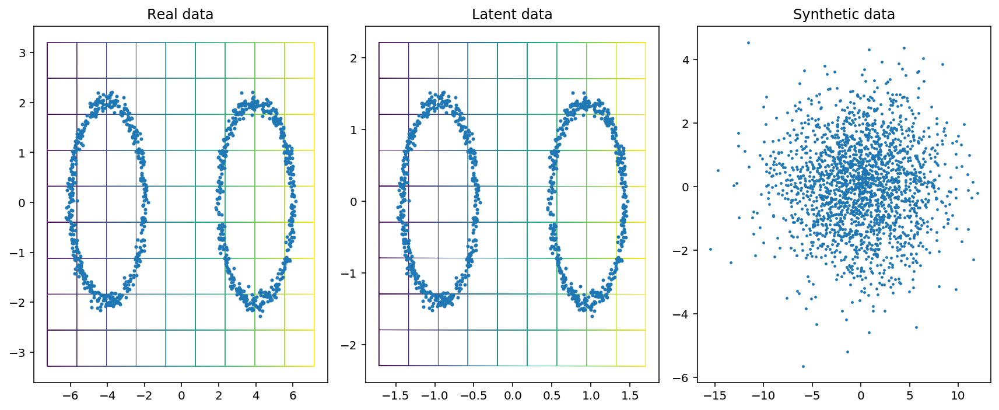

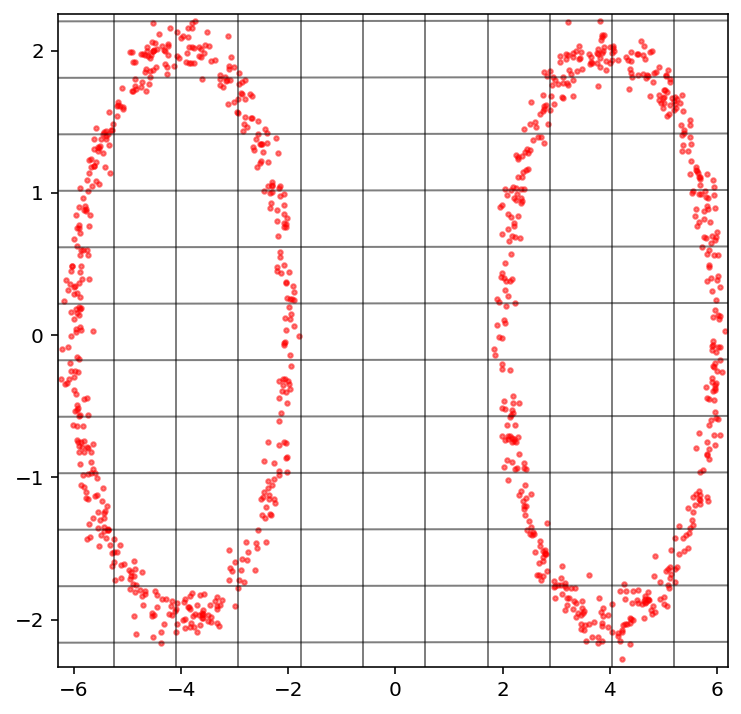

Creating directory for new run logs/test/run402
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


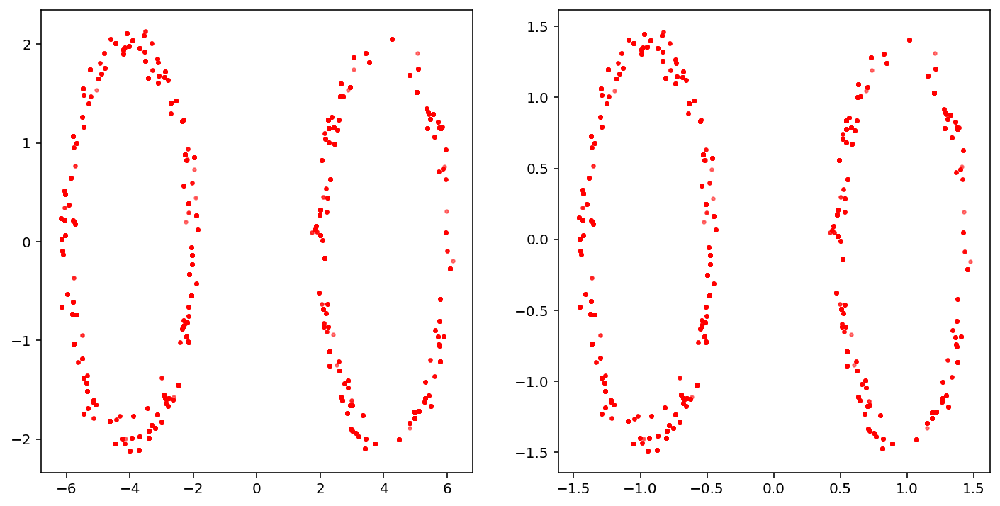

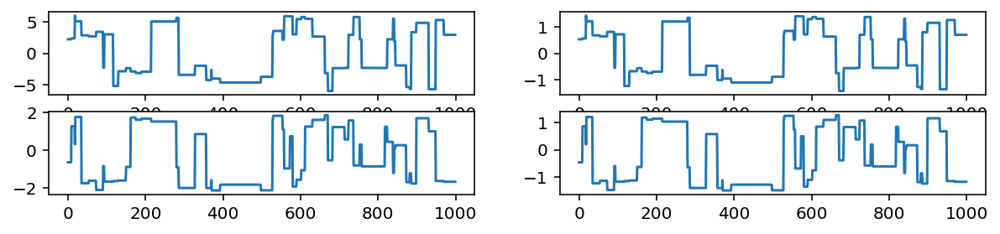

Removed no burn in
97.08495371260535
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           4.67E+01           46.74             107
param2           5.49E+01           54.90              91


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2361  p_{1}
param2        0.3520  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.05014
  2      0.12988

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0120   0.0136   0.0476 upper
param1       0.0117   0.0163   0.0211 lower
param2       0.0335   0.1107   0.0816 upper
param2       0.0466   0.0715   0.1503 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

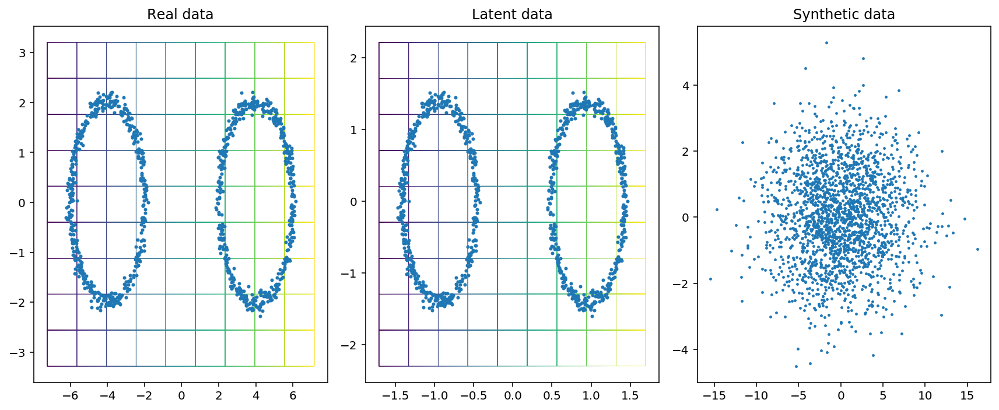

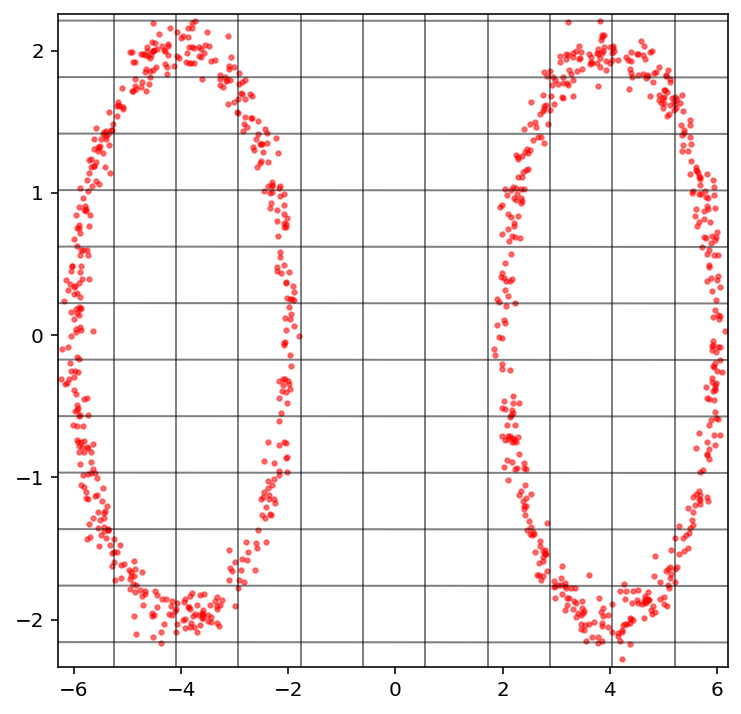

Creating directory for new run logs/test/run403
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:343: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


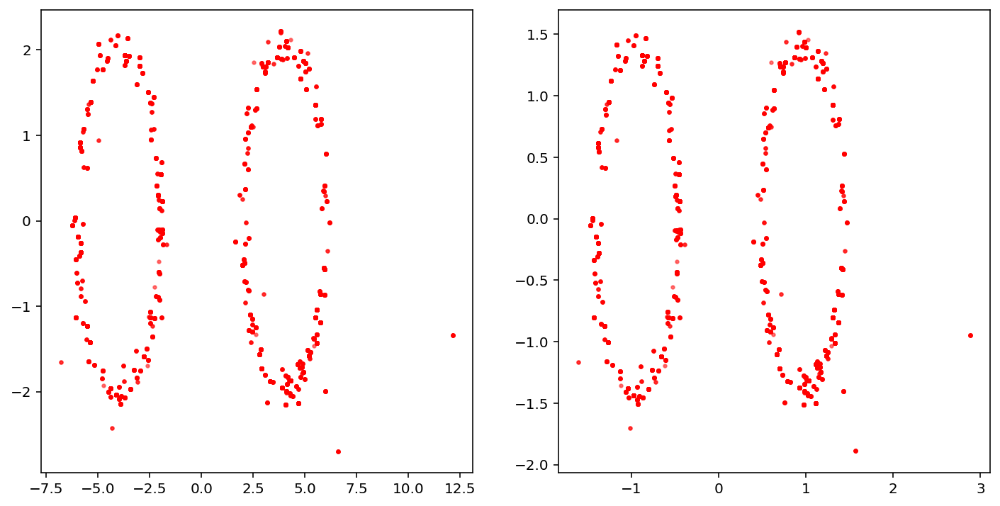

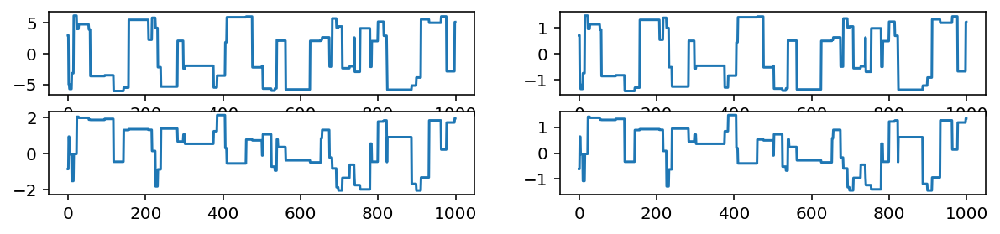

Removed no burn in
105.52186505808498
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           4.66E+01           46.64             107
param2           5.72E+01           57.20              87


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1723  p_{1}
param2        0.3412  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.02858
  2      0.11670

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0035   0.0257   0.0524 upper
param1       0.0335   0.0353   0.0262 lower
param2       0.0405   0.0330   0.0739 upper
param2       0.0190   0.0425   0.0387 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

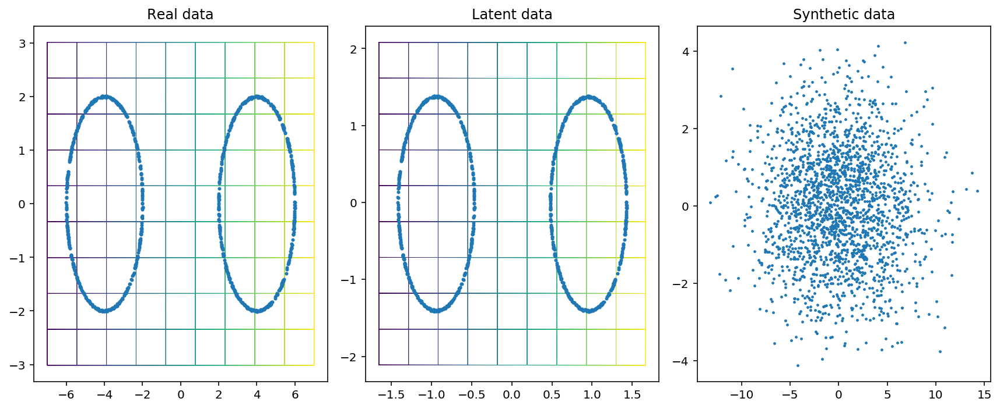

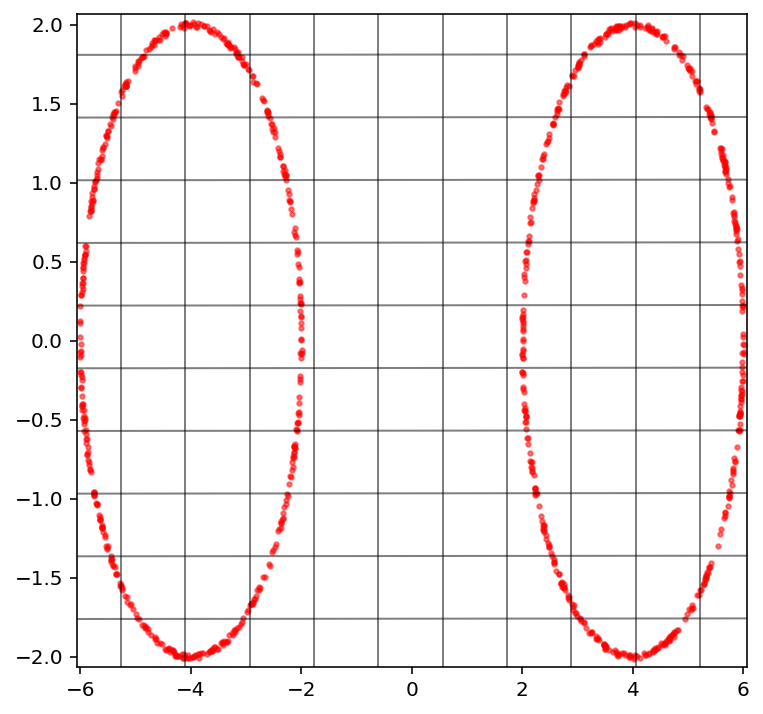

Creating directory for new run logs/test/run405
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


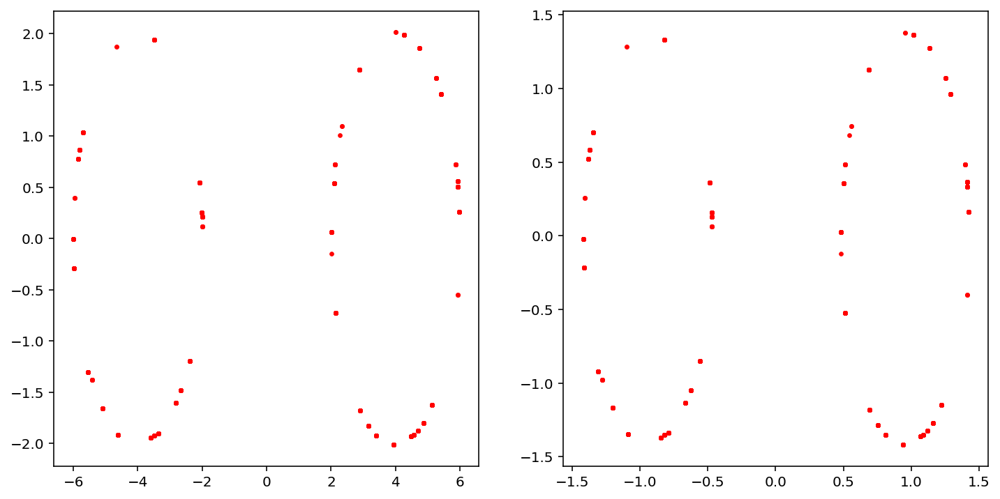

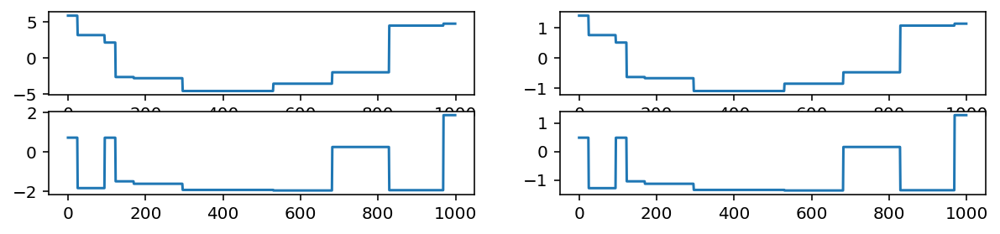

Removed no burn in
21.18725809221841
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.80E-01            0.88            5688
param2           5.28E-01            0.53            9482


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.4130  p_{1}
param2        1.0575  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.16917
  2      1.13265

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0062   0.1344   0.1416 upper
param1       0.0286   0.1777   0.1552 lower
param2       0.6192   0.5283   0.4656 upper
param2       0.0356   0.0306   0.0585 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

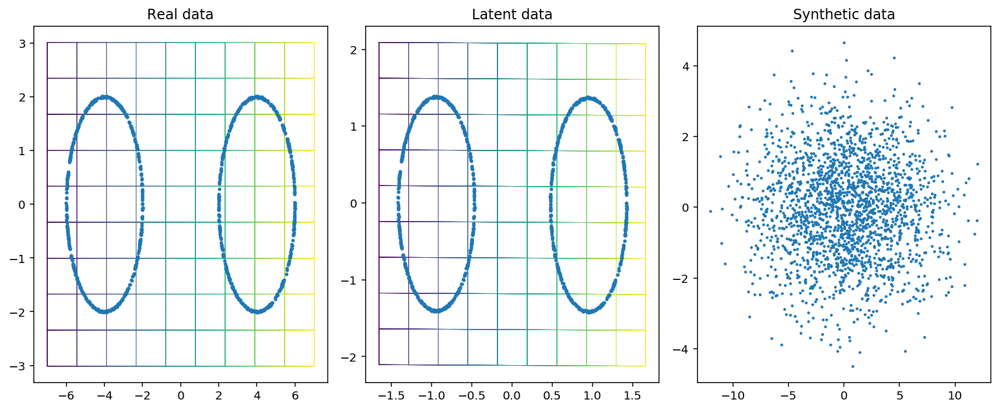

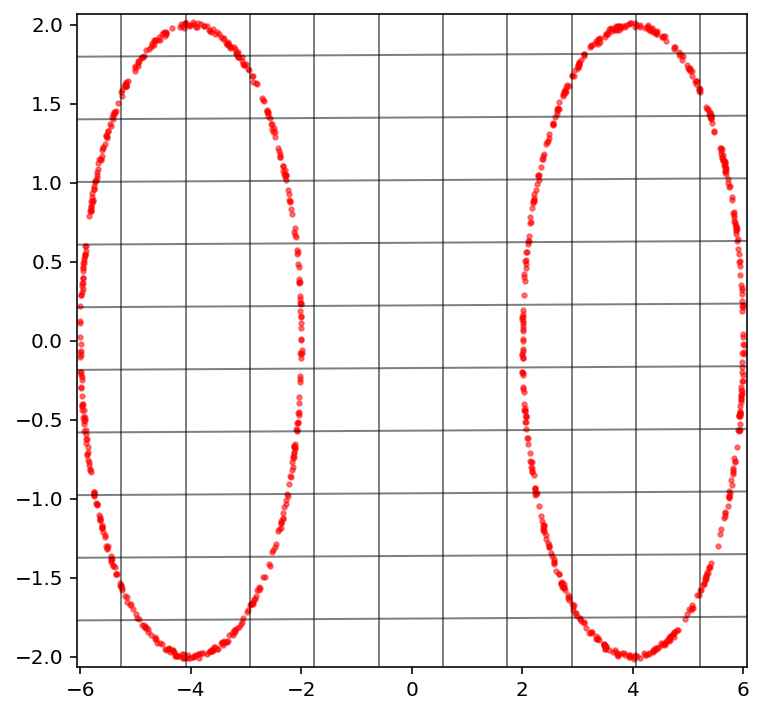

Creating directory for new run logs/test/run406
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


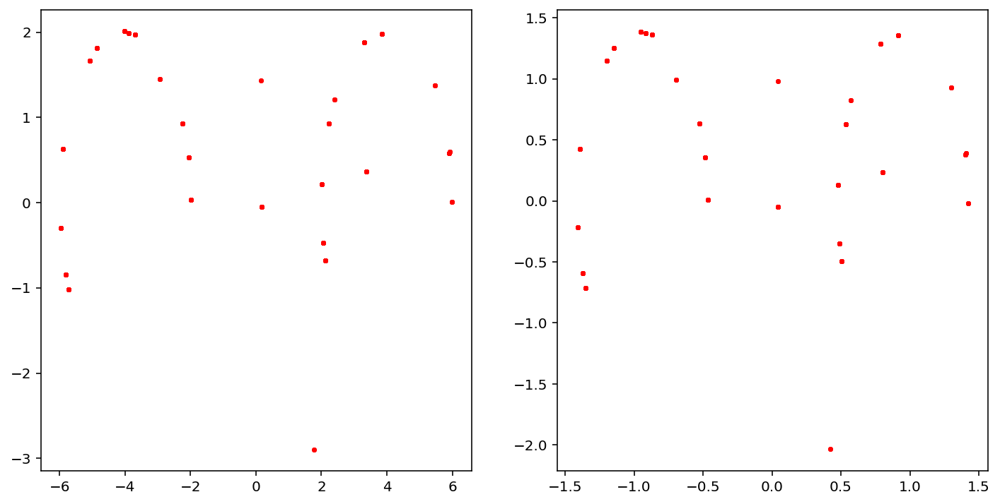

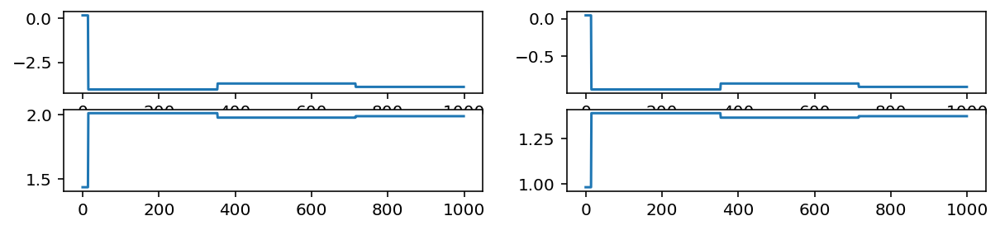

Removed no burn in
14.141358803274251
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.95E-01            0.39           12680
param2           2.16E-01            0.22           23117


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.3845  p_{1}
param2        2.1269  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      1.85677
  2      5.65038

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.3013   0.4268   0.3746 upper
param1       0.1879   0.2752   0.2728 lower
param2       0.2253   0.5789   0.5260 upper
param2       1.2759   1.7195   1.5360 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

In [26]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

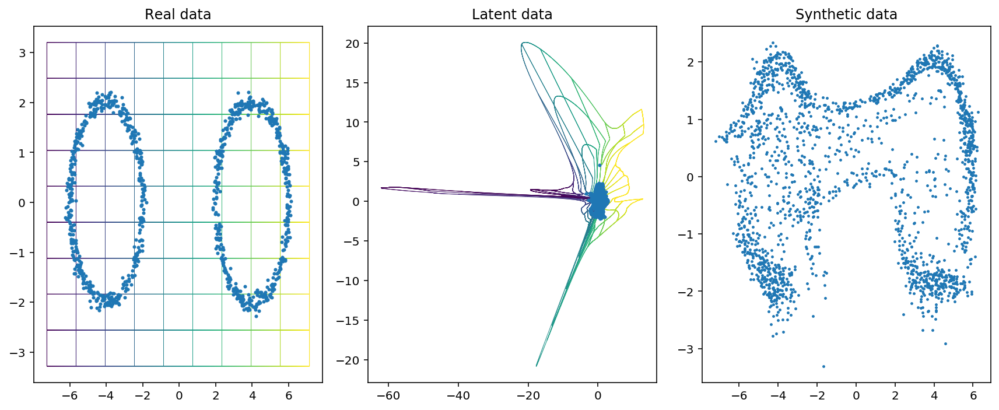

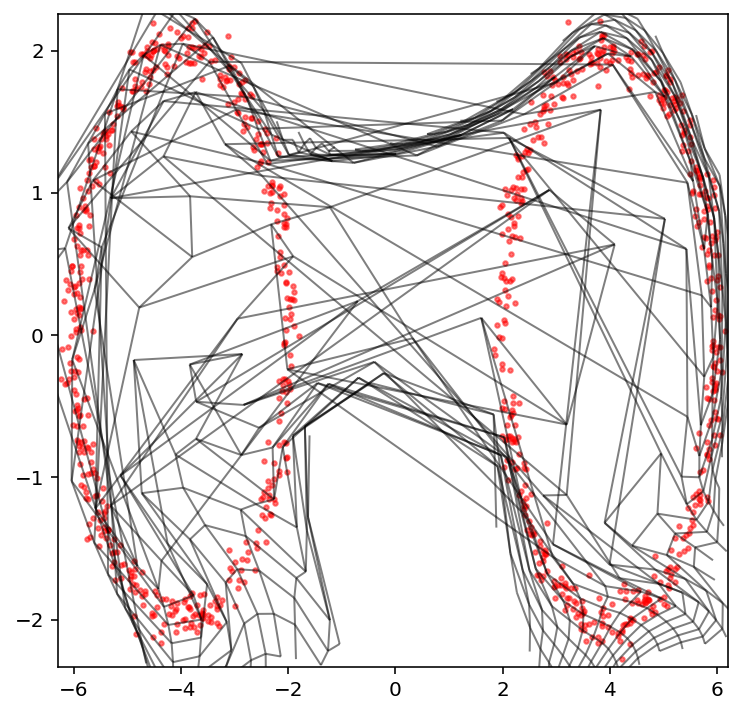

Creating directory for new run logs/test/run407
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


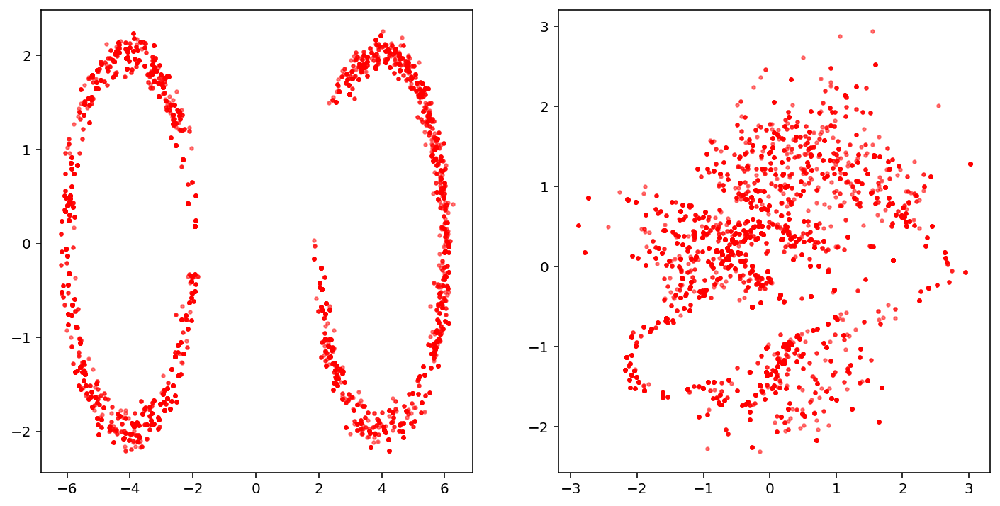

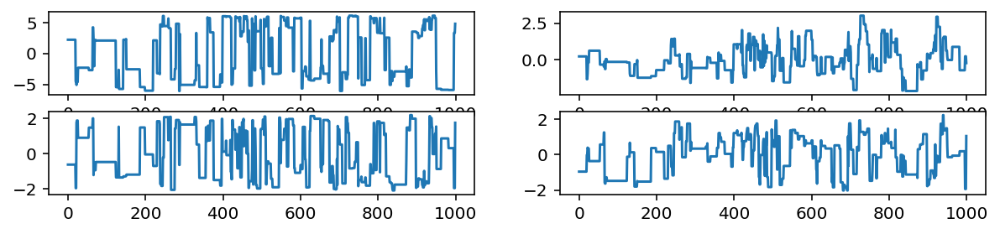

Removed no burn in
358.67994418780955
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.34E+01           13.42             372
param2           1.15E+01           11.47             436


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1001  p_{1}
param2        0.1795  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00996
  2      0.03239

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0014   0.0037   0.0058 upper
param1       0.0044   0.0062   0.0073 lower
param2       0.0090   0.0107   0.0132 upper
param2       0.0025   0.0177   0.0164 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

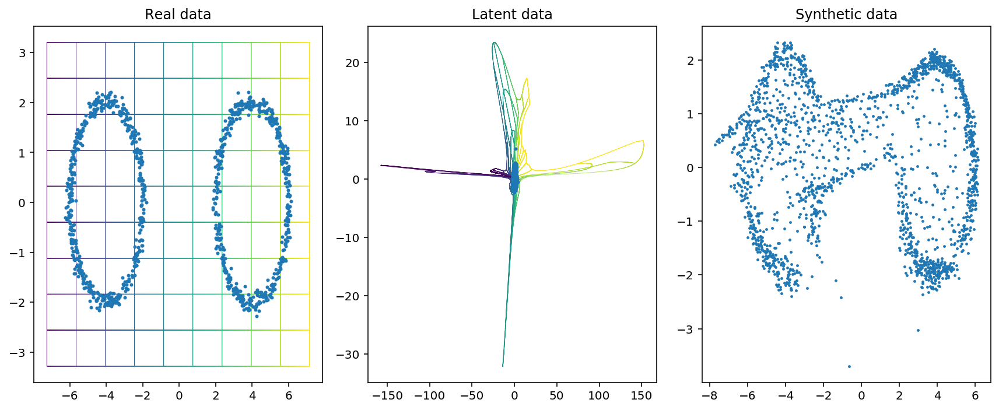

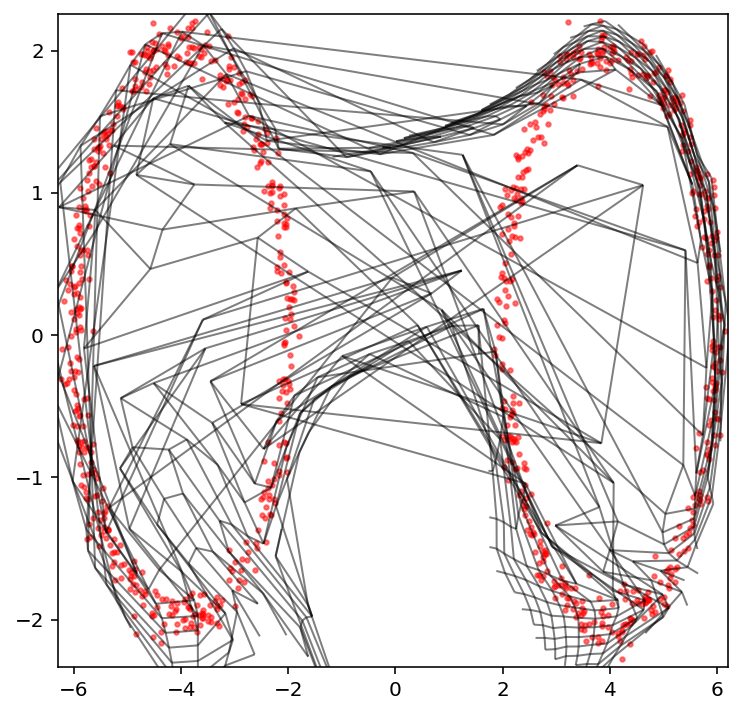

Creating directory for new run logs/test/run408
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


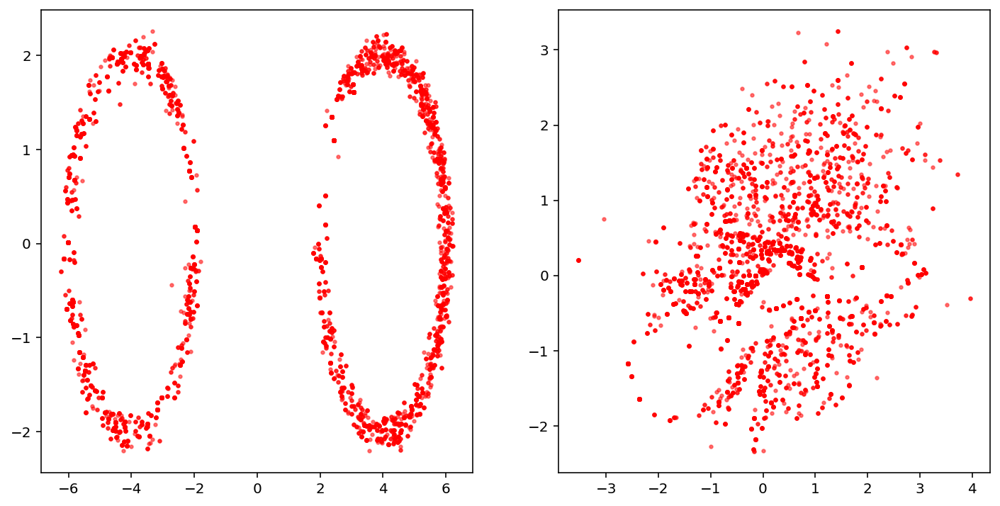

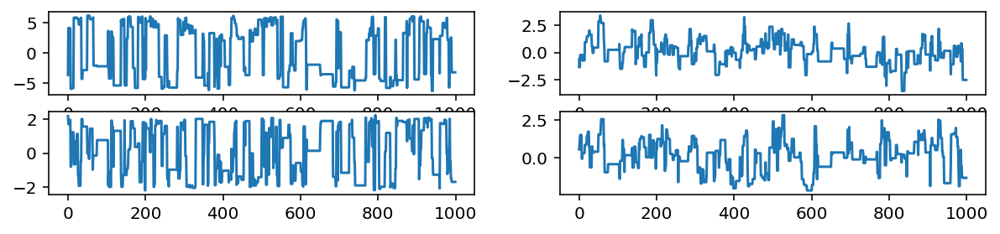

Removed no burn in
324.07255003258905
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.53E+01           15.29             327
param2           1.19E+01           11.91             420


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0829  p_{1}
param2        0.1073  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00014
  2      0.01861

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0058   0.0097   0.0060 upper
param1       0.0041   0.0155   0.0177 lower
param2       0.0167   0.0202   0.0168 upper
param2       0.0114   0.0185   0.0273 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

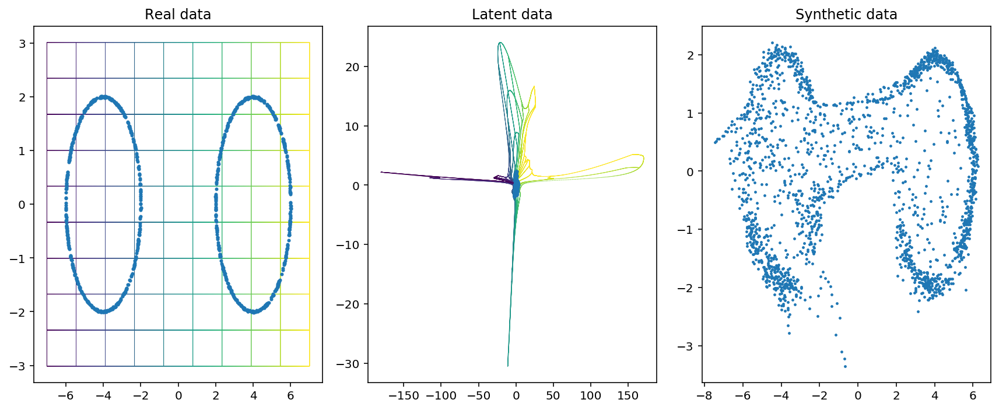

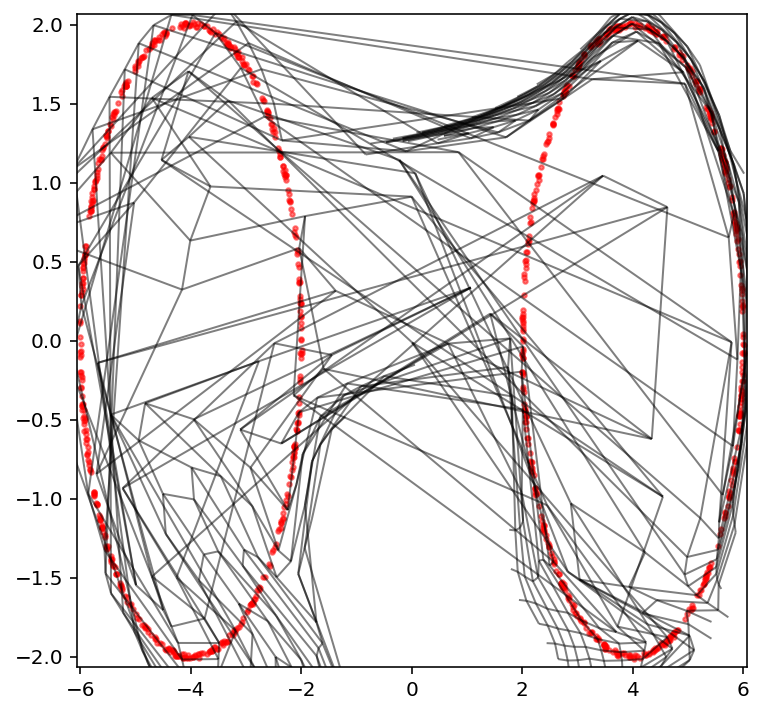

Creating directory for new run logs/test/run409
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


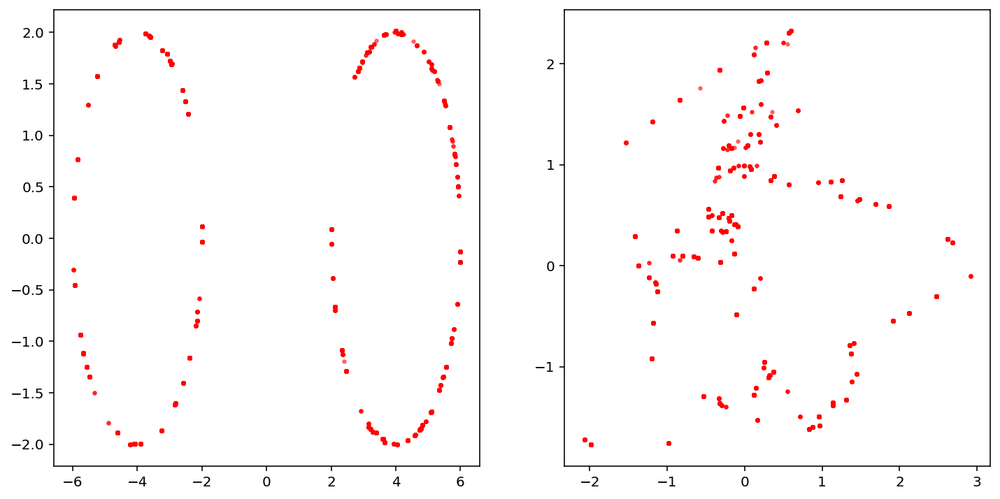

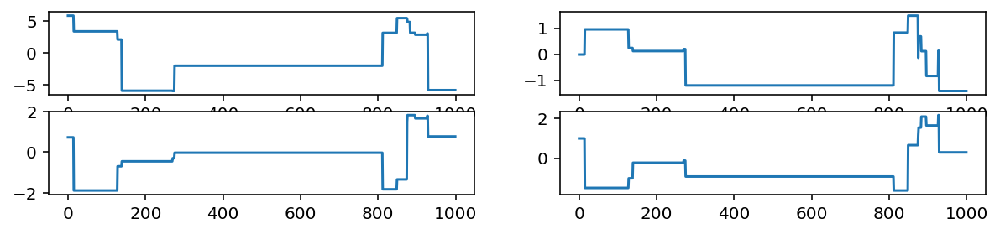

Removed no burn in
38.315118851073734
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.28E+01           62.78              79
param2           6.60E+01           66.02              75


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5405  p_{1}
param2        0.3034  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.05540
  2      0.40963

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0197   0.0615   0.0872 upper
param1       0.0441   0.0230   0.2171 lower
param2       0.0006   0.0306   0.1175 upper
param2       0.0045   0.0037   0.0364 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

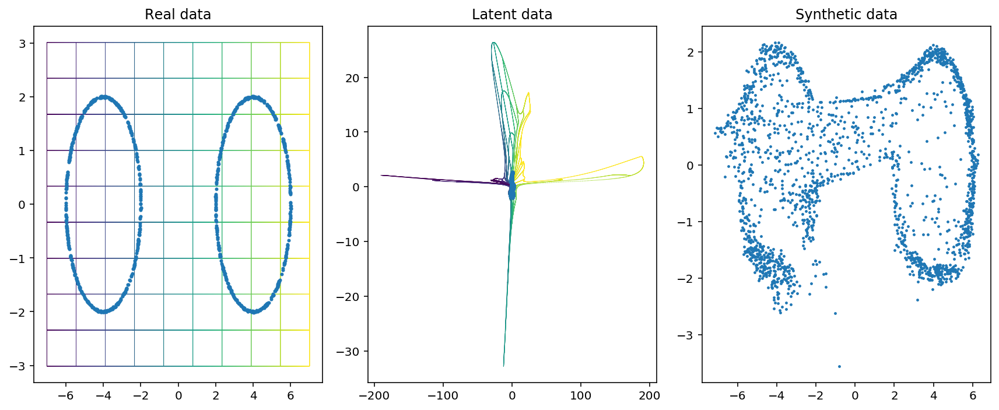

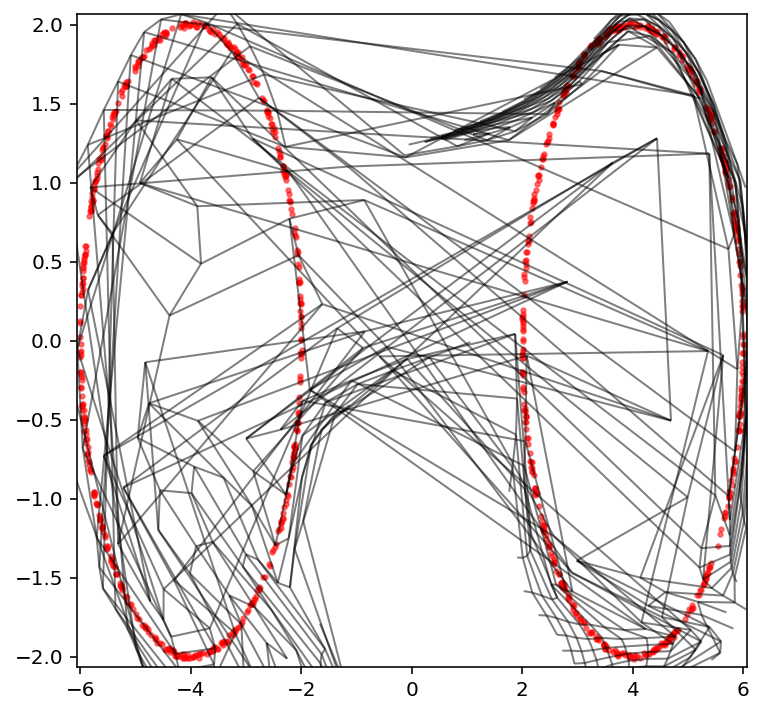

Creating directory for new run logs/test/run410
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


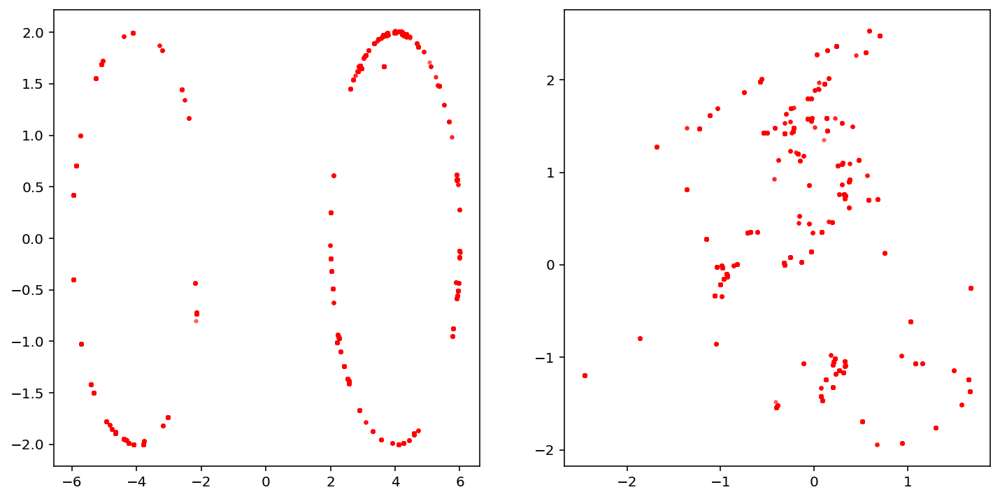

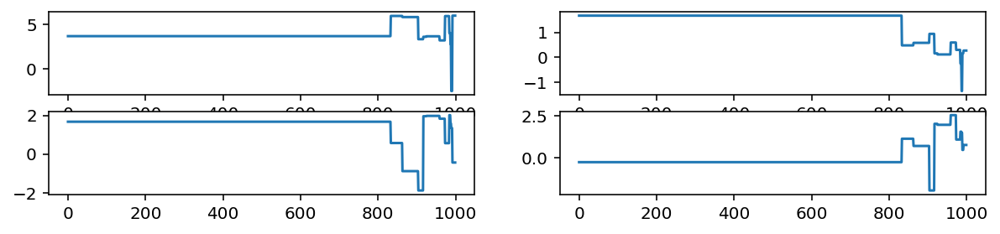

Removed no burn in
40.11024691526719
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.10E-01            0.81            6179
param2           5.95E-01            0.59            8417


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5417  p_{1}
param2        0.9232  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.03046
  2      0.92331

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0093   0.0112   0.1701 upper
param1       0.0000   0.0981   0.0850 lower
param2       0.0128   0.0165   0.0102 upper
param2       0.0010   0.0065   0.0375 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [27]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

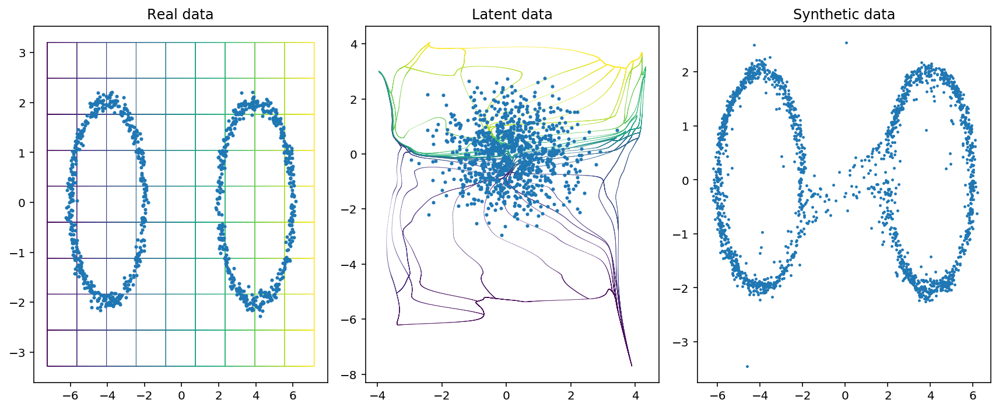

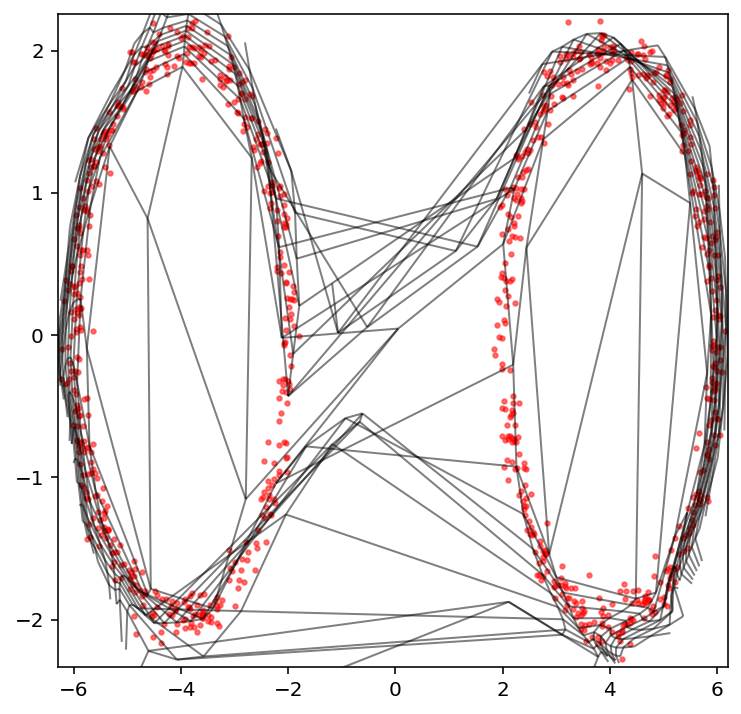

Creating directory for new run logs/test/run411
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


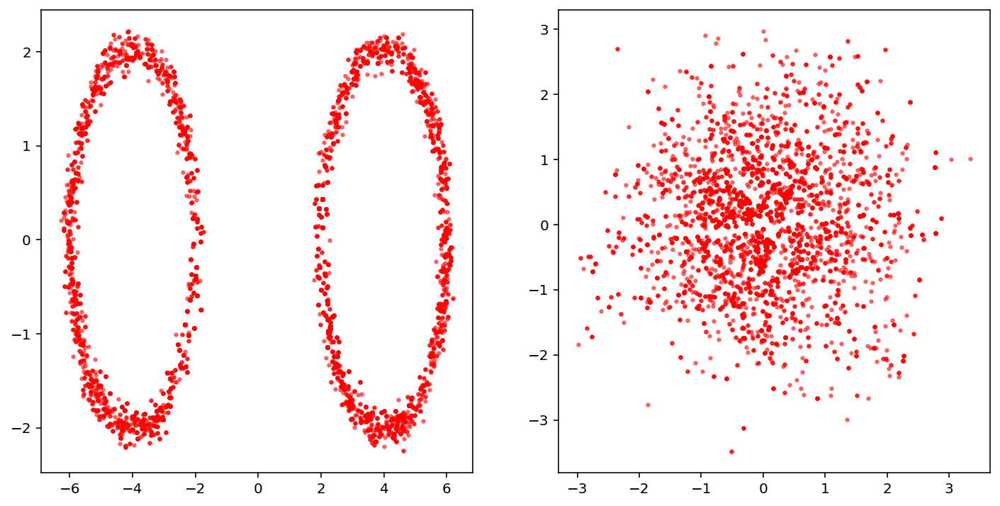

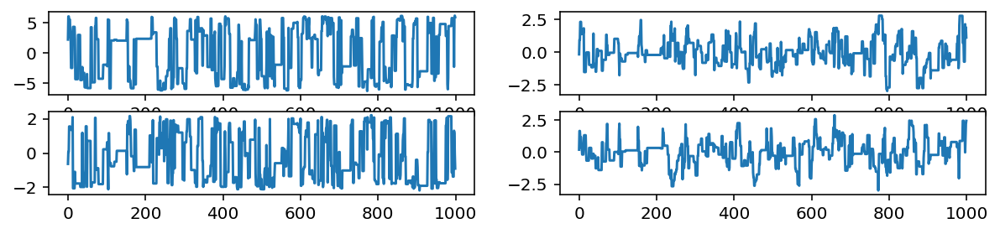

Removed no burn in
692.1577172344831
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.96E+00            6.96             719
param2           7.87E+00            7.87             636


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1372  p_{1}
param2        0.1081  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01152
  2      0.01906

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0020   0.0077   0.0056 upper
param1       0.0061   0.0035   0.0137 lower
param2       0.0168   0.0202   0.0246 upper
param2       0.0110   0.0185   0.0156 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

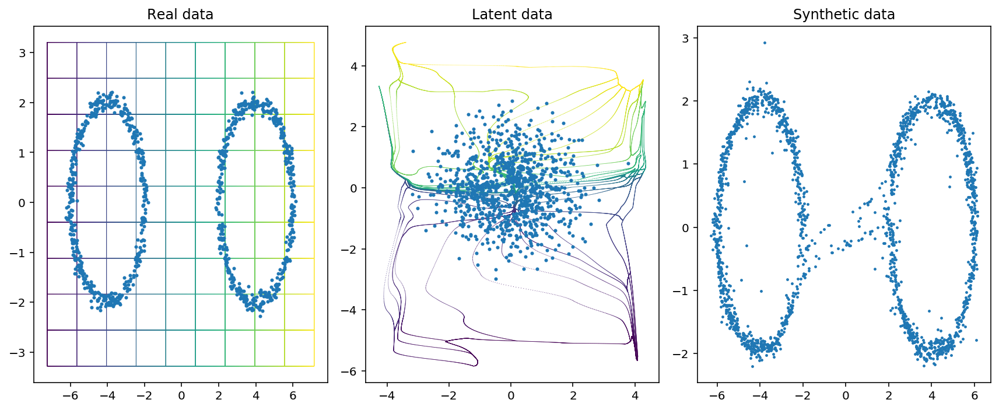

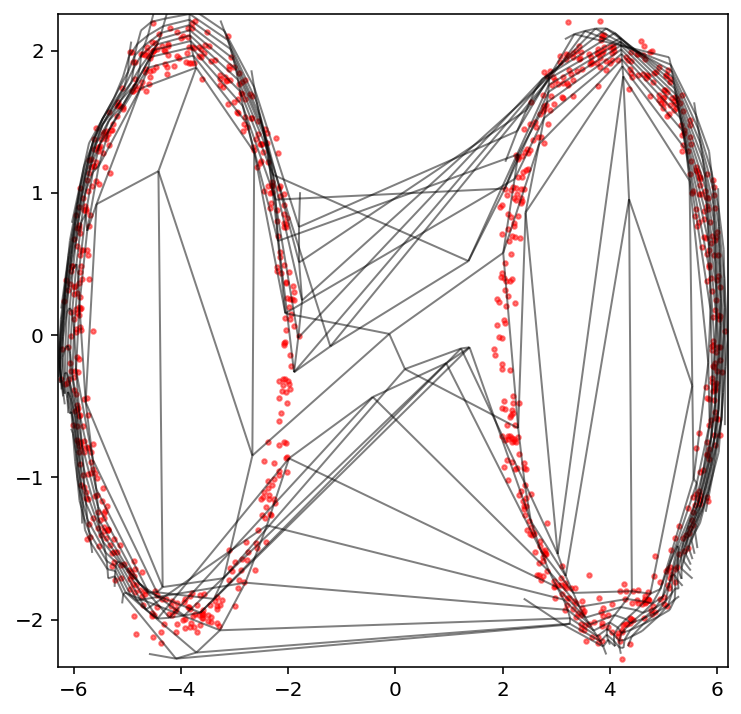

Creating directory for new run logs/test/run412
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


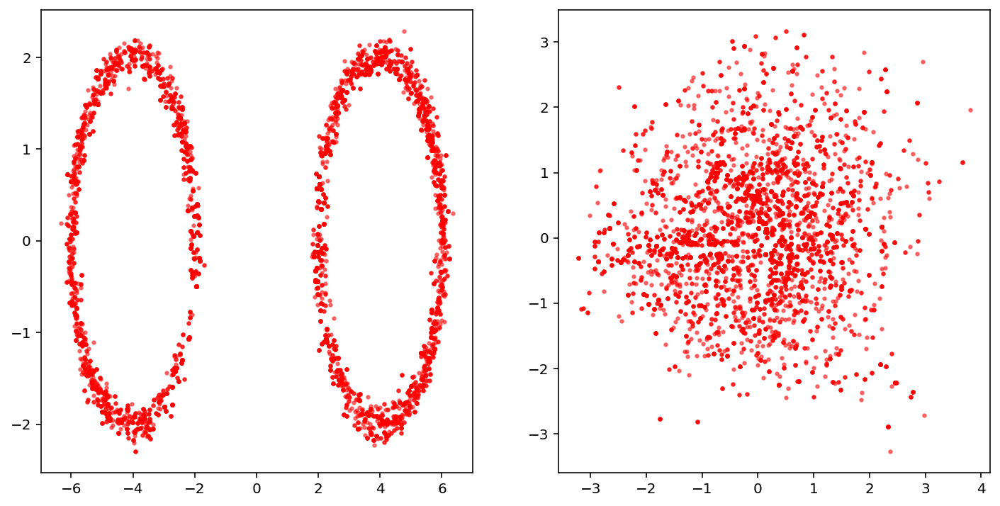

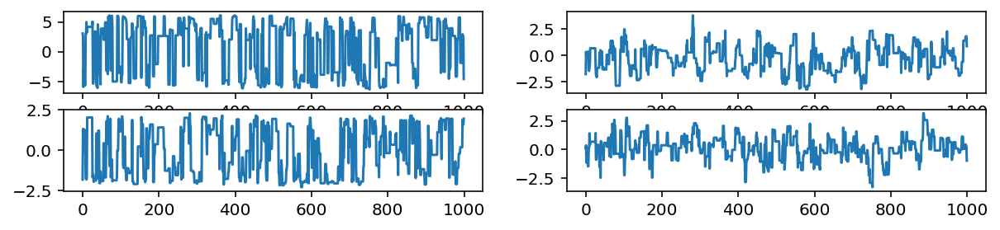

Removed no burn in
614.5313952327961
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.89E+00            7.89             634
param2           8.44E+00            8.44             592


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0854  p_{1}
param2        0.0796  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00157
  2      0.01263

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0070   0.0018   0.0058 upper
param1       0.0003   0.0129   0.0096 lower
param2       0.0044   0.0050   0.0120 upper
param2       0.0226   0.0234   0.0298 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

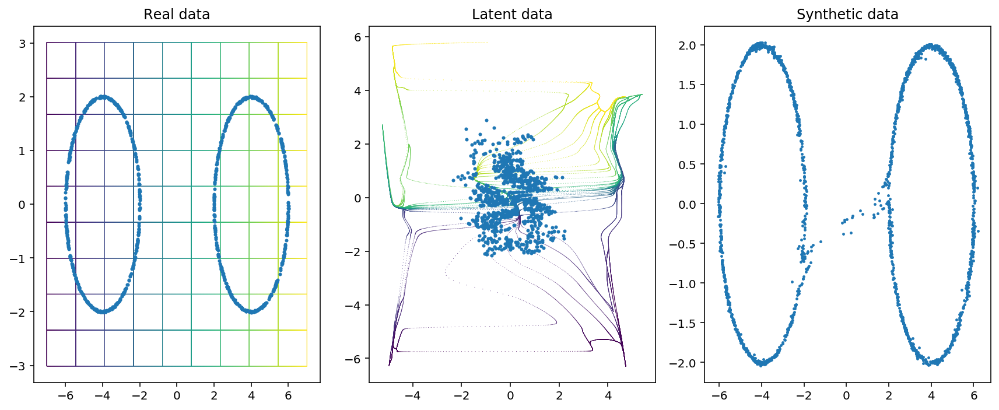

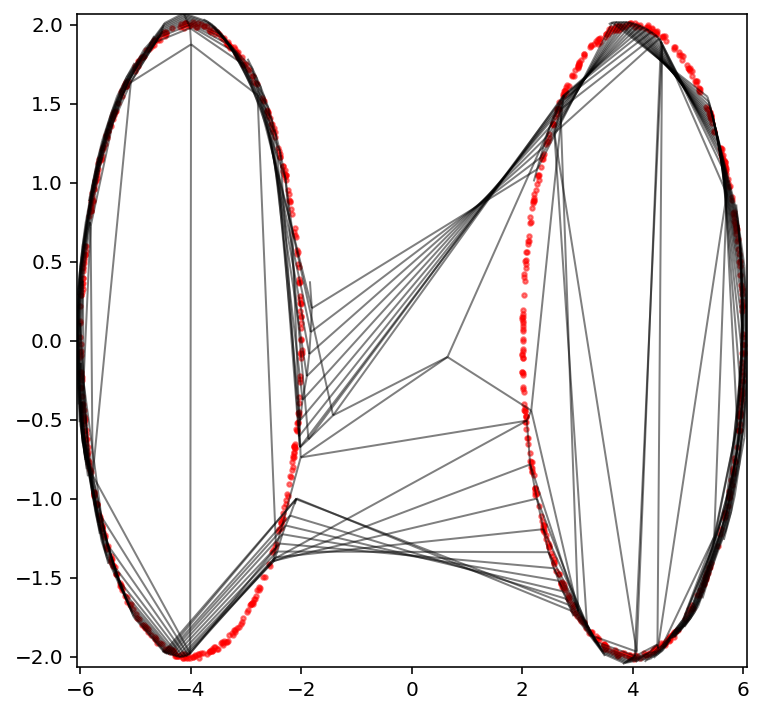

Creating directory for new run logs/test/run413
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


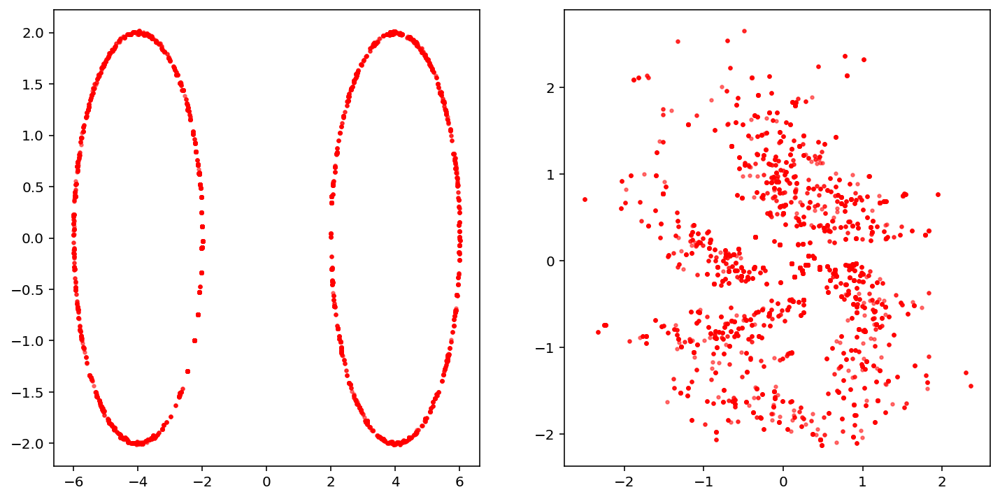

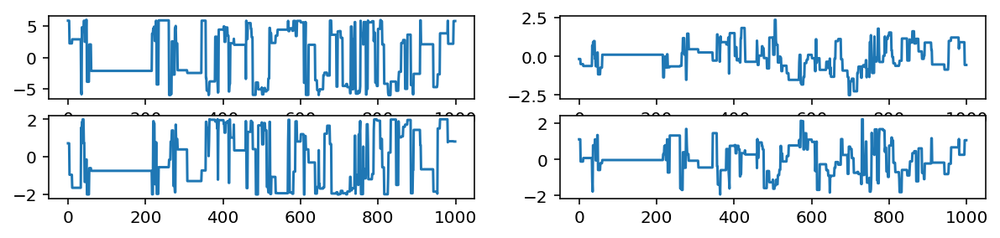

Removed no burn in
314.0495331573995
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.41E+01           14.12             354
param2           1.61E+01           16.06             311


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1721  p_{1}
param2        0.2055  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.02311
  2      0.04783

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0090   0.0146   0.0076 upper
param1       0.0033   0.0034   0.0118 lower
param2       0.0029   0.0055   0.0121 upper
param2       0.0019   0.0022   0.0092 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

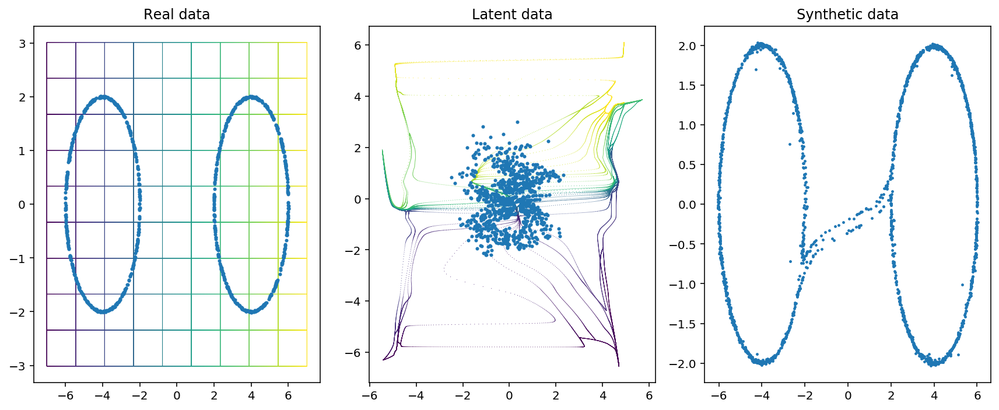

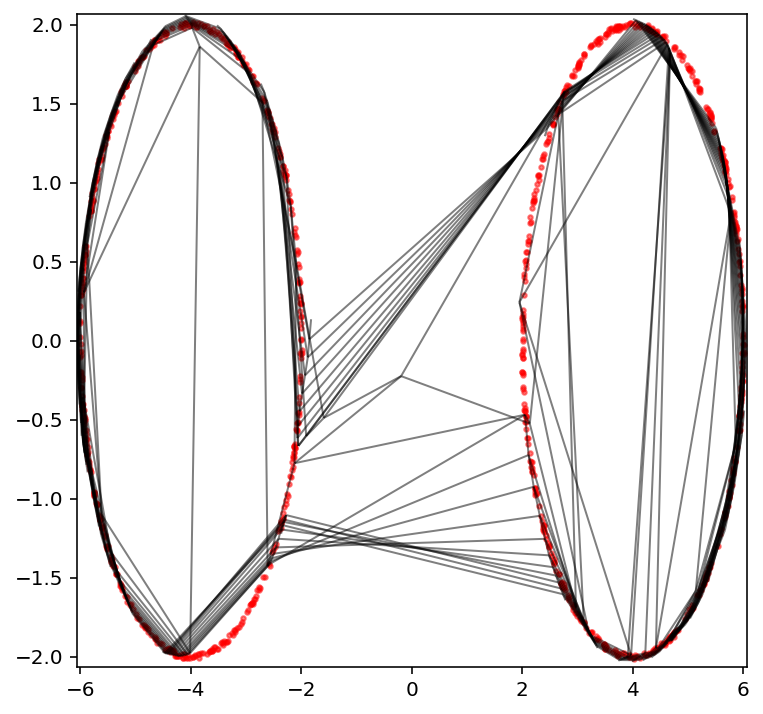

Creating directory for new run logs/test/run414
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


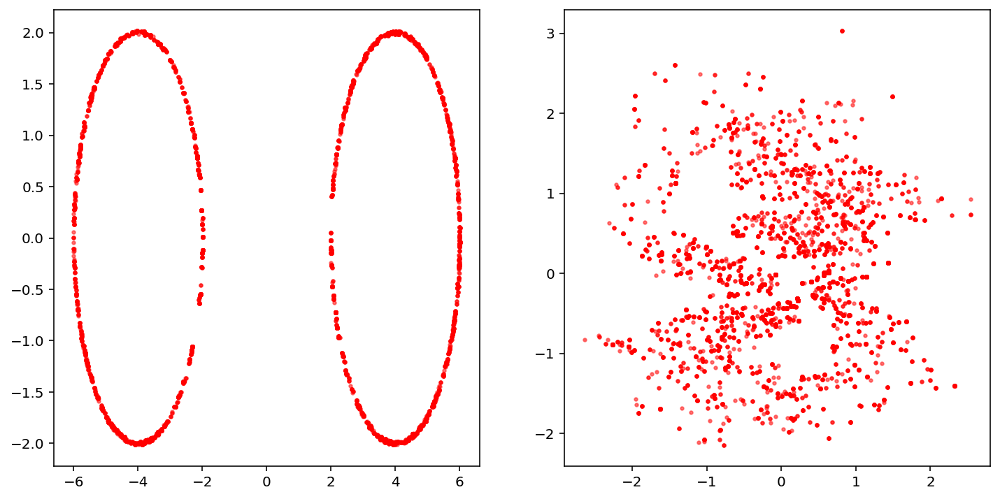

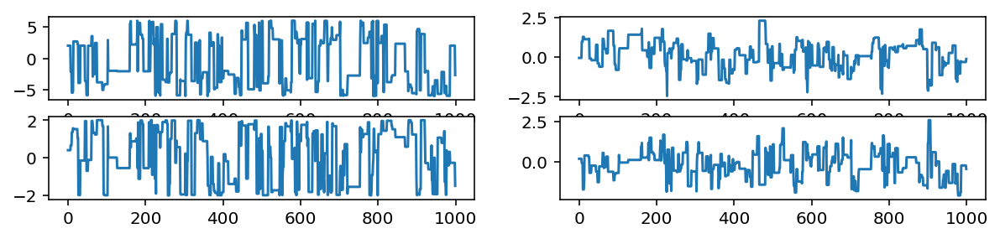

Removed no burn in
319.6142456858228
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.23E+01           12.32             406
param2           1.25E+01           12.49             400


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1733  p_{1}
param2        0.1191  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01132
  2      0.03361

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0006   0.0014   0.0022 upper
param1       0.0055   0.0092   0.0199 lower
param2       0.0026   0.0088   0.0087 upper
param2       0.0006   0.0020   0.0035 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [28]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)